In [41]:
import geoplot as gplt
import geopandas as gpd
import geoplot.crs as gcrs
import imageio
import pandas as pd
import pathlib
import matplotlib.pyplot as plt
import mapclassify as mc
import numpy as np
import base64
from folium.plugins import MarkerCluster, HeatMap
from scipy import stats

In [42]:
%matplotlib inline

In [43]:
raw_data = gpd.read_file('wdl_data/m_risk_prfile.shp')

In [44]:
raw_data.head()

,Link_ID,linkid,Daily_Aver,Average_Ve,Median_of_,First_Quar,Third_Quar,Func_Class,Speed_Cat,geometry
0,80216819,80216819,6224.778569,45.208716,44.464286,28.000000,59.00,2,6,"LINESTRING (-9.16402 38.77030, -9.16389 38.770..."
1,80216858,80216858,2236.054168,79.563308,82.750000,71.750000,93.25,2,4,"LINESTRING (-9.16645 38.74274, -9.16638 38.742..."
2,80216859,80216859,2138.725039,65.955069,67.333333,61.000000,75.00,3,6,"LINESTRING (-9.16645 38.74274, -9.16637 38.742..."
3,80216860,80216860,2201.335041,47.533911,44.000000,26.900000,74.00,3,6,"LINESTRING (-9.16588 38.74370, -9.16568 38.744..."
4,80216867,80216867,2102.610278,51.375291,53.250000,45.333333,59.00,3,6,"LINESTRING (-9.16472 38.74478, -9.16487 38.744..."


In [45]:
# we can see two column names with Link ID

In [46]:
raw_data['Link_ID'].equals(raw_data['linkid'])

True

In [47]:
raw_data.drop(columns='linkid', inplace=True)

In [48]:
raw_data['Link_ID'].nunique()

34678

In [49]:
#each link ID represents a road segment 
#the dataframe represents the characteristics of traffic on the numerous road segments

In [50]:
#! pip install display

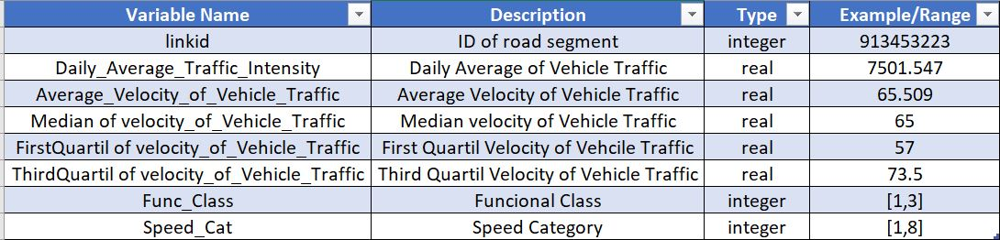

In [51]:
#important variable dictionary
from IPython import display
from base64 import b64decode
base64_data = '/9j/4AAQSkZJRgABAQEAkACQAAD/4RDcRXhpZgAATU0AKgAAAAgABAE7AAIAAAAGAAAISodpAAQAAAABAAAIUJydAAEAAAAMAAAQyOocAAcAAAgMAAAAPgAAAAAc6gAAAAgAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAGFkbWluAAAFkAMAAgAAABQAABCekAQAAgAAABQAABCykpEAAgAAAAM3OQAAkpIAAgAAAAM3OQAA6hwABwAACAwAAAiSAAAAABzqAAAACAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAMjAyMTowNDoyMCAxMjoxNToyNgAyMDIxOjA0OjIwIDEyOjE1OjI2AAAAYQBkAG0AaQBuAAAA/+ELGGh0dHA6Ly9ucy5hZG9iZS5jb20veGFwLzEuMC8APD94cGFja2V0IGJlZ2luPSfvu78nIGlkPSdXNU0wTXBDZWhpSHpyZVN6TlRjemtjOWQnPz4NCjx4OnhtcG1ldGEgeG1sbnM6eD0iYWRvYmU6bnM6bWV0YS8iPjxyZGY6UkRGIHhtbG5zOnJkZj0iaHR0cDovL3d3dy53My5vcmcvMTk5OS8wMi8yMi1yZGYtc3ludGF4LW5zIyI+PHJkZjpEZXNjcmlwdGlvbiByZGY6YWJvdXQ9InV1aWQ6ZmFmNWJkZDUtYmEzZC0xMWRhLWFkMzEtZDMzZDc1MTgyZjFiIiB4bWxuczpkYz0iaHR0cDovL3B1cmwub3JnL2RjL2VsZW1lbnRzLzEuMS8iLz48cmRmOkRlc2NyaXB0aW9uIHJkZjphYm91dD0idXVpZDpmYWY1YmRkNS1iYTNkLTExZGEtYWQzMS1kMzNkNzUxODJmMWIiIHhtbG5zOnhtcD0iaHR0cDovL25zLmFkb2JlLmNvbS94YXAvMS4wLyI+PHhtcDpDcmVhdGVEYXRlPjIwMjEtMDQtMjBUMTI6MTU6MjYuNzkwPC94bXA6Q3JlYXRlRGF0ZT48L3JkZjpEZXNjcmlwdGlvbj48cmRmOkRlc2NyaXB0aW9uIHJkZjphYm91dD0idXVpZDpmYWY1YmRkNS1iYTNkLTExZGEtYWQzMS1kMzNkNzUxODJmMWIiIHhtbG5zOmRjPSJodHRwOi8vcHVybC5vcmcvZGMvZWxlbWVudHMvMS4xLyI+PGRjOmNyZWF0b3I+PHJkZjpTZXEgeG1sbnM6cmRmPSJodHRwOi8vd3d3LnczLm9yZy8xOTk5LzAyLzIyLXJkZi1zeW50YXgtbnMjIj48cmRmOmxpPmFkbWluPC9yZGY6bGk+PC9yZGY6U2VxPg0KCQkJPC9kYzpjcmVhdG9yPjwvcmRmOkRlc2NyaXB0aW9uPjwvcmRmOlJERj48L3g6eG1wbWV0YT4NCiAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAKICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgIAogICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgCiAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAKICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgIAogICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgCiAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAKICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgIAogICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgCiAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAKICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgIAogICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgCiAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAKICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgIAogICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgCiAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAKICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgIAogICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgCiAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAKICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgICAgIAogICAgICAgICAgICAgICAgICAgICAgICAgICAgPD94cGFja2V0IGVuZD0ndyc/Pv/bAEMABwUFBgUEBwYFBggHBwgKEQsKCQkKFQ8QDBEYFRoZGBUYFxseJyEbHSUdFxgiLiIlKCkrLCsaIC8zLyoyJyorKv/bAEMBBwgICgkKFAsLFCocGBwqKioqKioqKioqKioqKioqKioqKioqKioqKioqKioqKioqKioqKioqKioqKioqKioqKv/AABEIAQYEQgMBIgACEQEDEQH/xAAfAAABBQEBAQEBAQAAAAAAAAAAAQIDBAUGBwgJCgv/xAC1EAACAQMDAgQDBQUEBAAAAX0BAgMABBEFEiExQQYTUWEHInEUMoGRoQgjQrHBFVLR8CQzYnKCCQoWFxgZGiUmJygpKjQ1Njc4OTpDREVGR0hJSlNUVVZXWFlaY2RlZmdoaWpzdHV2d3h5eoOEhYaHiImKkpOUlZaXmJmaoqOkpaanqKmqsrO0tba3uLm6wsPExcbHyMnK0tPU1dbX2Nna4eLj5OXm5+jp6vHy8/T19vf4+fr/xAAfAQADAQEBAQEBAQEBAAAAAAAAAQIDBAUGBwgJCgv/xAC1EQACAQIEBAMEBwUEBAABAncAAQIDEQQFITEGEkFRB2FxEyIygQgUQpGhscEJIzNS8BVictEKFiQ04SXxFxgZGiYnKCkqNTY3ODk6Q0RFRkdISUpTVFVWV1hZWmNkZWZnaGlqc3R1dnd4eXqCg4SFhoeIiYqSk5SVlpeYmZqio6Slpqeoqaqys7S1tre4ubrCw8TFxsfIycrS09TV1tfY2dri4+Tl5ufo6ery8/T19vf4+fr/2gAMAwEAAhEDEQA/AOz+JUMdjZ2DWUaWxeRwxhUJu4HXFeffbLn/AJ+Jf++zXonxV/48dO/66P8AyFeaV9Jl0IuhdrqeTipNVNGT/bLn/n4l/wC+zR9suf8An4l/77NQUV6Ps4dkcvPLuT/bLn/n4l/77NH2y5/5+Jf++zUFFHs4dkHPLuT/AGy5/wCfiX/vs0fbLn/n4l/77NQUUezh2Qc8u5P9suf+fiX/AL7NH2y5/wCfiX/vs1BRR7OHZBzy7k/2y5/5+Jf++zR9suf+fiX/AL7NQUUezh2Qc8u5P9suf+fiX/vs0fbLn/n4l/77NQUUezh2Qc8u5P8AbLn/AJ+Jf++zR9suf+fiX/vs1BRR7OHZBzy7k/2y5/5+Jf8Avs0fbLn/AJ+Jf++zUFdvcafZ6r8J4NRs7SGK902fy7l44wrSKe7Ecn7y9fesqns6drx3di4c03ZM4/7Zc/8APxL/AN9mj7Zc/wDPxL/32a6+60y20/4aaZGLSGTVNYud6SMg8xUzgAMeQD8vt8xqo/w91P7NO8F7plzcWyF5rOC6DzIB1yMY4+tZqpQ15klrb7iuWo7W1vqc39suf+fiX/vs0fbLn/n4l/77NbeleCtQ1fRl1SG4soLPzGjeS4m2CLH8TEjGMkDjJ56Vo3ulunw+sUj07TnlfUGgW+hkzLKdzjH3QNvHB3HgDinKdFOySbvYUY1Grt6HJ/bLn/n4l/77NH2y5/5+Jf8Avs10j/D3U/s07wXumXNxbIXms4LoPMgHXIxjj61t6XpUusfCBbeKa3twuoF3muZRHHGuMZJP1H51MqtBK6SeqX3lRhUbs7rf8DgPtlz/AM/Ev/fZo+2XP/PxL/32a7Xw94Zv/DfxE0VL4wyR3BZ4Z4H3JINh6HA9R+dULnwxfa/4o12a3e3trW2u5fOurqTy4ky5wCaftKPNayta9/nYXJUt1vc5n7Zc/wDPxL/32aPtlz/z8S/99mr+veG77w9LCLwwyxXCb4Li3ffHKPUH8RXX/D+30dfC+o3mtWFvcot1HCZJYgxjV8LkE9MFs8U6k6UaftIxv/w9hRU3Plbt/wANc4H7Zc/8/Ev/AH2aPtlz/wA/Ev8A32a7fS/DsWmw+MrO/tYppbG2JgkljBKjDFXUnpkYPFY+meBr7Ura3l/tDTLR7oBreC5utskoPQhQD1pKpQd7pW0/FXG4VFpfv+BgfbLn/n4l/wC+zR9suf8An4l/77NbWneCdX1LUNQsIUhjutPXMsUj4Leynp+ZAq6/w51UW8dzFfaXNaEkSXUd2PKhx13sQPpxmqdTDp2dhKNV9zmPtlz/AM/Ev/fZo+2XP/PxL/32a1tU8H6rperWmnMkd1LeAG2a2fckufQnH6/Wrd/4A1Sxsbm5W5sLs2gzcwWtxvkgH+0MDFPnw9k9NRctW9tTnvtlz/z8S/8AfZo+2XP/AD8S/wDfZqCitvZw7Ijnl3J/tlz/AM/Ev/fZo+2XP/PxL/32agoo9nDsg55dyf7Zc/8APxL/AN9mj7Zc/wDPxL/32agoo9nDsg55dyf7Zc/8/Ev/AH2aPtlz/wA/Ev8A32agoo9nDsg55dyf7Zc/8/Ev/fZo+2XP/PxL/wB9moKKPZw7IOeXcn+2XP8Az8S/99mj7Zc/8/Ev/fZqCij2cOyDnl3J/tlz/wA/Ev8A32a7PwP4TPiyzupZ9UurZreQKAh3BgRnua4WvWvg4caXqf8A12T/ANBNcOOtTo80FZnRhryqWkWP+FTR/wDQfvf++R/jR/wqaP8A6D97/wB8j/Gul8QeKrXw0sb39rdPDJws0SqVDf3Tlhg459/wOJPD/iODxHZNeWdrdQ24baklwqqJD324JyB0z0zx2OPA+sVe56fsodjxD4h+Gl8N+LdJs/t096k1jcSnzugIkiA4/Pn3rA8iL/nkn/fIrufjQc+PtC/7Blz/AOjYa4mvewMY1KPNNXdzy8VFKpZDPIi/55J/3yKPIi/55J/3yKfRXd7Kn/KvuOWwzyIv+eSf98ijyIv+eSf98in0Ueyp/wAq+4LDPIi/55J/3yKPIi/55J/3yKfRR7Kn/KvuCwzyIv8Ankn/AHyKPIi/55J/3yKfRR7Kn/KvuCwzyIv+eSf98ijyIv8Ankn/AHyKfRR7Kn/KvuCwzyIv+eSf98ijyIv+eSf98in0Ueyp/wAq+4LDPIi/55J/3yKPIi/55J/3yKfRR7Kn/KvuCwzyIv8Ankn/AHyKPIi/55J/3yKtWSLJqFujjcrSqCD3Ga9G8X6zpnh7xUdNPhjR5rHy0Z8WoSXBHOGHT8qwqckJKChdu/boaQpqSbeljy/yIv8Ankn/AHyKPIi/55J/3yK7fxL4IePxjBp3h2IyQ30IngVm4jXvknsMZyfUDk1m6t4L1DStNa/W5sb+1R/LlksZ/METdMNwOeaUZ4eSTstRyoyTatsc15EX/PJP++RR5EX/ADyT/vkV1V14D1OysHnuLrT0uEhM7WJuR9oCAZJ249Pem6d4G1G/0uC/lu9PsIbk4txe3HltMf8AZGDVc2GtfQXspXtY5fyIv+eSf98ijyIv+eSf98iupsfAmqX2nNfefZW1vHO8Mz3E+wQleCWOMYzxwT1q7e6WY/h/Yqtjpu99QaAahFIWkkO5x/c+7x13HgDipcqF0kk9bdBqk7XascT5EX/PJP8AvkUeRF/zyT/vkV2x+GGtLePaPd6atyAWiha5w86gclFxnHbJxVrwr4Ltb/Qdal1WSzS7hQpEJblkNo67gWkA4AyByc9DUyq4ZRclZ/LuNUJt2sef+RF/zyT/AL5FHkRf88k/75FdtBpotfAWuf6Hpl79nulj/tBJdzryg/d/JyvvuHU8VXtPh7qtzb2z3F1p9jLdDMFtd3GyWUHphcH8qrnoatpL7u1xexlpZf1scj5EX/PJP++RR5EX/PJP++RXSWHgnWNQ1S/02OOOO8sU3yRSvgt6BT0Oc9yB70av4Nv9I0hdTNzZXtoX8t5LOfzBG3o3A+nGarmw91HS7F7KWumxzfkRf88k/wC+RR5EX/PJP++RT6K29lT/AJV9xnYZ5EX/ADyT/vkUeRF/zyT/AL5FPoo9lT/lX3BYZ5EX/PJP++RR5EX/ADyT/vkU+ij2VP8AlX3BYZ5EX/PJP++RR5EX/PJP++RT6KPZU/5V9wWGeRF/zyT/AL5FHkRf88k/75FPoo9lT/lX3BYZ5EX/ADyT/vkUeRF/zyT/AL5FPoo9lT/lX3BYvaBo1tq+v2enygRpcSBC6qMrnvXpX/Ck9M/6CUn/AH4WuE8Ff8jtpX/Xwte/Xl2bSzknWCW4Ma7vKhALt9ASMn2/KvDzCTp1UoaadvU9HC0qc4NyXU88/wCFJ6Z/0EpP+/C1geO/hXY+H/AGuarb6hK0tpZSyIBEq/MFODkdOea77SfiHput6pHp+nWd/LM/JPlptjXuzHdwB/gBkkCoviw2fhF4n/7B0v8A6DXne2qPS/5HV9Xpfynin2y5/wCfiX/vs0fbLn/n4l/77NQUV9d7OHZHj88u5P8AbLn/AJ+Jf++zR9suf+fiX/vs1BRR7OHZBzy7k/2y5/5+Jf8Avs0fbLn/AJ+Jf++zW54U1lLO9t7CXSNLvUurlFaS8tvMdQSAQpzxXR+L/KuPFkvhTTNJ0SyWZokjuvsuyRWKhvvL0yeOneuaUoxqcnJ59NjWKcouXNscB9suf+fiX/vs0fbLn/n4l/77NbVt4M1K516/0rfbxS6ejSTyyMwjCjHIIGeQcjip7TwFqV3ptnqBvNPt7S7XKTXE5QKc4CnI6nnAGelU54db2/4cXLV8znvtlz/z8S/99mj7Zc/8/Ev/AH2a2JvBetQ+Jl0L7Or3bjepVvkKf38+nB/l1p+r+C9Q0nTG1Bbmxv7WN/Llksp/METejcDHWnzYfRaai5auu+hifbLn/n4l/wC+zXpPh/4dLrXh+z1F9avIWuI9xQcgHOOufavL6+gvArY8DaX/ANcf6muHMX7KEXDQ6cL78nzHP/8ACpo/+g/e/wDfI/xo/wCFTR/9B+9/75H+Na2tfEHTdAv3tNStL6OReQQiFXXsyndyD/8AW6iuisrw3ljFcNbzWxkXd5U4AdR2yATg+3Ud8HivG+sVe53+yh2Pm/UFudK8Wa/pq39zNHZ3wiRnkPTyYj07cknHvTPtlz/z8S/99mp/En/JRfFf/YT/APaEVUa+kwsYyoxbWp5NaTVRpMn+2XP/AD8S/wDfZo+2XP8Az8S/99moKK6fZw7Iy55dyf7Zc/8APxL/AN9mj7Zc/wDPxL/32a7H4ZWNteXuqtc2EF80NmXijnhEg3Z44NUNbm1DUXs7HUfD2naAZphsnWxe23duSc5UZBOB6Vzc0PaumorT0NLS5Ods537Zc/8APxL/AN9mj7Zc/wDPxL/32a6CbwDq1tfahb3T20CWEAnluHdhGynptO3JJwRjHUGk0zwNfalbW8v9oaZaPdANbwXN1tklB6EKAetVz4e19A5at7amB9suf+fiX/vs0fbLn/n4l/77NbWneCdX1LUNQsIUhjutPXMsUj4Leynp+ZAq6/w51UW8dzFfaXNaEkSXUd2PKhx13sQPpxmh1MOnZ2BRqvucx9suf+fiX/vs0fbLn/n4l/77Nbd54K1Oy16x0qWS2Z7/AAbedJC0Tg984z+lXG+G2tBLlVmsJLq3Us9mlxmYr2bbjgHqMkUOph0k3bUFGq3bU5j7Zc/8/Ev/AH2aPtlz/wA/Ev8A32a7O+RpPg1pKIpZ21FgFAySfn4qk/w41lIXAmsHvI4vNfT0uQbhV/3cY/WpVSjrzJKza+4fLU0s27nNR3F5LIscU07u5CqqsSWJ6ACpLltRsrhoLw3VvMn3o5SysvfkHmug+HOnJd+LEurni30+NrqUnoNvT9cH8K6Lw/Kur6H4k13+x7bVNQN0HgiuLbzjg4+UDrwD29KmrUhTk1yp2t+Lsh04ymt93+l2ecfbLn/n4l/77NH2y5/5+Jf++zXceL9Lt5fDOjXb6Vb6Trd3KY2s4E8oMvIB2dv4ev8Ae5rLf4e6n9mneC90y5uLZC81nBdB5kA65GMcfWnGrQcbySX/AAAcKl7J3Ob+2XP/AD8S/wDfZo+2XP8Az8S/99mtvS/Beo6toq6rDcWUNn5pjkkuJvLEWP4mJGMcgcZPPSm3/gvV7HW7TS9kVxNerut5IJNySDuQTjge9ac1Dm5dLkWqW5tbGN9suf8An4l/77NH2y5/5+Jf++zXT3Xw8vrXTbq+fV9HeK0yJdl0SVYfwfdxu7Y9TTLX4eavc20DtPYW9xcR+ZBZT3G2eVcZyFx/M8d8VPtMNa+g3CqnbU5v7Zc/8/Ev/fZr1Wz+F0d1YwXH9u3qedGr7cA4yM4zmvJ54JLa4kgnQxyxMUdT1Ug4Ir6S0lv+JLZf9e8f/oIrgzGXs1B09L3/AEOrCx5nJTOL/wCFTR/9B+9/75H+NH/Cpo/+g/e/98j/ABrRu/iRptjqJsLnT9SW7DiPyBEhYsegAD85yMY65GK6yKUyQo7xtEzKCUcjKn0OCRn6EivJ+sVe52+yh2PgzxL4i12z8Wava2+uaksUN7NGii7cYUOQBwfQUVneL/8AkeNd/wCwjcf+jGorB6s0Wx9YfFX/AI8dO/66P/IV5pXpnxEtdU1e2sYdM0e6uZkd2MQlhU7cAFstIBwSB1zz0644X/hFfFv/AEKl9/4FWn/x6vfwFenChaTszzMTTnKpdIzaK0v+EV8W/wDQqX3/AIFWn/x6j/hFfFv/AEKl9/4FWn/x6u/61R/mOb2NTsZtFaX/AAivi3/oVL7/AMCrT/49R/wivi3/AKFS+/8AAq0/+PUfWqP8wexqdjNorS/4RXxb/wBCpff+BVp/8eo/4RXxb/0Kl9/4FWn/AMeo+tUf5g9jU7GbRWl/wivi3/oVL7/wKtP/AI9R/wAIr4t/6FS+/wDAq0/+PUfWqP8AMHsanYzaK0v+EV8W/wDQqX3/AIFWn/x6j/hFfFv/AEKl9/4FWn/x6j61R/mD2NTsZtFaX/CK+Lf+hUvv/Aq0/wDj1H/CK+Lf+hUvv/Aq0/8Aj1H1qj/MHsanYzaK0v8AhFfFv/QqX3/gVaf/AB6j/hFfFv8A0Kl9/wCBVp/8eo+tUf5g9jU7GbXafD3VLOOTUtG1a4jt7LUrcqZZXCqjgHHJ46E/iBXO/wDCK+Lf+hUvv/Aq0/8Aj1H/AAivi3/oVL7/AMCrT/49WdWvQqQcHLcuFOrCSklsdF4v1XS7/wAZ2FqJRJounrFbloWypQEbyCOvHHHpXb6df6DpmpXH2a68M21i9uUtmtmH2luAcSOTgfQ8nj0ryb/hFfFv/QqX3/gVaf8Ax6j/AIRXxb/0Kl9/4FWn/wAerlmsPOCh7TZf0zaLqxnzcvb8DoDfWv8AwqBbIXUP2r+0N5g8wb9uOu3rirMd9pT/AA30Ozv7mJlTU91zAkgMixZfJ2jkDBrlv+EV8W/9Cpff+BVp/wDHqP8AhFfFv/QqX3/gVaf/AB6tXPDv7fW5HLV093pY9Z06/wBB0zUrj7NdeGbaxe3KWzWzD7S3AOJHJwPoeTx6VyWljT9T+GEejy6xZWN4980iLcyYHA/ixyoIzyRjIx3rk/8AhFfFv/QqX3/gVaf/AB6j/hFfFv8A0Kl9/wCBVp/8erKMaEf+Xmun4GjdV293v+J6F/bOlWev+EtLj1K2uE0tH+0XgkHlAlMABjxjj+VGj6/pskPiLTDcaV582oyXFudTG62mUsOpzj+Hj6jGa89/4RXxb/0Kl9/4FWn/AMeo/wCEV8W/9Cpff+BVp/8AHqHHDNaz/q9xXqraP9WsdB451Vrmz06wa60eb7Pvby9IjYRRA4wNxODnngAY/Go9IvbWL4Ya7ayXMKXEtxEY4WkAdwCuSF6msP8A4RXxb/0Kl9/4FWn/AMeo/wCEV8W/9Cpff+BVp/8AHq2U8Oqahzdb/jcjlq8/Ny/1ax31lr+mX/gTUbq6voYtVfTjZSxSSAPMUB2MB1YkNUmgzeHbTS9HuLCTw9GECvfPqOWulkGM+WOo5zg9OhFee/8ACK+Lf+hUvv8AwKtP/j1H/CK+Lf8AoVL7/wACrT/49WTWH1tO12Uva2V47f1+h6B/a+m/8JL41l/tC18u5sdsD+cuJT5eMKc/Mc+lYNvfWi/B26sjdQi6a+DiAyDzCvy87euOK53/AIRXxb/0Kl9/4FWn/wAeo/4RXxb/ANCpff8AgVaf/Hqcfq8Ulz7cv/koP2rbfL3/ABO7bxFpmn3ngi6e6hljtLQx3IicO0JaNV+YDkY9OvBq3qutR2NvqtxZ33hNILmKRVNnEzXU27OAwVhgnPJORnnFec/8Ir4t/wChUvv/AAKtP/j1H/CK+Lf+hUvv/Aq0/wDj1S44ZtPn/q9/1GnWX2e34Kxm0Vpf8Ir4t/6FS+/8CrT/AOPUf8Ir4t/6FS+/8CrT/wCPV3fWqP8AMc3sanYzaK0v+EV8W/8AQqX3/gVaf/HqP+EV8W/9Cpff+BVp/wDHqPrVH+YPY1Oxm0Vpf8Ir4t/6FS+/8CrT/wCPUf8ACK+Lf+hUvv8AwKtP/j1H1qj/ADB7Gp2M2itL/hFfFv8A0Kl9/wCBVp/8eo/4RXxb/wBCpff+BVp/8eo+tUf5g9jU7GbRWl/wivi3/oVL7/wKtP8A49R/wivi3/oVL7/wKtP/AI9R9ao/zB7Gp2M2itL/AIRXxb/0Kl9/4FWn/wAeo/4RXxb/ANCpff8AgVaf/HqPrVH+YPY1Oxm16v8ACA40vUv+uyf+g151/wAIr4t/6FS+/wDAq0/+PV0vhe68a+F7WeG28FXM/nOHYyXlqMYGO01ceNrU6tHlg7s6MPTnCd5I9cv7K11Swmsr+FZ7eZdskbdx/Q9wRyDyKliSO3hSGCNYoo1CoiABVAGAAB0Fedf8Jl49/wChCl/8Dbb/AOPUf8Jl49/6EKX/AMDbb/49Xh+yl/TR6POjn/jIc+PNC/7Btz/6NhrjK3fF8ni3xP4y0o3XhG5t7mOwutkSXdsd6CSDLZ83AwWUcnPzDA4OKn/CK+Lf+hUvv/Aq0/8Aj1e3gq1OlS5ZuzPOxFOc53ijNorS/wCEV8W/9Cpff+BVp/8AHqP+EV8W/wDQqX3/AIFWn/x6u361R/mOf2NTsZtFaX/CK+Lf+hUvv/Aq0/8Aj1H/AAivi3/oVL7/AMCrT/49R9ao/wAwexqdjNorS/4RXxb/ANCpff8AgVaf/HqP+EV8W/8AQqX3/gVaf/HqPrVH+YPY1Oxm0Vpf8Ir4t/6FS+/8CrT/AOPUf8Ir4t/6FS+/8CrT/wCPUfWqP8wexqdjNorS/wCEV8W/9Cpff+BVp/8AHqP+EV8W/wDQqX3/AIFWn/x6j61R/mD2NTsZtFaX/CK+Lf8AoVL7/wACrT/49R/wivi3/oVL7/wKtP8A49R9ao/zB7Gp2M2itL/hFfFv/QqX3/gVaf8Ax6j/AIRXxb/0Kl9/4FWn/wAeo+tUf5g9jU7FSydY9Qt3c7VWVSSewzXo3i/RtM8Q+KjqR8T6PDY+Wivtug8uAOcKOv51wn/CK+Lf+hUvv/Aq0/8Aj1H/AAivi3/oVL7/AMCrT/49WFSrRnJTU7NX/E0hTqRTTje56BaeOtJl+I3nl/K01bL7FDNIhx1DbiOoBPH5Zx2q6/qn2PwzfWaXfhZI7oqoi0eJi8nzDlsNhcDnnPpXE/8ACK+Lf+hUvv8AwKtP/j1H/CK+Lf8AoVL7/wACrT/49WKjhVJNT2t+Bretr7v9bHoN5c6Zc+Hrv/hJ9V0TVljtsWVxbHF6W/hDDt/nNZ2oQ6b4v8N6EYNc0/T5NPg8i4hvJdhGAuSo/i6fj61x/wDwivi3/oVL7/wKtP8A49R/wivi3/oVL7/wKtP/AI9RH2EdVU1vf9NhP2jVnH+tP8jo7i8so/hQ2nwX0Msy6mSsYcB3TnDbM5ANSrfWj/DbQ7NLmFrpNU3NAJAXVdzcleoHIrl/+EV8W/8AQqX3/gVaf/HqfD4a8XwTxyp4UvS0bBgDdWmMg5/57Vpz0P5+tyHGrbSPRo9O1iw0+2+Jy67ea7Y2qWqK01tK+2XITACj+IEc8fTFc/oGs6fqd54vhlvLewOroxtnun2J1fqex+YfrXP69Y+NvEWryaje+EbiOaRVUrDc2oXgY7zms7/hFfFv/QqX3/gVaf8Ax6sKao+ztOetkvSzubTdTnvGPW501nNaad8N9f017+zluRep5axzA+cAU+ZQcFl4POK1tbj0rxXrWma9D4g0+zgiijFxBcTbJo9rbiFXuecfh3rg/wDhFfFv/QqX3/gVaf8Ax6j/AIRXxb/0Kl9/4FWn/wAerVyo83Mqmt/zSX6GdqluXl0/4NzvrXxNpmo+KfFN6tzFBBPp5igaZwhlIXHAPUnHA64xWBp99ap8I9Vs3uYVupL5GSAyAOy/u+QvUjg/lWB/wivi3/oVL7/wKtP/AI9R/wAIr4t/6FS+/wDAq0/+PUR+rRVlP+X/AMlG/bN3ce/4qxm0Vpf8Ir4t/wChUvv/AAKtP/j1H/CK+Lf+hUvv/Aq0/wDj1df1qj/Mc/sanYzaK0v+EV8W/wDQqX3/AIFWn/x6j/hFfFv/AEKl9/4FWn/x6j61R/mD2NTsZtFaX/CK+Lf+hUvv/Aq0/wDj1H/CK+Lf+hUvv/Aq0/8Aj1H1qj/MHsanYzaK0v8AhFfFv/QqX3/gVaf/AB6j/hFfFv8A0Kl9/wCBVp/8eo+tUf5g9jU7GbRWl/wivi3/AKFS+/8AAq0/+PUf8Ir4t/6FS+/8CrT/AOPUfWqP8wexqdjNorS/4RXxb/0Kl9/4FWn/AMeo/wCEV8W/9Cpff+BVp/8AHqPrVH+YPY1Oxa8F/wDI6aX/ANdxXv8AurwLSNG8X6Tq9vfp4RvZGt33hDd2gBP/AH+rtf8AhMvHv/QhS/8Agbbf/Hq8bHtVqilB3Vj0MMnTg1JHe2em2Nhc3dxZWscM15J5lw6LgyNjGT/P6knqSTznxWbPwl8Tf9g6X/0GsX/hMvHv/QhS/wDgbbf/AB6sHxz4m8Z6h4A162v/AAVNa20mnzebP9stz5ahCS2BKScYzgAn0rg9lJf8Ojp50cVRWl/wivi3/oVL7/wKtP8A49R/wivi3/oVL7/wKtP/AI9X1H1qj/MeN7Gp2M2itL/hFfFv/QqX3/gVaf8Ax6j/AIRXxb/0Kl9/4FWn/wAeo+tUf5g9jU7EeiyJFr2nySuqIlzGzMxwFAYZJNbfj+/huPHt1eadcxzIPKMc0LhhkIvQj0IrI/4RXxb/ANCpff8AgVaf/HqP+EV8W/8AQqX3/gVaf/Hqzdag6inzbJr77f5FqnUUXHl3PTPEeq2Z8Az+IYPlvNbt4rRwOACN2/HfpuH4Cs6+0eDWfh34Zil1Wz050Vypu22K4zzhvUccd65rVofHOr6Xp+nzeEJ4bbT02RJDcWo3cAbmzOcnj9TSahbeONS0PT9Ln8IXCwaeGETJcWoZs9dxM+PyArhj7OKVpW96/orNI6Xzt6r7NvnodmPGWiw/EWL/AEpHtItP+xG8K5Uvu3ZJ/u8Yz7+nNZviDVTZ+F7+zju/Cyx3RVVh0eJi8nzDlsNhcD1z6VxP/CK+Lf8AoVL7/wACrT/49R/wivi3/oVL7/wKtP8A49Wijhk01Pa34O5F62vu/wBWsZte++CGx4J0v/rj/U14p/wivi3/AKFS+/8AAq0/+PV2uk+IfHOkaTbWEPgWd0gTYGa9tcn/AMjVGPqQrRSg7lYaMqcm5I9JvNNsdQuLS4vbWOeWzk823d1yY2xjI/n9QD1AIt7q83/4TLx7/wBCFL/4G23/AMeo/wCEy8e/9CFL/wCBtt/8eryPZS/po7udHnPiP/kofir/ALCQ/wDREVUquPpnirW/FHiG9XwtdiV79fOiS6tv3Tm3hO3JlGeCp4yMMOc5Am/4RXxb/wBCpff+BVp/8er6DDYilCjGMpao8urSnKbaRm0Vpf8ACK+Lf+hUvv8AwKtP/j1H/CK+Lf8AoVL7/wACrT/49XR9ao/zGXsanY6b4ZX1tZ3uqrc38Fi01mUiknmEY3Z45NUdY0i/mmsl1LxZp2piSYRKw1IzeQD1c7sbV45P0rH/AOEV8W/9Cpff+BVp/wDHqP8AhFfFv/QqX3/gVaf/AB6uf2lH2jqKe/ka8lTk5OU9K1nWtH13w9qPhu31WONrCKL7PdT3Cqt2VHIz0PIx9SD2qvoM3h200vR7iwk8PRhAr3z6jlrpZBjPljqOc4PToRXnv/CK+Lf+hUvv/Aq0/wDj1H/CK+Lf+hUvv/Aq0/8Aj1YKOHUeVVNN/wANTRuq3fl8j0D+19N/4SXxrL/aFr5dzY7YH85cSny8YU5+Y59Kwbe+tF+Dt1ZG6hF018HEBkHmFfl529ccVzv/AAivi3/oVL7/AMCrT/49R/wivi3/AKFS+/8AAq0/+PVcfq8Ulz7cv/kon7Vtvl7/AIneLfWt1qvgCO1uYZpIIlWVI5AxjbCcMB0PB61dij0vw5451jxDd67ZvHiQC0R8T7yRlSn1HXv14rgNL0bxnpGq29/beErtpbdw6CS5tSpI9cTijU9F8Zarqlxf3HhO7WW4kMjhLm1Cgn0zOazfsm+VT0s/xdylz2u466fgrHSRa5Y23gPQneaFprbV/tEtsjguqBmP3c5/yK6W71+1TVpNX03UPCkduybvPliZr3G3BBUEEnt24ryz/hFfFv8A0Kl9/wCBVp/8eo/4RXxb/wBCpff+BVp/8eqpRw0nfn7/AIiTrL7P9a/5nVW0v9h/C69v2AW7164MSEcERDOfw+9+YpnhfV4tO+HWvRxagtpfNIjQKs2yRunK85PfpWNfad481Gzs7S88OX0kFkmyBBPZKEHHpKM9Byc1R/4RXxb/ANCpff8AgVaf/HqvmoSi1KW7v92y+5CtUTi0tvze512qX2keIvD+hatq11B9tt51t9QjDgTSxbuWwPmPAzx/eNdXp1/oOmalcfZrrwzbWL25S2a2YfaW4BxI5OB9DyePSvJv+EV8W/8AQqX3/gVaf/HqP+EV8W/9Cpff+BVp/wDHqznHDyjy+001/EqDqxafLrp+BvtfWn/CoEs/tMP2r+0N/keYN+3HXb1x710+nXVte634Fjs7tJZLazYTLARIYz5ajDgfd7jnpXnP/CK+Lf8AoVL7/wACrT/49V/RLDx1oGqJf6d4XvFmQEYe4tCGB6gjzquo6LTtPXV/erERVRWTj5fjc7LxFayt4Z1OPw7baP8AZzKLjUPsd+1xIcHOcFQFHGcA9jitK68RWWpXFnqulXfhePbEu9tUQi6hYdQuDk4z2/OuSvtR8e3Wm3Fla+B49NiuuJzYtaRtKPQnzzXM/wDCK+Lf+hUvv/Aq0/8Aj1YQVKUbTla3z6Lf7jabne8V/VxmuXn9oa9e3e9JPOnZg6IUVhnqFJJGfQmvoLSm/wCJPZ/9cE/9BFeAf8Ir4t/6FS+/8CrT/wCPV3sHizx3b20cKeA5isaBATe22cAY/wCe1TjnCpGEabvb/gDw/NGUnNbnoMmm2M2rQ6nLaxtewRtHFOV+ZVbqP5/TLY6nNvdXm/8AwmXj3/oQpf8AwNtv/j1H/CZePf8AoQpf/A22/wDj1eZ7KX9NHXzo+R/F/wDyPGu/9hG4/wDRjUU3xX53/CZ619pga3m/tCfzIWYMY28xsqSCQcHjIJFFYvc0PuO4/wCQxbf9cJf/AEKOrFV7j/kMW3/XCX/0KOrFb0/hM5bhRRRVkhRRRQAUUUUAFFFFABRRRQAUUUUAFFFFABRRRQAUUUUAFFFFAGV4j8Q2nhjSf7Rv45pIfOih2wqC26Rwg6kcZIzU0Wt6fNr1xosVxu1C3hWeWHYw2oxwDuxg8joDmuW+Lv8AyIY/7CNn/wClCVY/t3Uf+Fl6zpX2j/QrbRorqKLYvyyl3BbOMngDgnFTzW1fd/hG5Vruy8vxdjsKyrrxDaWniiw0GSOY3V/DLNE6qNirHjdk5zn5hjANeXw+IvHcHwvsvHd34jtpUiijll0wWCBLiPftJaT7wc5z8uAMYx3rS+I3iaDwp8QfD+tXMEs6Q6ZebYox95mMYUFuirkjLHgfpTk+V6+f5Ni3jdf1qv8AM9E1jW9P0CxW81e4+zwNKkIfYzZdztUYUE8k1frz7X9T8TeHfh1HqN5rEU2q3F9bb3t4I/JhSSVFMUeV+ZdpI3NknOcjgCW+vvEfiTx3qei+H9bTQ7TRoYTPKLNJ5LiWVSwHz8BQuOnOe/oX6f1sn+of1+Njp9E8Q2mvy6mlnHMh029eym81QNzqASVwTlfmHXB9q1a8++Ey3ix+LF1R4ZLseIJxM8ClUZtkfIBJIHtk16DTXwp90vyB7teb/MKKKKBBRRRQAUUUUAFFFFABRRRQAUUUUAFFFFABRRRQAUUUUAFFFFAHP3n/ACUrRv8AsEah/wCjrOugrn7z/kpWjf8AYI1D/wBHWddBQMKKKKBBRRRQAUUUUAFFFFABRRRQBR1LWbDSJLKPUJ/Ja+uFtbcbGbfKwJC8A46Hk4FZWu+P/DnhvVF07WL6WK7aITCKOzmmOwkgHKIR1BrK+I//ACEvBn/Ywwf+gPRb/wDJe73/ALF6P/0e1Sm27ebX3RuN2S+S/GVjo9A8TaN4osWu9A1GG+hVtrmM8ofRlPKn6itWvPri2i0/4+WMmmjyn1LSJm1BE4Emx18t2H97JIz6cVt+O/EF7oOjWq6OsJ1HUr6KwtWnBMcbyE/OwHUAAnFO+iff/OwW1a7f5XOmrnrnxjaxeLP+EftdP1C+uo1je5ltYVaK0DnCmRiwIz1wATgE1zsl94o8G+J9Bg1vxAuv6drNybJ/Mso7eS3lKkoy+XwVJBBB6etQ+F9K1KP4teKHfxBdypCbRpo2ggAuFaNtqsQgIC9AVwT3zSTu1/X9bg9Ez0miuS+JmtaroHgt73QJo4b77VbxRtKgZDvlVSGBB4IODjn05rP1rUPE3hHw3FHPrMOsaxq2oQ2VnLNaLDFbNJ1+VOWUYYjPPTOad/8AL56f5hb/AD/r7jvaK88kvvFHg3xPoMGt+IF1/TtZuTZP5llHbyW8pUlGXy+CpIIIPT1qj478XPoV3qLD4h2Wn3dvGXtdJjs45MlRkJKTubLdOCmAelJzSVxqLbseo1lN4htF8Xp4cMc32x7Jr0PtHl7A4TGc53ZPpj3rk9T8Waxq2l+ELPQZotM1DxNF573TwiUW0awiR9qk4LZYAZyKpaNZ6zY/HOKDXtUi1Vl8PyGG5W3ELsv2heHVflyD3GOO1Vrz8r8/wTJ+zf0/Ox6dRXNePNQ1nTPDYn8PpJ5puI0uJobf7RJbwE/PIsf8RA7YP0NYf/CZro/w11bxDa+Ik8U/ZmxC7wJE0bsVVY5FjA6MwP3QcH8anmWvkVbVLueg0V5VpfijxFDrmjhdS1bW0u7hYb62uPDslrHArf8ALSOTy1wFOOHLZHpUXiTxVrklr4uvbbxbB4ffQZmht7AW0MjTBUVlZ/MBYmQnC7cD6nNDkkv66W/zQJXdl/V7/wCR61RXmt9qfixtc8J6Jp+t/Z5NT02ea8uLu0jeRWGxtwVVC7xuKgcL3IOKh0p/H+q6xrvh1vFVrbnRpU26munRtPceYm9FZP8AVqAOpAyeOnWm3Z29fwdiVr+H4q56hRXmL/EfUl+Eulay6Rrq2o3Y08SRwPKiSeY6NII1yzcRsQo6nAqbwz4j1w+MbPT2vtV1vTruGTz57/Q3sjaSKMqQ3lopVuRg5IOOad03b+u43otf66HpFQXV9aWXk/bbqG38+UQxebIE8xz0Rc9WODwOa8rtNT8d6x4b13W7fxPb2cek3l4sFuNPjf7QsTkhZGPQYG0bQD3JJp3jee98SeH/AADq8Oozaf8Ab9Ssn8mKONljkkRmEgLKTleQASR6g1KldJrrb8dhtWv8/wAD1miq2n289pYRQXd7JfTIMPcSoitIc9SEAUfgBVmrJCiiikAUUUUAFFFFABRRRQAVz/j7/kmvib/sEXX/AKJaugrn/H3/ACTXxN/2CLr/ANEtQ9hnQUUUUCCqEWt6fNr1xosVxu1C3hWeWHYw2oxwDuxg8joDmr9cf/buo/8ACy9Z0r7R/oVto0V1FFsX5ZS7gtnGTwBwTiplLl/H8E3+g0r/AIfmkdhUEt9aQXcFrPdQx3Fzu8iF5AHl2jLbVPJwOuOleQw+IvHcHwvsvHd34jtpUiijll0wWCBLiPftJaT7wc5z8uAMYx3rY8a6dqF58WPB7WmuXVl9oju/K8uGFvs5ESliu5Dnd0O7OO2Kp3Tt5/oC1Vz02ivMNd8XaifGF1oEGsalp8GlW8QnurHRzezXMrruy2I2RFAwcYBJJxgClPjXxDD8PFur0iyvDqyab/ad3YvAghZwBdGJ8beD0Py7vbipUk9v61sDVt/60uenUV5hp+vavpXjLXY77xZNr+l6PpX290S2t02thv3bsiA7sLuGCOvIrIt/HHieTS7TWra/1O+vJnjlfRk8Oyi2MbEZRJvL3ZAOQ5Yg46YNNSTt/XW36A1bf+tE/wBT2aivPdVvPFerfFC78P6Jr0ekWEOmQ3TObNJpFcu64XcMc4Gc56cYyTXfxK6wosj+Y4UBnxjcfXHamtVf+uwPR2H0UUUCOf8ADn/Ie8W/9heP/wBIbWugrn/Dn/Ie8W/9heP/ANIbWugoQwooooEFFFFABWFrvjPQfDd1Fa6vfGO5lQyLBDBJPJsGcsVjViF4PJGOK3a87We78KfE/wAQajqOj6nf2erxW5tLuwtGuPL8tCrRMEyy8nIJGDSb1sPo2dxYatYappMWp6fdw3FjKnmJOjfKV7nPbGDnPTFV9C8SaR4mt7i40G+jvobec28ksQO3eACQCRhhgjkZHvXEfDnTbPX/AA34ksNT0x0019fnZLG4wpUAo+xgpIwHzlckdjnmtD4ZRpFceMI4kVETxFOqqowFASPAAoi7v5X/AC/zB6L52/P/ACNGf4m+DrbWf7Lm1yFbkTeQTscxLJ/cMu3YD7Fq6a4nitbaS4uJFjhiQvI7HAVQMkn8K8y+KM96/hW80T/hGZbLQWmT7VqymJ47eEOHaVYUJcng9QMdTWh4s1jTNb1HTPCX9p28enzwpe6lPJOqiS2BGyIEkZMhHOP4QfUUlJtef/AHaz12/r+v+HOk0/xnoGq+F5/EVhf+dpVurtLceTINoQZb5Su449hVXR/iL4Z17UobDS724luJ8+WrWFxGpwCT8zIFHAPU1yPgu2i8Q/DPxXoml3dr9pu73UY41Mg2qHdgrHbkheeuK3I/FGueGNQ0TS/FekWSWuoSLZQXunXjShJdvyq6PGp+bB5GQKcXdrzS+9/0hPRPyv8AgaOs/EfwnoGqPp+razHDcxlRKqxSSCHd03sqkJnP8RFaOseKtE0DS4tR1bUoYLWfHkuCXM2eRsVcl8jn5Qa5z4gXerWnh/V7DQ/CUl7FeW7ia8SSIRjepDsYwfMdgOcBefWtbwkujReA9EuLS7ivLGysV8m/mUKQiphm5+5wDkdsYNJO6flb9b/luD0a87/oW9B8W6F4msZ7vRNRjuIbdis+VaNoSM/fVwCvQ9R2rP0/4l+ENU1mPS7HW4ZbqZikI8t1SZgcEJIVCOf90msfwFbf254m8TeMBbeVpmsmKCyWRcG4iiUqZSp7MTxnnAqPxvFD4j8TeH/COjwq0un3sOpXskYwllBHnauR0Z+iqOcc9Oad3eN+tv8Ag/ctQa38v6/PQ6PxD498NeFblbfXNUW3naMy+UkUkrqn95lRSVX3OBWzp+o2mrafDfabcx3VrOu6OaJsqw9jWN4k1DU9ISWbQPCsms3M0RLvFPDCMrwquXYMevYGsz4SRWlv8N7G3srkztDJKtwDGY/JmLlnj2HldpOMH696Iu90D0t/X9f12O1ooopiCiiigAooooA+HvH3/JSvE3/YXuv/AEc1FHj7/kpXib/sL3X/AKOaiuV7mx9s3H/IYtv+uEv/AKFHVis6fRLjUtVt4E13ULJhDK/nW6W5fAZBt+eJlwc56Z4HPXM3/CEX3/Q7eIP+/Vh/8jVpGaSsS4tst0VU/wCEIvv+h28Qf9+rD/5Go/4Qi+/6HbxB/wB+rD/5GqvaInlZboqp/wAIRff9Dt4g/wC/Vh/8jUf8IRff9Dt4g/79WH/yNR7RByst0VU/4Qi+/wCh28Qf9+rD/wCRqP8AhCL7/odvEH/fqw/+RqPaIOVluiqn/CEX3/Q7eIP+/Vh/8jUf8IRff9Dt4g/79WH/AMjUe0QcrLdFVP8AhCL7/odvEH/fqw/+RqP+EIvv+h28Qf8Afqw/+RqPaIOVluiqn/CEX3/Q7eIP+/Vh/wDI1H/CEX3/AEO3iD/v1Yf/ACNR7RByst0VU/4Qi+/6HbxB/wB+rD/5Go/4Qi+/6HbxB/36sP8A5Go9og5WW6Kqf8IRff8AQ7eIP+/Vh/8AI1H/AAhF9/0O3iD/AL9WH/yNR7RByst0VU/4Qi+/6HbxB/36sP8A5Go/4Qi+/wCh28Qf9+rD/wCRqPaIOVluiqn/AAhF9/0O3iD/AL9WH/yNR/whF9/0O3iD/v1Yf/I1HtEHKzO8XeHP+Eq0H+zftX2T/SIZ/M8vf/q5FfGMjrtxnPFR/wDCL/8AFZahr32z/j905LHyPK+5tZjv3Z5+90wOnWtX/hCL7/odvEH/AH6sP/kaj/hCL7/odvEH/fqw/wDkalzRf9d1b8h2f9et/wAzl5Ph95nwlXwT/aeNtusH237P6OGzs3e2Mbq0dT8JQ6r4p07VrqZHgs7O4tJLR4dyzrKFByc8DC9MHOa1/wDhCL7/AKHbxB/36sP/AJGo/wCEIvv+h28Qf9+rD/5GpupFu7EotKy/rb/JHIH4cTf8IdJ4aGuSPYx3sVxYmW33vbRJIriEtu+ccYB4wD3wKt6v4L1CbxRNrvhrxFJolzeQpDeobRLhJgmdjAMRtYAkZ5Ht1z0n/CEX3/Q7eIP+/Vh/8jUf8IRff9Dt4g/79WH/AMjUueP9elh8r/r1v+ZjeDPCJ8IWupQnUptSa+vmvGmuFxJllUEMc/McrnOB16cV0lVP+EIvv+h28Qf9+rD/AORqP+EIvv8AodvEH/fqw/8Akan7RC5WW6Kqf8IRff8AQ7eIP+/Vh/8AI1H/AAhF9/0O3iD/AL9WH/yNR7RByst0VU/4Qi+/6HbxB/36sP8A5Go/4Qi+/wCh28Qf9+rD/wCRqPaIOVluiqn/AAhF9/0O3iD/AL9WH/yNR/whF9/0O3iD/v1Yf/I1HtEHKy3RVT/hCL7/AKHbxB/36sP/AJGo/wCEIvv+h28Qf9+rD/5Go9og5WW6Kqf8IRff9Dt4g/79WH/yNR/whF9/0O3iD/v1Yf8AyNR7RByst0VU/wCEIvv+h28Qf9+rD/5Go/4Qi+/6HbxB/wB+rD/5Go9og5WW6Kqf8IRff9Dt4g/79WH/AMjUf8IRff8AQ7eIP+/Vh/8AI1HtEHKy3RVT/hCL7/odvEH/AH6sP/kaj/hCL7/odvEH/fqw/wDkaj2iDlZboqp/whF9/wBDt4g/79WH/wAjUf8ACEX3/Q7eIP8Av1Yf/I1HtEHKy3RVT/hCL7/odvEH/fqw/wDkaj/hCL7/AKHbxB/36sP/AJGo9og5WZV5/wAlK0b/ALBGof8Ao6zroK5W88HXi/EbR4D4w1xmfSb9xMYrLegWa0G0f6PtwdwJyCflGCOc7/8AwhF9/wBDt4g/79WH/wAjUe0Q+Vluiqn/AAhF9/0O3iD/AL9WH/yNR/whF9/0O3iD/v1Yf/I1HtELlZboqp/whF9/0O3iD/v1Yf8AyNR/whF9/wBDt4g/79WH/wAjUe0QcrLdFVP+EIvv+h28Qf8Afqw/+RqP+EIvv+h28Qf9+rD/AORqPaIOVluiqn/CEX3/AEO3iD/v1Yf/ACNR/wAIRff9Dt4g/wC/Vh/8jUe0QcrLdFVP+EIvv+h28Qf9+rD/AORqP+EIvv8AodvEH/fqw/8Akaj2iDlZneI/Df8AwkFzosv2r7P/AGXqKX2PL3+btDDZ1GM7uvP0rK1vwdrN34zbxFoHiOLSpnsls3jk04XAZQ5fOS645Pp2rpv+EIvv+h28Qf8Afqw/+RqP+EIvv+h28Qf9+rD/AORqXPH9fwt+Q7P+vW/5mL4b8H/2LqVzq+p6pcazrN3GsUt7cKqBY16JGijCLnnA6nmrfirw1B4p0X7DPcTWsscyXFtcwEb4JkOVcZ4OD2PYn61f/wCEIvv+h28Qf9+rD/5Go/4Qi+/6HbxB/wB+rD/5Goc4tWDld7nL2HgfU5vEFjqvi3xK+tvppZrOCOzS2jSQjBkYKTubHTkAelbWm+H/AOz/ABVrOs/afM/tQQDyfLx5XlqV+9nnOfQYq9/whF9/0O3iD/v1Yf8AyNR/whF9/wBDt4g/79WH/wAjU/aRDlZneLvDn/CVaD/Zv2r7J/pEM/meXv8A9XIr4xkdduM54p3irw1B4p0X7DPcTWsscyXFtcwEb4JkOVcZ4OD2PYn61f8A+EIvv+h28Qf9+rD/AORqP+EIvv8AodvEH/fqw/8Akalzxtb+v60Dld7nL2HgfU5vEFjqvi3xK+tvppZrOCOzS2jSQjBkYKTubHTkAelV7j4eags+uRaT4k+wadrkrzXUP2BJZg7rhgspb7p9CpIGQCOtdh/whF9/0O3iD/v1Yf8AyNR/whF9/wBDt4g/79WH/wAjUnKDVmh2Zy978P3m8NeHrOx1iSx1Tw9Gi2eopAGBIjCNujJwVYdRn8fV2h+CL7T/ABkPEur+IptWvGsWtHV7dYkALqw2KpwoG3pySTkmum/4Qi+/6HbxB/36sP8A5Go/4Qi+/wCh28Qf9+rD/wCRqr2i5ubr/SJ5XaxBrdlql7aRromrLpdwkgcyParOki4OUZSQcd8gg8VgWvw9t5dJ1+21+9bULjxAQb2eKFYANq7U2IM7SuM5JYk8nNdN/wAIRff9Dt4g/wC/Vh/8jUf8IRff9Dt4g/79WH/yNS54u47PTyMPSfD/AIls7i1XUvFxvbO26Rx6ekUkwAwBJIWbPvtVSfWvKVOjQa1r17q3iGHQdZi1Oea2sLzSYLmaPLfKys8fmOGxuARsAED3r3L/AIQi+/6HbxB/36sP/kaj/hCL7/odvEH/AH6sP/kak5q9/wCun+Q0rKxy2g6Rqmu3HhjxZr5+w6ja6fLHcWPkkZaXbycnKEBQSuD1x2ra0vw9/ZviXXdW+1eb/a7wt5Xl48ry49nXPzZ69Bir/wDwhF9/0O3iD/v1Yf8AyNR/whF9/wBDt4g/79WH/wAjVTqR7f09SVFnK2/w4gj+H0HhmfUpTJbXLXdvfwxiN4ZfNaVWCksOC2PcZ6Z41tH0jxDbXyz654lXUI40KrBb2CW6sT/E53MSfTBUexrU/wCEIvv+h28Qf9+rD/5Go/4Qi+/6HbxB/wB+rD/5GoVSKG4t7mFpfg3+zfCmsaL9v83+05ruXzvJx5XnknG3dztz6jPtVfUPAbXngTRtBg1Vra70Y20lrfrAGxLCAAxjJ5BGeM9+tdL/AMIRff8AQ7eIP+/Vh/8AI1H/AAhF9/0O3iD/AL9WH/yNS542t6fht9wWf5/juGl295a6ZDDqd6L+7UfvbkQiISHPUICQPTGT0q3VT/hCL7/odvEH/fqw/wDkaj/hCL7/AKHbxB/36sP/AJGp+0QuVluiqn/CEX3/AEO3iD/v1Yf/ACNR/wAIRff9Dt4g/wC/Vh/8jUe0QcrLdFVP+EIvv+h28Qf9+rD/AORqP+EIvv8AodvEH/fqw/8Akaj2iDlZboqp/wAIRff9Dt4g/wC/Vh/8jUf8IRff9Dt4g/79WH/yNR7RByst0VU/4Qi+/wCh28Qf9+rD/wCRqP8AhCL7/odvEH/fqw/+RqPaIOVluuf8ff8AJNfE3/YIuv8A0S1av/CEX3/Q7eIP+/Vh/wDI1YHjzwdeWvw58STv4w1y4WLSbpzDLFZBJAIWO1ttuGwehwQfQij2iHys6qiqn/CEX3/Q7eIP+/Vh/wDI1H/CEX3/AEO3iD/v1Yf/ACNR7RC5WW65/wD4Rf8A4rLUNe+2f8funJY+R5X3NrMd+7PP3umB061q/wDCEX3/AEO3iD/v1Yf/ACNR/wAIRff9Dt4g/wC/Vh/8jUnOL3/roNJo5eT4feZ8JV8E/wBp4226wfbfs/o4bOzd7Yxuq54q8JXOu3Gk3+k6udJ1PSZHaC4NsJ1Kum11KEjORjvxW5/whF9/0O3iD/v1Yf8AyNR/whF9/wBDt4g/79WH/wAjU3Ui9WJRaVjnLvwdqSa4Nb0LxB9g1Ge2jt78zWSzQ3ewHa5QMpVuTyGxjjFc78SbK5s/CejQa3qtxcoNWSa71d7RGjtFw3LQhCpTnaA2QCQST39F/wCEIvv+h28Qf9+rD/5Go/4Qi+/6HbxB/wB+rD/5GqXOL+/9blJP+vSx5n4MmgPiV/D3h3UbTX/DdxaStqD2+mxW8ds5ACjfCqo5cEjbjIAzXSaR4N1/RrW20y08Xy/2PakLDEbCM3KxDpH5xJUjHGdmceldR/whF9/0O3iD/v1Yf/I1H/CEX3/Q7eIP+/Vh/wDI1V7SIuVmdB4c8jx3eeI/tW77TYx2f2fy8bdjs27dnnO7GMdutblVP+EIvv8AodvEH/fqw/8Akaj/AIQi+/6HbxB/36sP/kahVIpWFyu9y3RVT/hCL7/odvEH/fqw/wDkaj/hCL7/AKHbxB/36sP/AJGo9og5WZXhz/kPeLf+wvH/AOkNrXQVyvh3wdeS674rRfGGuRGHVkQskVlmU/YrVtzZtyM/Nt4wMKOM5J3/APhCL7/odvEH/fqw/wDkaj2iHyst0VU/4Qi+/wCh28Qf9+rD/wCRqP8AhCL7/odvEH/fqw/+RqPaIXKy3RVT/hCL7/odvEH/AH6sP/kaj/hCL7/odvEH/fqw/wDkaj2iDlZbrmtc0PxRf6k8ujeLv7Ks3RVNudNjmZCOpVyRgn3DYra/4Qi+/wCh28Qf9+rD/wCRqP8AhCL7/odvEH/fqw/+RqTnFj5WjLtfDUmi+Ef7G8Nag1lcL8y31zELh2ctud3BK7mbJycjr7YrG8JeCfEHhrV7q5uPFcN/a311Jd3duNLERkkZQMh/MO3ovGD09663/hCL7/odvEH/AH6sP/kaj/hCL7/odvEH/fqw/wDkan7SN7hyu1jjdQ+H+v6pZT6Te+ObyXRLjKSQNZRG4aM9U8/uPcrn3roZfBPhe4jgW78PaZdm3hSCN7m0SV1RRhV3MCcAVo/8IRff9Dt4g/79WH/yNR/whF9/0O3iD/v1Yf8AyNSU4pA027nM+Hvh9B4X0XUbfRLm3sr+8uJJU1CCwjDxIz7ljwc7lUcY446Yplv4G1S91yx1Hxf4mfWU02Xz7S0hsktYllwQHcAsXIzxyMfnnqf+EIvv+h28Qf8Afqw/+RqP+EIvv+h28Qf9+rD/AORqFOKt5BytnM6n4S8S3V1drpvje5s9Pu2Zmt5bGOeSIMfmWOQkFRzgAhsdqp618M2u/BeleF9B1ltM02wYGWOa2+0fa8HIEnzLkbssR0OemBXZf8IRff8AQ7eIP+/Vh/8AI1H/AAhF9/0O3iD/AL9WH/yNS5oWt/WgWd7mJpGieKbJLhNS8U214jW5jtxFpKweQ/8AC/DncB/d4rA0D4feK/DkMkVh42tj58xnuJZNFDyzuTyzuZck9vau6/4Qi+/6HbxB/wB+rD/5Go/4Qi+/6HbxB/36sP8A5Gp88b3DldrGFrPhzxHc6pLd6B4wm0uOdQJLaayjuo0IAG6PcQUPHTJGcnFXPCXha18I6KbC1mmuXlme4uLmcjfNK5yzHGAPoPT8a0f+EIvv+h28Qf8Afqw/+RqP+EIvv+h28Qf9+rD/AORqFOK2BxbLdFVP+EIvv+h28Qf9+rD/AORqP+EIvv8AodvEH/fqw/8Akan7RC5WW6Kqf8IRff8AQ7eIP+/Vh/8AI1H/AAhF9/0O3iD/AL9WH/yNR7RByst0VU/4Qi+/6HbxB/36sP8A5Go/4Qi+/wCh28Qf9+rD/wCRqPaIOVnxT4+/5KV4m/7C91/6Oaik8eQNa/EbxJA88lw0WrXSGaUKHkImYbm2gLk9TgAegFFYGh9z2f8AyMMH/XrN/wChxVu1hWf/ACMMH/XrN/6HFW7QAUUUUAFFFFABXK/EnxLf+EvAt3q+kR20l5FLDHGt0rNH88qochSD0b1rqq8/+N5C/Cm+LEAC5tCSe3+kR0dUvNfmHRlXVvFvjrwNCmq+NLHRNR0FZFS7uNHE0c1oGOPMKSFt6gkZwc8+1d1qOv6Po9lHeavqtlYW0uPLmurhIkfIyMFiAa4T4reLdGvvAl/4e0fUbTU9Z1pBZWdjaTLLI7Ocbiq5woGSWOBx1zUfiXUf7L8TaJ4c03RdCu9Zg0kypqWuTeVFDEpCMqEIzMxxkgYwMZpXdvn+l3936jt/XzVvvv8Agdtq2sFvB91q3h/UdJP+jtLbXl5P/ofH8Tup+56kGufv/E2o2nxF8LWEt/bpp97pV1dXvlBTE7RrGQ4cjIUbmI5HHWvOvD1w0/wH+JwLWBjS9v8Ay10x99qoMSMREcDKZJI+tdYgDfE34dhhkHw/dAg9/khqkve07J/fGTJlovm/wlFHow1fTTpH9rDULU6d5XnfbPPXydnXfvzt2++cVajkSaJJYXWSN1DI6nIYHoQe4rwd0kj874ObnHm64DDkcjSmzctg9wCpj/HFe8qoRAqABVGAB2FLRq6/rT/g29Ux7O39f119LAzKiFnIVVGST2Fec/Dr4j6l4t8RX9lrFhb2VtPbi/0Vow2+4tPNePc+SfmyEPAHDVo/FjVLqz8DSabpUipqmuzJpdluOPnmO1m4BIATccgcYri/Edv4j8GzeFPEmqaXotlpfhuRLKZ9OvZZpBayhYiCGiQbQdrdeo6UR1l+H3/5afK4S+H8fu/z1+Z7Da6jZX01xFZXlvcSWsnlXCRSq5hfGdrAH5Tjsai/tzSf7Pnv/wC1LL7HbO0c9z9oTy4mU4ZWbOFIPBB6GvMfGmv/APCsvHmpa2qhrXxHpLeUo/iv7cYjX/gauB77ayPEvhy48L6H8OdFuryxgslupTf3OpwGa2a9eMuhkXeucuZMZOM4PaktUvl+dv0/Fdx6J/j8rX/4HyZ7LpuuaTrNm93o+qWV/bISGmtbhJUUjqCykgVFZeJdC1G8S00/WtOu7mSETpDBdI7tGejhQclffpXC+H9B+x+Mdb1ObxFod3ez6T5VxYaRafZ8gElJpF818nqoOBwfaq/wo0rQtA+Bun64ujW7zf2bLc3MkcAaafhi43dTkDGOnQU7pRcn0X+f+QlrJRXX/gf5noNp4o0DUNUfTLDXNNub+PO+0hu43lXHXKA5GPpTtW8RaJoAjOu6xp+mCXPlm8ukh34643EZrwfUtYuLweAby20zwjotjPrVnLY2umXe+9ijZsMpARV24bDY74zzW14n8R6fpHxa8VJfaVpervcWNraomqaha2vlnYzbFE7DdE28ElcnPGDxSd0vO7X3Jf5jVm/uf3ux67B4l0K60eTVrXWtPm02IkSXkd0jQoRjILg7R1HfvU2l61peuWpudE1Kz1GBW2mW0nWVQfTKkjNeJ61o9xonhX4ZaVcappB05JnS5vLiL7TYtcGMmHcAyBl++FJPUA12vg7QfsfxE1DU5vEWh3d7Pp6RXFhpFp9nyA+UmkXzXyeqg4HB9quy5mvX8P6/Um/up/1vY9ErzPx54h+IfhVGv7KTwxLp01/Fa28c1tcGZRLIEUuRIAcZ5wK9MrgPjJ/yJth/2GrD/wBHrUfaXqvxaH9l+j/I3tHvNc0ywmm8fahoURaVEgksg8EfzHAVjK5yxYgDHXOKv2/iLRLyzubu01jT57azYpczRXSMkDDqHYHCke9cb8cbeK7+GMttcLvim1CzjdckZU3CAjj2qbx1/wAI/wCC/B1vFbeFtLuobq+t7aK0lRIbYSk4SSVtpAC46kHsKd7q/nb8v8x21t5X/P8AyOs07xHomsWc93pOs6ffW1v/AK6a1ukkSLjPzMpIHHPNefeF/H0WveLNc1C88d6VbaTpt3JDBpaSW+2W3RQPtDSH58FmHIO3jHOeMvwbc30n7QNzDqQ8PRzN4fYXEWgztJGSsybfN3KPnAY9uhFdP8NbK1MnjDNtCceIrpBmMcLtT5fp7UvP+639zSE+3mvyuY3gzxlq/iHwvq/iKPxnokt2I55I9KujEltpqiQiNpXT96F2qSSx53cdOfR5tbsdL0O31DX9T0+zidE33L3CxwM5H8LMRwe3tXlGnQRJ+ypq8qRIsj6ffhnCgFsSS9TUtxJpB+JnhCPxkLT+yx4Z3aeb/b5Buiyb/vcb9gXGf51S35fT8pP9Aff1/NL9T12yvrTU7OO8026hu7aUZjngkEiOPUMODUkzmOCR16qpIz9KyfDDeHG02YeEDp5sVuHD/wBn7fKEvBbG3jPIzjvWpc/8ek3+438qio7RbXYcdWcx4I8Y/wBufDnSfEfiGaysJL0YchvKiDmQoqjex5JwAMnJNblh4g0bVby4tNL1exvbm1OJ4ba5SR4jnHzKpJXnjmvEZYY7n9k3QoJhujlurVHAJGQb0A8jkV1+u6DpPh74tfD86Dptppvmte28n2WFY98YtywVto5AIzzWskud+rX4XIXw/K/5/wCRt6N8UNA1fxtq3h1dQ02N7KSGK1lGoRsb53XLKi8cqflIBbn06V0F14n0Gy1ZNLvNb0231CQgJaS3caytnphCcnP0rhfDc2l6f8bvG9veyWdtc3B097OOZkVpMwlSUB6ndxx3xXDeG9Il1zwDrdvrfiDwrYyy3V0msjUtNL3MMwkYFnlM68jgqcAAYx0rO+i9P8v6fyLsrv5flc96vdZ0zTJNmpajaWj+U822edYz5a43PyfujIyegyKdpuradrNkLzR7+1v7ViVE9rMsqEjqNykivL9W0Cw1H4m/DzTtZ8rW4bfRrlvNnTclwyLFiQqSQc/ewc84PbNTaFpul2Pj74maUrQ6TpMlnaPKYisMcPmQyCSQfwqcDJPTjNN6J28/wdhR1/D8bf5noWn+JdC1a+mstL1rTr27gz5tvbXSSSR4ODuVSSOeOa5HWfiOfCXgW91rXrvQtQu4r57e3t9OvtiyqJQuzLZPmIpy4AOMHpWX4Kuf+EY8WaN4Qmh0LVYn0+Q6fq+lqqTpFGFyJkGcbuPmVsMR09OVv4Vk/Z68ZOYwxh8Q3MmSM7QL1Sx/IGjqu3/2yQLV/P8ARs9q03xToGsyRxaTrmm30sqsyR215HKzBcbiApOQMjPpmrq39m+ovYJdwNeRxiV7YSAyKhOAxXqASCM9OK868dz6fb6Vofjfw3PbTx+Hb5WuXsmV1NrKAk4O3jhWVvbGa0Phmo1m68QeNGO8a5elLNsf8ukGYoyP94hm/wCBU1r8v+B/n+DJvon3/r9PxR3tFFFIoKKKKACiiigDm77/AJKnoX/YF1L/ANH2NdJXN33/ACVPQv8AsC6l/wCj7GukoAKKKKACmTOY4JHXqqkjP0p9RXP/AB6Tf7jfyqJu0W0OO6PLPDnir4pa94NtPE9lZeF723nRpRp6LcQTuqsQVVy7LuO3jIxzXceGfGel+JvBlv4kikFnaOjGYXTBPs7KSHVyeBtIIz+NcT8L/Gnhvw58EtGl1rXLC0+z28heN7hfMz5jnaEzuLEdABk1labdL4Z+C9pd6/4et76XXdbaeGw1IrHDC08zNG0pZSEAAB6dSBxWstJNL5et7fj+hK1Sb/rS/wCH6nrmk69o+vwyS6FqtjqUcbbXezuUmCH0JUnBrhvFHizX9O+HdxqcWp6S1/HrMVoJtJPnRrEblUKNvziTaSGHY9MVg+DLq/b9oK5i1D/hHop20BvPj0CdpEJWdNvm7lXDgNxx0IrHuP8Aki2s/wDY5t/6XrSjrKPn/wDJJBLSMv6+y2e62uo2V9NcRWV5b3ElrJ5VwkUquYXxnawB+U47Gls7+z1GN5NPu4LpI5GidoJA4V1OGUkdCDwR1FeWeN9cPwy8d6jryKxtPEOlOqptyG1CAYiHsXVse+32ruvAfh0+FPA2maRI2+4hh3XMh6vM53SN/wB9MaUdVf8Aq+v+X4ob0dv6/rW3yZhfFHxzrHhG1soPC2n2+oanOs11JFcbiqW0CbpW+Ug55UD3Peush8Q6VJodjq0t9b29nfpE1vLPKqK5kAKKCTyTngV5xZS+I/EnxK8R6/4estH1Cwsh/YUH9o3ckQATDzbQkThgXYAnP8GKpeFdFuta+GPin4aaoIodV0WRooPLkLIiv++tmViASAeM4BwtJP3bv1+X/DWa87ja963y/r0d19x69c39nZSW8d5dwW73UnlQLLIFMr4J2qD944BOBzxVO68T6DZasml3mt6bb6hIQEtJbuNZWz0whOTn6V5r4K15vid4z0XVZV2p4b0vdcxkfd1CbMbKf91Y2P8AwMVy3hvSJdc8A63b634g8K2Mst1dJrI1LTS9zDMJGBZ5TOvI4KnAAGMdKb0f3/nb/g39O4lZ7+X4q/8AwPW57zqGuaVpLY1XU7OyPltLi5uEj+RSAzfMRwCwyegyPWobrxPoNjpcGpXut6db2FwAYbqa7jSKXPTa5OD+BrzjVtAsNQ+J/wAO7DWfJ1uK10e5dZp03LO6LEBIVJIOevOetaPi/U7fTvGel+H9B8O+HjqMenPcQXmsOIILaEPtMce1CST1IXGB1oelvNv8L/5Atb+Vvxt/meh2l9aX9jHeWN1Dc2sq7454ZA6OvqGHBFZNt458JXl9HZWfijRbi7kfy0t4tQiaR2/uhQ2SfavFdLvC3wE+IoeaySP+2J44/wCy33Wi7zF8sbHH7oljk8YBJrpfCFxZeK/iRpWqabYaDpEWkafLA8NlqVrcy3TNtwoEBOI0wSC2D83Qc0+vla/4X/4APRfNr7nY9OuvE+g2WrJpd5rem2+oSEBLSW7jWVs9MITk5+lalfPHhvSJdc8A63b634g8K2Mst1dJrI1LTS9zDMJGBZ5TOvI4KnAAGMdK940OBrXw7p9ubz7c0VrGn2rH+vwgG/qevXqetL7N/T+v63CWkrLz/D+vkQ3nijw/p2ppp2oa5ptrfSY2Ws93GkrZ6YQnJz9K5j4p+M/+EY0qxsrDXLDSdS1K9htxPdPGWtoWbDzhHOCFA6n5eea4Xwq/gQ/CrW38cHSjrbTXn9s/btn2rz/McAAN84ONu0DvjHNXRb3j/CX4Z/29EWvf7VsEfzly+wltoOefu7cihJtr1j+L/r1QS92/pL8P6/4c9T0Uzv4YiaDWotaleJmh1FkTZNnJRiIsKR0Hy4zjtWd4A8Uz+KvCMd9qccNvqVvNLa6hBDkJDNG5VgMkkDgEZPQiulSNIowkSKiKMBVGAK8S8XX934J8XeKtE0/KP4zgik0rHQXbssEuPfDLIfpSd72XXb1/q/4AkrXfTf0/q34noPg7xi+ueFLvxJrclnYaY15OLOZm8tfsqPsR5GZsZJBOeBgjitq317TdX0e5vdA1Oz1CKNGAmtJ0mVWAzjKkjPtXmPxD0f8AsGL4eaJDc2NpolpO1s82pW5mtvOWHEJkQOuckPjJxuINavh/QfsfjHW9Tm8RaHd3s+k+VcWGkWn2fIBJSaRfNfJ6qDgcH2pT+GVntf8ABb/P/glQ3V1vZ/e/0NT4d+OLbVvBXh0+IddsW17UrUSGCSaKOaYknlYxj07Cugu7++i8YadYx3ekpYz28ryW80jC8kdcYMS9Cgz8x7ZFeIDwxodl+yXDq1rpVpHqQtorsXgiHnCbzh8+/wC9nt16cdK9G1sk/HHwaepOlX5/9FVrPSbXm/ybMo/w0/T81/mdfP4l0K11hNJuda06HUpMBLKS7RZmz0whO45+lYfhHXdR1Pxn4zsb648220y+hitE2KvlI0CsRkAE8knnNcJ8N5vAjeB5ZvGX9irrx1GdtU/tDy/tAufPbH3vmz024/DnNV/EDX6aR8ZG0ouJxc25YpnIi8iPzcYwfubqz2u/L5bx/wA9+xpa8lHzt/6Uevaf4n0HV76Sy0rW9NvrqEEyQW13HI6YODlVJI5o8QLrzaZjwtLp0V95g+bUo5Hi2c54Rgc9O9eYaf4et7668I3aeK/CUMFpdRy6cNL03yJphtOYVbzzwyk7hg+44r2Oqa0JUr7Hl3hvxD8TNd17V7F5fCccejXy2twwtLnMmUVyU/e8cNjnvXe3HifQbO6+zXet6bBP54t/Klu41bzSARHgnO4gg7euCK5T4d/8jl8QP+w0v/oiOs3wb4e0fUPiv4/1HUNMtbq7iv7aOOWeIOY1ECN8uenPORzwPSlHW1+yf5f5jel/W35/5He3/ijQNKv47HVNc02yu5ceXb3F3HHI+TgYViCcmuX+KfjP/hGNKsbKw1yw0nUtSvYbcT3TxlraFmw84RzghQOp+XnmuG8Z66uqWPjePS9D8JWNpayTWmoXWsXPl3V1KE4dUVOucBNzckDGK1tQxe/C/wCGM92qzSyX2lB3cAlgU5B+tKN5JPzj+L/r/gDl7t/SX4In8S+OP7Ok8MaBZ/ETTYnv5JJb3XHa1LrAql0+X/VjfkKGxg4yBXb6TfakfET6dd6rpF9axafDKnlNi8dySGldAdojbHGO+awfFtla/wDC0vAifZodjNegr5YwQIOBj2rK1dr2H4q+MW0dW+3J4QjNqqDnzA8u3HvnFJysr+v4J/5By3dvT8Wj0GHxLoVxrL6Rb61p0upRkh7JLtGmUjrlAdwx9K068p+Gz/DdfBXhUwHQxqZjhEZby/tX2sqN3+3v3Zz7e1erVpKPK7EJ31CiiipKCub+I/8AySzxX/2Bbz/0Q9dJXN/Ef/klniv/ALAt5/6IegDpKKKKACiiigArLuPE+g2d19mu9b02Cfzxb+VLdxq3mkAiPBOdxBB29cEVqV5d4N8PaPqHxX8f6jqGmWt1dxX9tHHLPEHMaiBG+XPTnnI54HpQtZWfa/4r/MHor+f+f+R32qeJdC0S4ig1rWtO06aYZiju7tImfnHAYjPPpVm/1TT9LsWvdTvraztFxunuJljjGenzEgV4xplneah418cxX2q+GrW8/tF0mh1rTTcStaFF8rDGZR5WzsBjOc9a0ZJ7Pwv4O8EaBaR6P4rurmSVNN1PUHEdnDsBYMG/eHgEKoByQODS3in3t+I38Vu1/wAD0+HWbHVNEm1DQ9Qtb6AI+y4tZllTcB6qSOKx/hnrN/4g+Geh6rq8/wBovbu1Ek0uxU3tk84UAD8BXB/DO6uJvGXxFS5bRw3lWryJokpktRIY5AxBIHzfKN3HUV13wa/5I34Z/wCvIfzNUuv/AG7+NyXul6/+2/5nb0UUUhhRRRQBzfhf/kYvGf8A2Go//TfZ10lc34X/AORi8Z/9hqP/ANN9nXSUAFFFFABRRRQAUUUUAcrryePv7Ukbw3deGotOCjYNQt52lBx82SjgYz7VyOn/ABD8W3PwpvPEksOjNeNqq2WnSRwyi3miM6Q+aV8wtgsXIwRwBW/8WNXurXwpHoejvt1fxFOumWhwTsD/AOskOOgVNxz2OK0dS8PeFbHwNZ+HNckht9GhWG3iE92bfc0eGTDhlO7KZ4OTg0ls35pfk3+FvvG91/Xkv68h/h5PHCag58WXPh+Sy8o7BplvOkm/Ixku5G3Ge2elcgvjvxzrOiX/AIr8MaXoreHbV5TDbXjyi7vYoiQ7qynYmdp2gg9OaradNZ6d8YdO0TwPr1zqOm3Wn3DatZNqMl9FaYA8uQM7MUZmOCN3Ixxzmq/g7xjofhr4D3Gn6xqNrb6jo8N3Z3Ni8yibzVeQBAhOSWyMfWlJvl5l20+9r+vUcV73K+/6f193mdfr3jy9i8FWes+FdFl1KS+sGv43mPl29tGEDkyv1zzwi8sQegBI3vCWrT694L0bV7xI0uL+xhuJViBCBnQMQASTjJ7k1x1oIvDP7PVtput3ENld/wDCPunlXEgjYv5JyuCeSCcEVo+AvEWkWPwc0e+uNRg+z6bo0D3jRv5hgCxAncq5OeDxjPFaSSUp9k1/7d/kjON3GD73/QuePNd1zR10S18MDT/tuqaiLTfqEbvGg8t3zhGU5+Sr/hpPFqfaf+Ewn0WX7v2f+y4ZY8dd27zGbPbGMd6o+IB4N8UaPpU2v38AtJyL3T5DfvaM52ffRlZG+6/681w2i6pqNl4y8WaX8OL+bxHp1rpKzW8Nzfm5jtr8sQsSzSMeCBuKljyDyKlaXT31/Bbfg/vK0dmttPz/AOCjc134kalbfEzStC0W0tZtKa/TTtQvJgxYTvG0nlxEMBlVUbs5wXAx1re15PH39qSN4buvDUWnBRsGoW87Sg4+bJRwMZ9q8k1GXxPoEXgXT5/A15FcW2teeZZdUtXfUblo5C5JVvlZiWbLccY9K9J+KOtXsPgy30bTVNvrfiWVNOtoz8xh8wfvWJHZE3cjviiz5dNXe33pfhf7kF1za6K3+f6f8As/C/xLrni3wvPqniBNPAa9lis5LCN0SeFDt8zDMx5YNjnoBXZ1S0XSbXQdDstJ09NlrZQJBED12qMDPvV2qla+gle2oUUUVIwooooAKKKKAPgD4j/8lT8V/wDYavP/AEe9FHxH/wCSp+K/+w1ef+j3ooA+z28S6FperwXOp61p9nb+RLH5txdJGm4tGQuSQMkKxx7H0q5/wsfwR/0OXh//AMGkH/xVQ3H/ACGLb/rhL/6FHVitIwurkuVhv/Cx/BH/AEOXh/8A8GkH/wAVR/wsfwR/0OXh/wD8GkH/AMVTqKr2fmLmG/8ACx/BH/Q5eH//AAaQf/FUf8LH8Ef9Dl4f/wDBpB/8VTqKPZ+Ycw3/AIWP4I/6HLw//wCDSD/4qquo+NPhzq9i9lq3iXwvfWsmN8Fzf28iNg5GVZiDyAauUUvZeYcxk6V4g+FOgyO+h6t4N013GHazubWEt9SpGak1bxP8L9fjjj13XPCOppES0a3l3bTBCepAYnFaVFP2fmHMZy+K/hitndWa694SFteEm5gF5bbJyQFJdc4bIAHPYCpR4z+HAura5HiTwt59rGYreX7db7oUOMqp3ZUHA4HoKuUUez8w5jkbHXfCX/C1NT8V6j4z8KmM2EVhp6xarEZFjDF5C+SBksRjBPAq5c/FOBLqVbPVfAktuHIikl8XCN2XPBKi3YKcdgTj1NdFRR7LRK4c2tzCsfHvhbUrlLjxTqvgeGazbfZS2+vRXbRsQQxBeOMocYGRnOT076l745+HupWUtnqPijwzd2sw2yQT6hbujj0KlsGrNFHsg5ihd+LvhpqCWyX/AIh8KXS2kiy26zXts4hdfusmW+UjsR0qa88dfD3UbOS01DxT4ZuraUbZIZ9Qt3Rx6FS2DVmij2V+oKVtjN0zxT8MNFtXtdG13wlp9vIcvFaXltEjH3CkA1Zs/HPw906yis9P8UeGbW1hXbHBBqFuiIPQKGwBTri+tLSSCO7uYYHuJPLhWSQKZXxnaoPU4BOB6VPR7PzDmMS31b4Q2kzS2uoeCYJHlWZnjmtFLSKdyuSDywPIPUGuTvdZ0+y8Ya3qukeK/h/rNvq4Q41nV1SW22rtEalQ4aPq2Pl5Y/WvR6KPZeY+c5DwZe+APD3guTQ9W8X+FNQS6nlubmBbyAWymRtxjSNmIEa8AA+meM4rWi8XfD/w9pM0Xg/VvBdtKxDLbJqdvZwuc8lmjDY4z/CfT3rZoodPzFzHMf8AC1f+oh8P/wDwsv8A7mrYfxz4D1TT4I9c8R+FJXBSV4G1SCeOOVcEFS2M4PRtoPGcCr9FHsw5ire+N/h5qVv9n1HxP4Yu4dyv5c+oW7ruU5U4LYyCAQexFLe+Ofh7qVlLZ6j4o8M3drMNskE+oW7o49CpbBqzVXUdU0/SLQ3WrX1tY24YKZrmZY0yegyxAzS9mu4cxV07xJ8LNIeN9J1nwfYtEjRxtbXVrGURjuZRtIwCQCR3IzVu28c/D2y877H4o8M2/nymabytQt18xz1dsNyxwOTzU0M0dxCk0EiSxSKGR0YMrA9CCOop9P2fmHMUF8XfDRNJfS18QeFF091ZWtBe23ksrElgU3YIJJzxzmm6h4p+GGrafHY6rrvhK9s48bLe5vLaSNcDAwrEgYFaNFHsvMOY5+4+IPh7RkgsvCOp+BTp8ceFSTxFHZiM5PyrGkTjHQ5yOp49XWHxQsZr1I9W1jwPb2bZEklv4qWdxxxhGgQHnA+8Px6Vr3F9aWkkEd3cwwPcSeXCskgUyvjO1QepwCcD0qej2d92HMZv/CU/DD+yo9L/ALd8Jf2fEwaO0+2W3lIQ24EJnAIbnp15qxP43+Hdzd211c+J/DE1xaljbzSahbs8JYYYqxbK5HBx1FWqiubq3srWS5vJ47e3iUvJLK4VUUdSSeAPej2fW4cxTufFXwxvdUt9TvNd8JXF/bDEF3LeWzSxD/ZcnK9T0PeobvXvhRqGqJqV/qvg25v0xtuprm1eVcdMOTkY+tasciSxrJE6ujgMrKchgehBp1HsrBzFWTxv8PJb+G+l8T+GHu4FZIrhtQtzJGrY3BW3ZAOBkDrimf8ACZfDgXF1cf8ACSeFvOvECXMn2633TqAQA53ZYAEgA+pq7RS9l5hzGVpPiP4V6C0jaHrHg/TWl/1hs7q1h3/XaRmp4vGPw2gs57SDxF4VjtrlnaeBL62CSl/vllDYJbJznr3q9RT9lfqHMcl4m1vwRJ8O9U8OeDPEvgvS2voWhRPt8EMCB+HbamedpOOOuK3tH8Z+ANE0Oy0uz8YeH1gs4EgjH9qQfdVQB/F7Vfqlb61pd3qM+n2mpWc97b8zW0U6tJF/vKDkfjR7Pz3/AEDm/r1Lf/Cx/BH/AEOXh/8A8GkH/wAVR/wsfwR/0OXh/wD8GkH/AMVVTT9a0vVmmXStSs7427bJhbTrJ5bejbScHg9au0ez8w5hv/Cx/BH/AEOXh/8A8GkH/wAVR/wsfwR/0OXh/wD8GkH/AMVTqKPZ+Ycw3/hY/gj/AKHLw/8A+DSD/wCKo/4WP4I/6HLw/wD+DSD/AOKp1FHs/MOY5288feD2+JOjXS+LNDNvHpN/G8o1KHYrNNZlVJ3YBIRiB32n0NdB/wALH8Ef9Dl4f/8ABpB/8VWDef8AJStG/wCwRqH/AKOs66Cl7PzDmG/8LH8Ef9Dl4f8A/BpB/wDFUf8ACx/BH/Q5eH//AAaQf/FU6in7PzDmG/8ACx/BH/Q5eH//AAaQf/FUh+I3gdlIbxj4fIPBB1SDn/x6n0Uey8w5jAs774N6deJdafdeBrW5Q5WaCSzR1Psw5Fa1745+HupWUtnqPijwzd2sw2yQT6hbujj0KlsGrNFHsvMOYy9O8SfCzSHjfSdZ8H2LRI0cbW11axlEY7mUbSMAkAkdyM04+KPhebJ7M654RNrJN9oeA3dtsaXdu8wrnBbdznrnmtKij2fmHMcj4w13wl4o13wyW8Z+FRpWl3/2+6WTVYvNeREIiCDOMbmJOSOg611n/Cx/BH/Q5eH/APwaQf8AxVOoo9npa4c13cqWPjb4daXb/Z9N8TeF7OEuzmO3v7eNdzHJOA2Mk8k0R+Nvh1FqE1/F4m8LpeToqS3K39uJJFX7oZt2SB2B6Vboo9l5hzFKw8Y/DfSvP/szxH4Vs/tEpmm+z31tH5sh6u2GGWPqeaq3evfCjUNUTUr/AFXwbc36Y23U1zavKuOmHJyMfWteij2fmHMVZPG/w8lv4b6XxP4Ye7gVkiuG1C3MkatjcFbdkA4GQOuKr6t4n+F+vxxx67rnhHU0iJaNby7tpghPUgMTitKoLS+tL+N5LG5huUSRo3aGQOFdThlJHQg8EdqPZ+YcxzHjDUvAut+Dr/SNA8ZeFNKmupknfbewLFcMpUlZQjAsrBQrd8evSsOLUNH1nxRoWpeIvEvw80qLRZftCNo+qJJNO+0rs3sE2R/Nkr82cAe9elUUKnZ7g5XVjIu9e+FGoaompX+q+Dbm/TG26mubV5Vx0w5ORj61q/8ACx/BH/Q5eH//AAaQf/FU6ij2XmHMZF3r3wov9UXU77VfBtzfpjbdzXNq8q46YcnPH1q9deOfh7fCIXvijwzcCGVZovO1C3fy5F6OuW4YdiORVmij2XmHMN/4WP4I/wChy8P/APg0g/8AiqqXXjH4b315a3d74j8K3NzZsWtppr62d4CepRi2VJwOnpV2qV1rWl2N/b2N7qVnb3dz/qLeadUkl5x8qk5b8KPZ+YcxJeeOvh7qNnJaah4p8M3VtKNskM+oW7o49CpbBqtpnin4YaLava6NrvhLT7eQ5eK0vLaJGPuFIBrSopey8w5zOPiv4ZNoo0g694TOmBQgsjeW3k7QcgbM7cZ5xipn8b/DuS+hvZPE3hh7u3RkhnbULcyRq2NwVt2QDgZA64q3UFxfWlpJBHd3MMD3EnlwrJIFMr4ztUHqcAnA9Kfs/MObQz5df+FM+sLq8+reDZdSUhlvXubUzAjoQ5O7j61dt/G/w7tbi4uLXxP4YhmumD3EkeoW6tMwGAWIbLEAYye1WqKPZ+YcxkWGvfCjSr977S9V8G2V3JnfcW1zaxyNnrllIJrV/wCFj+CP+hy8P/8Ag0g/+KplzdW9layXN5PHb28Sl5JZXCqijqSTwB70+ORJY1kidXRwGVlOQwPQg0ez8w5upXtvG/w8s5ria08T+GIJbp/MneLULdWmfGNzEN8xwAMn0ot/G/w8tLi4uLXxP4YhmumD3EkeoW6tMwGAWIbLEAYye1WqKPZ+YcxkXWv/AApvdU/tK81bwbcX+3Z9qlubVpduMY3k5xgkdelWT4w+GxtLW1PiLwqbezZGtoft1tsgKfcKLuwpXtjp2q9RR7PzDmK03jn4e3F3b3U/ijwzLcW24wTPqFuXi3DDbSWyuRwcdaRfG/w8TUXv08T+GFvJIxE9yNQtxIyA5Clt2SASTjpzVqqV1rWl2N/b2N7qVnb3dz/qLeadUkl5x8qk5b8KPZ+YcxVt9f8AhTaau+q2mreDYNRckveR3NqszE9SXB3HP1rV/wCFj+CP+hy8P/8Ag0g/+Kqoda0sauNKOpWY1ErvFmZ184rjOdmc4x7Vdo9npuHNqN/4WP4I/wChy8P/APg0g/8AiqP+Fj+CP+hy8P8A/g0g/wDiqdRR7PzDmG/8LH8Ef9Dl4f8A/BpB/wDFVz/j7x94PvPht4ltbPxZoc9xNpN1HFFFqULPIxhYBVAbJJJwAK6Kuf8AH3/JNfE3/YIuv/RLUvZ+Ycxvf8LH8Ef9Dl4f/wDBpB/8VR/wsfwR/wBDl4f/APBpB/8AFU6in7PzDmG/8LH8Ef8AQ5eH/wDwaQf/ABVH/Cx/BH/Q5eH/APwaQf8AxVOoo9n5hzDf+Fj+CP8AocvD/wD4NIP/AIqq9v43+HlpcXFxa+J/DEM10we4kj1C3VpmAwCxDZYgDGT2q1RR7PzDmMnVPEPwq1yeKbW9X8HajLCMRyXdzaysg68FicVPqHi34Z6vp4sdV8QeFL60Ugi3ub22kjBHT5WJHFX6KXsvMOYzrHxX8MtMDjTde8J2gkjWJ/s95bR7kUEKpweQMnA6DJqxZeOfh7p1nFZ6f4o8M2ltCu2OCDULdEQegUNgCrDMEUsxCqBkkngCorS8tr+0jurG4iubeUbo5oXDo49Qw4NP2fmHMSf8LH8Ef9Dl4f8A/BpB/wDFUf8ACx/BH/Q5eH//AAaQf/FU6ij2fmHMN/4WP4I/6HLw/wD+DSD/AOKo/wCFj+CP+hy8P/8Ag0g/+Kp1FHs/MOY53w54+8Hwa94skn8WaHGlxq0ckLPqUIEi/YbVdyktyNysMjupHaug/wCFj+CP+hy8P/8Ag0g/+KrB8Of8h7xb/wBheP8A9IbWugpez8w5hv8AwsfwR/0OXh//AMGkH/xVH/Cx/BH/AEOXh/8A8GkH/wAVTqKfs/MOYb/wsfwR/wBDl4f/APBpB/8AFUf8LH8Ef9Dl4f8A/BpB/wDFU6ij2fmHMN/4WP4I/wChy8P/APg0g/8AiqP+Fj+CP+hy8P8A/g0g/wDiqdRR7PzDmKk3jb4dXF9b3tx4m8Ly3dqGEFw9/btJCGGG2sWyuR1x1o1Dxr8OtWs3tNU8S+F722f78Nzf28iN9VZiDVuij2XmHMZ2leKvhjoUDwaHr3hLTYnbc0dneW0KsfUhSMmopvEHwqudYTVrjV/B0upRkFLx7m1aZSOmHJ3DH1rWoo9n1uHN0MvV/Enws8QCIa9rPg/UxDnyvtt1azeXnGdu4nGcDp6VDY618JNMtbq203UvBdpBeJsuYree0jWdeRhwDhhyeD6mtqij2XmHOZl94m+F2p6fFYalrfhC8s4QBFb3F3ayRpgYGFJwMD0qfTvGfw40ezW00nxJ4WsbZSSsFtf28aD6KrAVcoo9n5hzFW58b/Dy9kt5LzxP4YuHtZPNgaXULdjE+CNykt8pwSMjnmkm8bfDq4vre9uPE3heW7tQwguHv7dpIQww21i2VyOuOtW6KPZ+Ycw3/hY/gj/ocvD/AP4NIP8A4qj/AIWP4I/6HLw//wCDSD/4qnUUez8w5hv/AAsfwR/0OXh//wAGkH/xVH/Cx/BH/Q5eH/8AwaQf/FU6ij2fmHMN/wCFj+CP+hy8P/8Ag0g/+Ko/4WP4I/6HLw//AODSD/4qnUUez8w5hv8AwsfwR/0OXh//AMGkH/xVH/Cx/BH/AEOXh/8A8GkH/wAVTqKPZ+Ycx8PePrmC8+JPiW6s5o57ebVrqSKWJwySKZmIZSOCCDkEUUePv+SleJv+wvdf+jmorEs+2bj/AJDFt/1wl/8AQo6sVXuP+Qxbf9cJf/Qo6sV0U/hM5bhRRRVkhXkHj63vfEnibU9U0mR2PgmCGe2jRvlluiwlkB9cRKFx6tXrkzvHbyPFGZXVSVjBALnHAyeBn3rz7wv8NLWbQjdeLbe7TWdQmlur9INUnjQO7k7cRyBThdq5HXFRJNvTp+fT+vQpWtr1/Lqbuo+NYLLS9A1WC2+0aZrFxDC1x5u024lHyMRg5GcA8jGe9TXniyK08YHRDADFBpz6heXZkwLdA2FG3ByThj1GAveua0vwTqMnw01zwdqkJjhhmmj0icyqxaLO+BuDkFW45weKm8JeFdXv/D2vXHjWBbTV9ej+zTKkiyGKFYvLUblJHJ3vwf4qbbd3H1XzWi9U9WJJKyl6fc9X81sH/Cy72LT4NbvPDbQeH55EAu/tqNcJG5AWVoNvCkkZAYkA5xVzWfHOqWnjKbw3oXhmTV7uOzjuxJ9sWGMKzMCGZlO08DGM5z2xmua0DwZLp9jZaZqPwy0W5vbbZFJqxkg8iULx5uMGTcRzjZ17iuvs9Gv4vixqOsvb40+bSoLeObevMiyOSu3ORwRzjFPqu2v5f5hfR6dvzLGra14kt7gRaN4WF8FhEkks+oJAm4j/AFafKxY+5Cj3qn/wsK0l8DWHiGzsbid9QmS1trLcqu07OU8ssTgAMDlvQZ9qwfFfhjWNT8Z3c9/o954g0qaGJbCGDWDZxWjjhzIodSck53AMccYrAvNB1XRPhL4Y8M3Fv5WrSa1+7tIrkK7ASySApMAwQgbW3EZwCMZOKm7t81+dv63KaXT+tLnbab431hvFV3o/iHw/a6THZ2X26W5XU/PBi5G5VEQyAVIOSCPeqn/Cy72LT4NbvPDbQeH55EAu/tqNcJG5AWVoNvCkkZAYkA5xWTpGnvD4gv8Aw/4psb5dV8R6dLEupy6kl5uiRcFAFjj2Ab8/cAJPU0zQPBkun2Nlpmo/DLRbm9ttkUmrGSDyJQvHm4wZNxHONnXuKavdX/rV3/Tt1E7a2/rRf8Hv0PWa4n4pWskXhmDxDZxl73w9dJqEYBwWRTiVfoULflXbVFdW0V5ZzWtwgeGZGjkU91IwR+Role2m/wCq2CNr67HC+O7yLxLaeG/D9k/mQ+IbqOaXHe0jAlc/jhR+NXbzxtqEmqahaeGNATVItMbyrmea/W2BlABMcYKncQCMk7RnjNZHw38H65o+sTS+JYl8rSbY6ZpEnmK5kg8xmMhwTtJXy1wcHC1Tm8DnSvE2tTXHgWx8U2upXbXlvdF4BLAXA3Rv5uPl3ZIK54PTtSd+nW7/ACt+GvqC8+ll/m/v09C3r+u2viU/D3V7BZFgutZDBJRhkIikBUj1BBH4VrXnjfVrnWb+x8I+GH1tNNk8m7uZL1LZBLgExpuB3kA89AD3qDU/DV/LH4LWw0e0so9N1IXF1a2ciiK2Ty3B25C7uWHQZyelV7a18WeDNY1uPRvDsevWGqXr38EqX0du0DyAbkkD9RkZyueO3YPq15v8o/8AB+4XZ+S/N/8AANL/AIWRpr+BYvEcFpdSPNOLSPT9oExuS+zyeTgHd39OfaqWs69qVz4I8Qf8Jr4Ma1tYLBpjAmprIlyoHMfmIAyN+H0NZh+HuuWvgC0W3ktZvEFtrP8Abrw7isMsxYlogx6DacA+o7Vp6u/i7xZ4L8Qafd+Fl0pp9Pkit431CKaSaVhjA2/Kq+5b04qZXcJd7fp+Otyo25l2/wCD/lb8TM1vW/EFt408EwaDp8Ysp7SZorQ6m8aXH7lDtk+Q/czwTuz7V1+i+KX1DX9X0bU7OOwvNMSKUhbjzFlidc7wSq8AgqeO3vWDr+i69bT+DtY0fShqdzosbw3NiLlImIkhCEhmO3gr61k/FG01VbzQ9R0hUtdU1qFtCuIS+4qsy7twYdfLKsc+9XJtN211a+/b9ERG3Kr9v+H/AAO78I+Ij4q8OxawLM2kNxJJ5CmTcXjViqueBjcBnHOM9TWtc3EVnay3Ny4jhhQySOeiqBkn8qj02wg0rS7XT7NAlvaxLFGoHRVGB/Ko9Z05dY0O+02R9iXlvJAzAZ2h1K5/Wid0ny6jjq1zHEP8TtUj0ceIpfB10nhk4f7d9rTzxCTgSmDGdvOfvZxz0qr45uNRvviB4QFno9jqdpunntFnvSizt5OcsPLYLtByDzn2qCbT/Hl74EHgiXw7aw5tlsJNZ+3o0BiACmQRj95uKjoQOfyrp73w5dReJvBr2ERlsdHjnimlLqCimEInBOTkjtmla70el9P6+4Nba72d/wCvvOqt0EVrEixJCFQARp91OOg9hXG/FK1ki8MweIbOMve+HrpNQjAOCyKcSr9Chb8q7aorq2ivLOa1uEDwzI0cinupGCPyNOV2rrf9egRtfXY4Xx3eReJbTw34fsn8yHxDdRzS472kYErn8cKPxq7eeNtQk1TULTwxoCapFpjeVczzX62wMoAJjjBU7iARknaM8ZrI+G/g/XNH1iaXxLEvlaTbHTNIk8xXMkHmMxkOCdpK+WuDg4Wqc3gc6V4m1qa48C2Pim11K7a8t7ovAJYC4G6N/Nx8u7JBXPB6dql36dbv8rfhr6jXn0sv839+noL4x8UQ6tp/gPxBpVldXazawrR2iKolLeXIpTk4BDZBOcDBNdT4e8YX2oeJbjQPEGhPo2opbC7hUXS3CTQ7tpIZQMENwRj8az9T8NX8sfgtbDR7Syj03UhcXVrZyKIrZPLcHbkLu5YdBnJ6VoSaNft8XoNbEH/EvTRXtWm3rxKZlYLtznoCc4xVR0k+zb/9JX6qwnt8l+f+RjaL4s0jw/4J1C/0/RZYANZns4bGGcyvdXJl25BfGNx5x0AzjNM8Vaxr+ofDXxTD4i8MtoxXS5XjdL1LlJPlOVyoBDD0xg+tUv8AhCPEH/CGSLb28Ueq2PiWXWLS3mlXZcKJWKqWGdu5WPXocZxWtq7+LvFngvxBp934WXSmn0+SK3jfUIppJpWGMDb8qr7lvTis3d0mutv/AG1frfQtWU7+f6/5WLT+K5dKsNB0fSNO/tPVLqwjm8p7gQRxRKqgu8hBxycAAEnmtPwv4pbX5dQs72wbTtS02RUubfzhMmGG5HRxjcpHsCMEEVyev+CLmTVtC1qTw5Z+Ilt9LXT7zTbhow64wyyRl/kJB3A5I4PFdR4O0tNOt7p4/Ctj4aWZxtgt2jaSQAdZPLG0Hk4AZvrWzbcpN+f56fgZLSKXp+X+Z0teQ+M/hz4RtfFnhOK30O3jTUNTdLpQW/er5Ttg8+oBr16uV8WaNf6n4l8KXVlB5sOn6g81y29R5aGJlBwTk8kdM1DSbXqvzRV3Z+j/ACKes6lYfDDS9J0/w54de5i1C+NvFaWkm1g7KzZG7IOSoByRgZPbFaZ1vxKuiW8x8KZ1OaUo1ouoxmKFR/G0uOhHYKT7VB4x0a/1XWfC09hB5sen6qLi5beq+XH5bru5IzyRwMmqvxD0fWdW/sn+zoLq+02GdzqOnWl79kkuUK4X59yggHkruGePSht2fr+Gn/BHpf5f5lnSPFuo6qNZsG0VLbXdJKB7J73MUgcZRlmCdCAf4OCMVwnhJtYtvg3qN3a6Bp4keC7b7aL4rLLud/MZv3WQVwMDJ3bRyOK6H4b+E77w94k8Q3k+inSLK/jtvs0LX/2tgVDhgzkk55GRyOcAnFXvD/h7VLH4Pz6JdWuzUWtruMQ+YpyztIVG4HHO4d+9RUTcX6FQfvJea/r5HNW/2TTfg1pU2u+FbM26tYLDFbXpUz5ZNsrMqKQQzFtvOTnnmuu1rxlqMHiOXQ/C/h9tcvbWFZrwteJbRwK+di7iDljgnGOnOaz9e8Nate/CXSNFtrTfqFt9g82HzEG3y3jL/MTg4CnoeccUl7Y+JvDPj7Vtb0HQ116y1qKHzYlvI7eS3liUqPv4BUjHQ5z+us/ifq/yX9fgZQ+Fei/P/I7XTLqe90yC4u7KSxnkTMltKwZom7jKkg/UdatVU0uW/n0uCXV7aK1vHXdLBDL5ixnP3d2BnAxk465q3Te41sFFFFIDn7z/AJKVo3/YI1D/ANHWddBXP3n/ACUrRv8AsEah/wCjrOugoGFFFFAjhfiPAPEU+j+DFldF1edpbwxthltoRub6ZfYv4movB2v39l8L7pHtftureGxLZT2zSbDK0P3cNg/eTaQcck08+C38R+PNY1fxPa3ENtFHFZ6X5F/JEzRjLSOTE4OGYjhv7vSpPD/hK48K/EC//sq2lbw9qlmskzzXRlaO6Rsc+YxchkPXnpWaUrO3X8+n4fiy3a9+39P8fwRevvHMEPhvQtU0+1+2Prs9vDa2/m7P9YMkk4P3VDE8dscVXvfG+oy6rqFr4Z0BdVi01/KuZ5r9bYNKACY4wVbeQCMk7RnjNYnhHwVrWm+NBFqluq+H9Ce5fRWMqsXM7Aj5ckjYu5ecfe4qvN4HOleJtamuPAtj4ptdSu2vLe6LwCWAuBujfzcfLuyQVzwenam23qtL3fptZfmxJW03t/wdfy/E3NS+JkUHh3w/q2k6PdakNcufs0VsrhJUfa3BB44ZcHkADJzxzrHW/Eq6JbzHwpnU5pSjWi6jGYoVH8bS46EdgpPtWPqfhq/lj8FrYaPaWUem6kLi6tbORRFbJ5bg7chd3LDoM5PSp/iHo+s6t/ZP9nQXV9psM7nUdOtL37JJcoVwvz7lBAPJXcM8elOV7P1/DT/giVtL9v8AP/gFzRPGZvTrdvrmnnSr7RAHu4VnE6eWyl1dHAGQQD1AIxisRviL4gzolwnhCKPT9cmWKzuJ9VCsN6lk8xFjbaWUEgAn0JFYmjeH7vwfp/jrVbvS10Gwu9Oja2Wa8N7sKxyA7ySzEgsuRyOcAms7SLPUPCmn+HdZ8V6TqNxplkYUto21pJ1snkARXEIiQsfmwBvfaDx0oTblb0/G9/y0CWifz/Jflc7298b6jLquoWvhnQF1WLTX8q5nmv1tg0oAJjjBVt5AIyTtGeM10Hh7XbXxL4ftNXsFkWC6TcElGGQgkFSPUEEfhXnk3gc6V4m1qa48C2Pim11K7a8t7ovAJYC4G6N/Nx8u7JBXPB6dq9E0Gz/s/QrW2/s600wonNpZnMURJyQp2rnr1wOaIXcdfL/ghLeyOT8FMvh7xn4l8KMPLgWUarY5PHlTffUeyyA/99Vm+HPEEOnaNrnji7hkuZde1PyNPgjxvnjQ+VAgzwMkM2TwASau/Evwzr9/eWGr+DYlk1IQzadcZkVMW8qn58sRnYwBAHPNWvF/gQaj4C03RtHt7WZtHmgnt7W6GIrgRcGN+D95Sw6dT+NSrpell8r/AKJL8SnZv11+dv1d/wAC3pXjK+fxHa6L4i0RNMnvonktJLe9W6jkKDLoxCqVYA56EHnBrnPCPiS28LeBNXv7mGa5d/EN3Bb20C5knlechUX3JrX8LaHFBrcV1H8OtP8ADnlRtuujJAZdxGMRiIHjrkkrx2NY0fgfXj4NlSKCGHVbLxJLrFnDPKNk6iVmVSyk7dysevQ4zjqK1vfy/wDbl+hO6+f6P9TfsfG+qQ+ILDSvFvhptEbUyyWc8d6l1G8ijcY2IA2tjp1Bpt3441e41rULLwp4Wk1qDTJfIu7lr6O3Hm4BKRhgd5APOdozx71SksPFHjLxNoVxrmgpoGnaNc/bWEl6lxJcShSFVdnAUZySeT6VHZ2vi7wbrWuQ6P4cj16w1S/e/t7hb+O3MLSY3JIG5wCMgrnj9BX6+f6W/X7kPTp5fr/wPvfyvpqMX/CwtWGl6CDrX9jQTma4vGj81S7ARMoDBNuCdwBz0rm/B3jbxFpXwkg13WdMGo2luC0l4+pM88iGYqzFTGfug/3jkL2rrNN0bVU+J17rN9bIltcaPb25ljkDKZldi6gfewM9SBWf4C0TWNP8MXHg/wAR6IsenwRzwpfLdI63aO7YAQfMvysc7sdPfhapab6+mjf/AAPUWnXy/I6DU/FCWfiDQtKs7cXkmsGRw6y7RFCibjJ0OeqgDjOetT+KPElt4W0U39zDNcu8qQW9tAuZJ5XOFRfcmuE+Eem3899fX+sOk/8AYqf2BYyrzvSF2Lyf8C+Qf8Arq/HugX+u6NZvoxhOoaZfw6hbxzsVSVoycoT2yCRn1x9RT2TXX8r/AOWvqC3afT8/+H0Klj431SHxBYaV4t8NNojamWSznjvUuo3kUbjGxAG1sdOoNYXh4apefGLxHLqHh/T5CgtI5JmvfMa1QKzIUBi53EBiMrgjqcVeksPFHjLxNoVxrmgpoGnaNc/bWEl6lxJcShSFVdnAUZySeT6VuaLpF9aePvE2pXEGy0vltBbyb1O/ZGQ3AORgnuBSV7pvz/r8wfVLy/P/AIYz/ilayReGYPENnGXvfD10moRgHBZFOJV+hQt+VVvHd5F4ltPDfh+yfzIfEN1HNLjvaRgSufxwo/Gu6uraK8s5rW4QPDMjRyKe6kYI/I1538N/B+uaPrE0viWJfK0m2OmaRJ5iuZIPMZjIcE7SV8tcHBwtCXvW6Xv93+dl+IPa/Xb+vTX8DXvPG2oSapqFp4Y0BNUi0xvKuZ5r9bYGUAExxgqdxAIyTtGeM1zvjHxRDq2n+A/EGlWV1drNrCtHaIqiUt5cilOTgENkE5wME0k3gc6V4m1qa48C2Pim11K7a8t7ovAJYC4G6N/Nx8u7JBXPB6dq2tT8NX8sfgtbDR7Syj03UhcXVrZyKIrZPLcHbkLu5YdBnJ6Uo3aV+8fz1HKyul2f5aGh4e8YX2oeJbjQPEGhPo2opbC7hUXS3CTQ7tpIZQMENwRj8axtF8WaR4f8E6hf6fossAGsz2cNjDOZXurky7cgvjG4846AZxmtmTRr9vi9BrYg/wCJemivatNvXiUzKwXbnPQE5xiuW/4QjxB/whki29vFHqtj4ll1i0t5pV2XCiViqlhnbuVj16HGcUa6N9nf/wACS/LX9Adun9e6/wBdC74q1jX9Q+GvimHxF4ZbRiulyvG6XqXKSfKcrlQCGHpjB9a038Vy6VYaDo+kad/aeqXVhHN5T3AgjiiVVBd5CDjk4AAJPNVdXfxd4s8F+INPu/Cy6U0+nyRW8b6hFNJNKwxgbflVfct6cVQ1/wAEXMmraFrUnhyz8RLb6Wun3mm3DRh1xhlkjL/ISDuByRweKeqb+X/t3/AFpp8//bf+CdZ4X8Utr8uoWd7YNp2pabIqXNv5wmTDDcjo4xuUj2BGCCK5f4ueDPD134N1/X7jS4ZNVjsyyXRJ3AqMDvjgV0ng7S0063unj8K2PhpZnG2C3aNpJAB1k8sbQeTgBm+tP8f6Xea38P8AWtN0yHz7u6tWjhj3BdzHtkkAfiamqr033t+hVN++vUx7TR/D/wAOfBN74j0PRIY54tOE0yxyFTNtXdgk5xz3xWhofinW9W0ufUp/CVzaWxgWayjN3G09zn+EocCM9Dy3ft0qTxRpF9qPwv1HSLODzL6bTGgji3qNzlMYyTjr3zik1rS9bn+Gb6boc5s9XFjHHG4k2lWAXcocdCQCA3YnNaVHrO2y2/H/AIBENo367/gQWPjDVI/E1ho3ibw+ulPqccjWcsN8LlWZBuZHwq7Tt54yD61zeif2vdfFzxNPc+HdOnljS1QvJfljbqEZk2Zi53EAnGMH1xVPRfBGoReP/Dus2/hW60mCzeb7bNe6z9rlctCQG272AG44yDkk8qAK7jRdIvrTx94m1K4g2Wl8toLeTep37IyG4ByME9wKmzuvmO/6fmcj4BS9udQ8WXOreH7Ha+pXJuLpbwySo4QL5Q/dglQpIDAjqeK0NH8ZWekfDnwz/wAI94fke41VPK03R47rdjALNulfooAyWIPUcVseGNF1DTrXxOl5b+W19qlzcW43qd8bqoU8HjODwcGuVtPCPibSPCngi/sdPjuNX8OxyJcaZJcInnJKu1gsnKhhgEc460o3UV6R/LX7vwG93/29/wAD7zvvD2p6tqME/wDb2hNo9xE+AguluEkUjhldQPxBAxWxWN4e1DXNRinm17RE0YBgsEH2tZ5GHdmKfKO2ACe+a2a0JCuf8ff8k18Tf9gi6/8ARLV0Fc/4+/5Jr4m/7BF1/wCiWpPYZ0FFFFAgooooAK4lPHWrXvjDU9C0bwtJeLpdzHFc3jXqxRhHVW3DK5LDJ+QdhnPOK7auV8LaNf6d4t8WXt7B5dvqN7FLavvU+YqwqpOAcjkEc4oXxeVv8h9P68yve+N9Rl1XULXwzoC6rFpr+VczzX62waUAExxgq28gEZJ2jPGauQ+LbnVvC+n6v4X0WbUmv+kMs6W4gxkN5jHOMEEfKGOfzrkJvA50rxNrU1x4FsfFNrqV215b3ReASwFwN0b+bj5d2SCueD07Vo+JfDesTaH4fttO0gR6dbSOdS0PR777MJFYfKFk/dgqpJJHy5JrNOXJ56f8H+v+HKdua3TX/gG1pHiibW013TNT03+zNU0tQLiBZxMhV0LI6uAMggHqBiofhN/ySbw9/wBeg/maxPAPhDUND1jxRcSaIdJtNSt7cWkDX/2psqsgYM5JOeRnkgZwCcV0/wAPNJvdD+HujaZqkPkXltbBJY96ttbJ4ypIP4Grj1+X6kS3Xz/Q6SiiimAUUUUAc/4c/wCQ94t/7C8f/pDa10Fc/wCHP+Q94t/7C8f/AKQ2tdBQhhRRRQIKKKKACiiigArjvihrc+ieDh9jnuLea/u4bIT2yFpY1kbDMgAJLbQ2Mc5xjmuxrmPH2gX3iDwysejmIajZ3UN7aCYkK0kThtpPbIyM+9TLb7vuvr+BUd/6+Rz3hVfCOleKbK0t/CupaBqlxFJ9lub+LBvABlwXV23NjnD4Nc1a6T4FsZ9UuPH/AIcuoLiTVrljqF1p1yICrTN5Z80DZggjBziush0/xP4t8YaJqfiDQo9As9EMkwia9S4kuJnTaMbOFQc8nk+lJ4luPG3iTRr/AMPQ+D4bNb6NrZ9QuNTjeCNGGC4VRvbjoNo5+nKd07pa62+9fd/TBW2flf8AH7z0CNkaNWiIZCAVKnII7YryDV9J8Jx+NvE+oePPDl9cQtcRPDf/ANnXEkKRCBATvRSMBgc13ttb65ol54d0fTLWC60WC1aG+u5W2yRlEAj2rnncQc8H8O9PWtb8YrNdWOl+DEulYmOC9fU4lhIPAZ1OH46lQD6A96c7XutdxQelnpsYviOPT9ev/BfhXS58eG9QjlnkS1kKrPBDGpSPcDnacjIz2qjeWZ+Hvi2/sPBsTw219oFzeRWIdnjS6iIw6qxOMhsEDrgVaj8Caz4X8PeEp9Cjh1TVPDvmia2MohW5SYHzFRiMAhiNu7HTmtTR9N8Rap4yn8Wa7pUemm109rPT9MN0srszNuZ3dcqucKoxnjOfdSV27ed38nb16fMaeiv5fn/XyOCvYfDOj/CrTPGOi6lCviSMQXLXxvN1xdSkr50T5OWyNwKEcY6V7srbkDeozXls/hfUvFV0lrc+AtM8MQTTJLqOoCaCWedFYMY4zEM5YgZZiOM8Zr1OrWqb21J6hRRRQAUUUUAFFFFABRRRQB8PePv+SleJv+wvdf8Ao5qKPH3/ACUrxN/2F7r/ANHNRXK9zY+zbwa7LqVuNMsNPmuBDJ8lxfvEm3KZO4Qsc528Y7nkYwV+z+N/+gJ4f/8AB3P/APIlbFn/AMjDB/16zf8AocVbtNSa2FZM4r7P43/6Anh//wAHc/8A8iUfZ/G//QE8P/8Ag7n/APkSu1op88g5UcV9n8b/APQE8P8A/g7n/wDkSj7P43/6Anh//wAHc/8A8iVPq3xJ0XRPiBp/hC/ivFvdQRHiuBGpgUsWCqzbsgkoQOMdOa3fEGu2XhrQLvWNUZltrSPe4QZZjnAVR3YkgAdyRS9o7c19A5Vexzf2fxv/ANATw/8A+Duf/wCRKPs/jf8A6Anh/wD8Hc//AMiVt+EPFNn4z8MW2u6bBc29vcl1WK7QLIpRyhDAEgcqe9bVU5STsxWRxX2fxv8A9ATw/wD+Duf/AORKPs/jf/oCeH//AAdz/wDyJXUazqP9kaFf6l5XnfY7aSfy923fsUtjODjOOuKyNO8YfbtC8Naj/Y9+/wDb0cT4tY/OSz3x78yvxhR03Y69qSnJ/h+O35D5Uv67Gd9n8b/9ATw//wCDuf8A+RKzNd8LeIvEun/Ytc8MeHLuAOJFB124VkYdGVltQyn3BBr0iijnkFkeXaL4H1vw/ey3mmeGNBF3Mmx7mfxHdzylf7oeS2ZgOBwDjgVufZ/G/wD0BPD/AP4O5/8A5ErtaKOeQcqPLrjwV4murmSeTTbdXkYuwi8banGoJ9FWEBR7AACrel+HfFuj+b9k0nTZPNxu+1+K765xjPTzbdtvXtjP4V6NXJy+MNQn8ez+HNF0L7bFYJC+o3sl2IRB5p+UIm0+YdoLHlemOtJTd7IGla7K32fxv/0BPD//AIO5/wD5Eo+z+N/+gJ4f/wDB3P8A/IldrRT55Byo4r7P43/6Anh//wAHc/8A8iUfZ/G//QE8P/8Ag7n/APkSu1rAt/FHn/EK98L/AGPb9l0+K9+0+bndvdl27ccY25znv0o55Xt/XcXKrXMn7P43/wCgJ4f/APB3P/8AIlH2fxv/ANATw/8A+Duf/wCRK7WijnkPlRxX2fxv/wBATw//AODuf/5ErPvPDnie/wBWsNTvPDnh+W704ubVzr9yBGXGGO0WuCccZIOO1dpqesf2Zeadb/2df3f26fyfNtYN6W/BO+U5+VeMZ55pbPXdOv8AWdR0q0uPMvdM8v7XFsYeX5i7k5Iwcjngn3o55MOVHDan4X8V6tcLNdaVYRuq7ALXxff2y4znlYoFBPPUjNRWPg/xRp14l1b6ZaPJHnC3HjPUZ0ORjlHgKnr3FenUUudoLJnFfZ/G/wD0BPD/AP4O5/8A5Eo+z+N/+gJ4f/8AB3P/APIldrRT55Byo8uuPBXia6uZJ5NNt1eRi7CLxtqcagn0VYQFHsAAKt6X4d8W6P5v2TSdNk83G77X4rvrnGM9PNt229e2M/hW1L4w1Cfx7P4c0XQvtsVgkL6jeyXYhEHmn5QibT5h2gseV6Y611lJTdroGlezOK+z+N/+gJ4f/wDB3P8A/IlH2fxv/wBATw//AODuf/5Erci8T2cnjSfww0NxFfRWa3qPIoEc0ZbadhzklTgEEDqKW+8S2dh4p0vQHinlvdTjllj8pQViSMAszkkEAkgDAPJp88n/AF/XYOVGF9n8b/8AQE8P/wDg7n/+RKPs/jf/AKAnh/8A8Hc//wAiV2tYFv4o8/4hXvhf7Ht+y6fFe/afNzu3uy7duOMbc5z36Uc8r2/ruLlVrmT9n8b/APQE8P8A/g7n/wDkSj7P43/6Anh//wAHc/8A8iV1Or6j/ZGj3WofY7u++zxl/s1lF5k0uP4UXIyfarFtN9ptYp/Lki81A/lyrtdMjOGHYjuKOeQ+VHHfZ/G//QE8P/8Ag7n/APkSqepaJ4w1a2EF1pGkxorBwbXxPeWzZ5/ijtlJHPTOK6LxL4o/4R7UtAtPsf2j+2dQFlv83Z5OUZt2MHd93GOOvWt+jnk0FkmeVf8ACB+I/wDoHR/+F3qn/wAarfFv43Ax/Ynh/wD8Hk//AMiV21U9X1BtK0qe9Sxu9QaFQRbWSB5ZOcYUEgE856il7SSQcqbOW+z+N/8AoCeH/wDwdz//ACJR9n8b/wDQE8P/APg7n/8AkSs+P4wxTatPpkXgfxe19bxrLLALKHciMSFYjzuhwfyr0KCUz28cpjeIyIG8uQYZcjOD7inzytcVlexxv2fxv/0BPD//AIO5/wD5Eo+z+N/+gJ4f/wDB3P8A/IldrWR4r8RQeE/Ct/rl3FJPFZxb/Ki+9ISQFUfUkCk6kkNRTdjB+z+N/wDoCeH/APwdz/8AyJR9n8b/APQE8P8A/g7n/wDkSjUvG+saJ4Rh1HWfDAh1a7vIrOz0yC/WUSySY25l2ALzkE4ONvetix1+/a/0/T9W0G8tLy7hklkktz9otbfYcBWmwvLDBA2j9KfPL+vvFZWuY/2fxv8A9ATw/wD+Duf/AORKPs/jf/oCeH//AAdz/wDyJXa0Uc8h8qOK+z+N/wDoCeH/APwdz/8AyJR9n8b/APQE8P8A/g7n/wDkSu1oo55Byo8su4PGP/CxNIDaPoYuP7KvtiDWJihXzbTcS32XIIO3Awc5PIwAd77P43/6Anh//wAHc/8A8iVo33/JU9C/7Aupf+j7Guko55Byo4r7P43/AOgJ4f8A/B3P/wDIlH2fxv8A9ATw/wD+Duf/AORK7WijnkHKjivs/jf/AKAnh/8A8Hc//wAiUfZ/G/8A0BPD/wD4O5//AJEra8X+KrPwX4Yudc1KC5uLe3ZFaK0QNIxZwowCQDyw71Y8Oa/Y+KfDtnrWlM5tbyPzEEi4ZexVh2IIIPuKFOTDlRzv2fxv/wBATw//AODuf/5Eo+z+N/8AoCeH/wDwdz//ACJVnSviLo2s/EC/8I2EV495YxPJJcmNRbsUZVdVbdksrOAeMAg811lHPKyfcOVXscV9n8b/APQE8P8A/g7n/wDkSj7P43/6Anh//wAHc/8A8iV2tc5Y+Lftni/xFof2Bx/YkFvN5sb72uPNRm2hMDBG3HU5z2pe0kHKjIudO8Y3lrLbXfh7w5PBMhSSKTWpmV1IwQQbTkVzdh8L73Tbq2uLbwjoJa0bfbpP4mvZo4W7FI3tyqkdiBx2r1DRtT/tnRrbUPsV5YfaE3/Zr6LypovZ1ycH2q9T5pJhZNHFfZ/G/wD0BPD/AP4O5/8A5Eo+z+N/+gJ4f/8AB3P/APIldrRRzyDlRxX2fxv/ANATw/8A+Duf/wCRKPs/jf8A6Anh/wD8Hc//AMiV2tFHPIOVHFfZ/G//AEBPD/8A4O5//kSj7P43/wCgJ4f/APB3P/8AIla3jTxR/wAIf4d/tX7H9s/0mC38rzfL/wBZIqZzg9N2cY5xW/RzytcXKr2OK+z+N/8AoCeH/wDwdz//ACJR9n8b/wDQE8P/APg7n/8AkSu1pk8vkW8kux5PLUtsjGWbAzgDuaTqSSvcfKmcb9n8b/8AQE8P/wDg7n/+RKQ23jcqQdE8P4Pprk//AMiVsJ4w05NG0nUNUivNJ/tedLa3tr62ZZhM+dqOq52n5T14963qblIVked6L4d8T+HtKj03R/Dnh+3tIixWP+3rh+WJYklrUkkknqav/Z/G/wD0BPD/AP4O5/8A5ErtaKOeQ+VHFfZ/G/8A0BPD/wD4O5//AJEo+z+N/wDoCeH/APwdz/8AyJXW6hfQ6Zpl1f3W4Q2sLzSbRk7VBJwPoKw/BfiLVfFGkJqep6CukW1zGk1n/pgneWNskFgFGw42nGT97rkGjnkw5UjO+z+N/wDoCeH/APwdz/8AyJR9n8b/APQE8P8A/g7n/wDkStzSPE9nrGvazo8MNxBeaPKiTrOoAcOu5HTBOVIzyccg8UqeJbOXxnL4aiine8gslvJpVUeVGrPtVSc53HBIGOgPNHPLTz/4cOVamF9n8b/9ATw//wCDuf8A+RKPs/jf/oCeH/8Awdz/APyJXa1gaB4o/tzxF4i0r7H5H9iXMdv5vm7vO3xh84wNuM4xk0c8r2Fyoyfs/jf/AKAnh/8A8Hc//wAiUfZ/G/8A0BPD/wD4O5//AJErpNc1j+xNPW6/s6/1DdMkXk2EHmyDc2NxXI+UZyT2FaNHPIfKjivs/jf/AKAnh/8A8Hc//wAiUfZ/G/8A0BPD/wD4O5//AJErWv8AxR9h8eaP4b+x+Z/adtcXH2jzceX5W3jbjnO7rkYx3rfo55Wv/XYXKr2OK+z+N/8AoCeH/wDwdz//ACJR9n8b/wDQE8P/APg7n/8AkSuwupzbWc04hknMUbOIogC74GdqgkZJ6DmvP5PjDFFq0OlyeB/F6308TSxW5sodzopAZgPO6DI/Ol7SV7D5Va5ofZ/G/wD0BPD/AP4O5/8A5Eo+z+N/+gJ4f/8AB3P/APIldVpd82p6Xb3j2d1YtMm4212gWWP2YAkA/iat0+eSFZHFfZ/G/wD0BPD/AP4O5/8A5Eo+z+N/+gJ4f/8AB3P/APIldbqF9DpmmXV/dbhDawvNJtGTtUEnA+grjLb4iX0fw+vPF+veHG0+xS2S5s4o7xZ5bhH+4GAUbGOU45xu68EUvaS18h8q08yb7P43/wCgJ4f/APB3P/8AIlH2fxv/ANATw/8A+Duf/wCRKv2PibV1g04eIPC93Z3V/c+SI7CUXkduuzd5ksgC7FzlTweR3BzXTU+eQkkzivs/jf8A6Anh/wD8Hc//AMiUfZ/G/wD0BPD/AP4O5/8A5ErtaKOeQ+VHFfZ/G/8A0BPD/wD4O5//AJErB8dQeMR8O/EZvNH0OO3GlXXmvFrEzuq+U2Sqm1AJx0BIz6jrXqdc38R/+SWeK/8AsC3n/oh6OeQcqM77P43/AOgJ4f8A/B3P/wDIlH2fxv8A9ATw/wD+Duf/AORK7WijnkHKjivs/jf/AKAnh/8A8Hc//wAiUfZ/G/8A0BPD/wD4O5//AJErtaKOeQcqOK+z+N/+gJ4f/wDB3P8A/IlH2fxv/wBATw//AODuf/5ErtaKOeQcqOK+z+N/+gJ4f/8AB3P/APIlH2fxv/0BPD//AIO5/wD5ErtaKOeQcqOK+z+N/wDoCeH/APwdz/8AyJR9n8b/APQE8P8A/g7n/wDkSuxuJfs9rLNt3eWhbGcZwM1keDfEf/CXeDdM177L9k+3wiXyPM8zy+SMbsDPT0FHPJ/1/XYXKjF+z+N/+gJ4f/8AB3P/APIlH2fxv/0BPD//AIO5/wD5ErtaKOeQ+VHFfZ/G/wD0BPD/AP4O5/8A5Eo+z+N/+gJ4f/8AB3P/APIldrRRzyDlR5Z4eg8YnXPFPkaPobONVTzg+sTKFb7FbcKRancNu05IHJIxxk732fxv/wBATw//AODuf/5ErR8L/wDIxeM/+w1H/wCm+zrpKOeQcqOK+z+N/wDoCeH/APwdz/8AyJR9n8b/APQE8P8A/g7n/wDkSu1oo55Byo4r7P43/wCgJ4f/APB3P/8AIlH2fxv/ANATw/8A+Duf/wCRK7WijnkHKjivs/jf/oCeH/8Awdz/APyJR9n8b/8AQE8P/wDg7n/+RK7WijnkHKjivs/jf/oCeH//AAdz/wDyJR9n8b/9ATw//wCDuf8A+RK7WijnkHKjivs/jf8A6Anh/wD8Hc//AMiUfZ/G/wD0BPD/AP4O5/8A5ErtaKOeQcqOK+z+N/8AoCeH/wDwdz//ACJR9n8b/wDQE8P/APg7n/8AkSrF98QrSHWLvTtI0bWNelsTsvJNLt0eO3fAOwu7qGcAglV3Ed+eKd4h8eweH7rS7UaFrWp3WpwvPFb2FujSIqbd29XdcEbx60vaSDlV7FX7P43/AOgJ4f8A/B3P/wDIlH2fxv8A9ATw/wD+Duf/AORK3/Duuv4g097qXRtT0cpIY/I1OJY5G4B3AKzDbzjr1BrWp88kKyOK+z+N/wDoCeH/APwdz/8AyJR9n8b/APQE8P8A/g7n/wDkSu1oo55D5UcV9n8b/wDQE8P/APg7n/8AkSj7P43/AOgJ4f8A/B3P/wDIldrRRzyDlRxX2fxv/wBATw//AODuf/5Eo+z+N/8AoCeH/wDwdz//ACJXa0Uc8g5UcV9n8b/9ATw//wCDuf8A+RKPs/jf/oCeH/8Awdz/APyJXa0Uc8g5UcV9n8b/APQE8P8A/g7n/wDkSj7P43/6Anh//wAHc/8A8iV2tFHPIOVH58+OhOPiJ4jF4kcdwNVuvNSJy6K3mtkKxAJGehIGfQdKKn+I/wDyVPxX/wBhq8/9HvRUDPuKz/5GGD/r1m/9DirdrCs/+Rhg/wCvWb/0OKt2gAooooA8b8ceHpPFHxS1/TrUlb3/AIRaGezcHBS4juS8Zz2+ZQPoTVuLxGnxSvfB+nwri3WIa1rEQP3GibZHCRn/AJ7hjg9o69BTw1Zx+NJfE4kn+2y2K2LRlh5YjDlwcYzuyfXGO1U/C/gPRfCGp63faOkiy61c/abkOQQp5+VAAMLlmODnrSWkUvV/O7t+afysEtW38vlZJ/k7etzyzSPEGpaD+z9ocei+et1qmtSaeJLYJ5sayXUuSm8hQ5C7QScAsK6bwra+KdP8bWP2aw8UQ6JLBImor4g1GG7AcLmOSMiV3VicggfLg9Biumg+HGhReA/+ERm+03OnCRpVeSXbMjmUyhldAuCrHgj05zzmxonhD+yNQS8ufEOu6vJHGY4l1C7UogPU7I1QMfdgx9DTW7/rpb8xy12/rW/5Hmlrpmr+NPhfrHjS68Wa1a3t1BevFZQzj7JBEhkUQmAja3yrgsfmz3yK0be/vLLwb8IY7O7nt0uprSKdYpColT7Kx2sB94ZAODxxW9cfBzQZ5L6JdR1uDS76R5ZtIgviloZG6sExnrztztz2xxWz/wAIJpn9neGbLz7vy/DMkclmd65kKRmMeZ8vPB5xjmnHT74/he4p63t/e/HY898fa5YfavEEuma542vNTsVYL/YyTfY9OlRdwR9iiNhnBbeW4zyKveItb1zW/C3w1ns9YudJu9cu7cXU9pgZD2zMw2n5TzyAQQDg44rpL74XaZeXeqNDrGt2Flq0jTXun2d2I4JZGXDP93eCepAYA45BGRWh/wAIJpn9neGbLz7vy/DMkclmd65kKRmMeZ8vPB5xjmpgrRSfeP8Awf669Qlq3bs/+B/XQ5zw3Bf+Ffi9J4ZXXdV1bTbzRjfhdVuTcSQyrKIztc8hSD06ZrW+J2s6lpWgada6LdfYbrWNUt9NF6EDG2WQnc4B4zgYGe5FbbeGrN/GsficyT/bY7BrAR7h5fllw5OMZ3ZHrjHan+I/Dmm+K9El0rWYWkt5CrqyOUeJ1OVdGHKsDyD/AEyKe8Y3+fpf/LQf2n/XT/PU4C/sdQ+HXjLwr/Z/iTW9VstZvjp95Z6tdm6zlCVlQsMoQRzjgj0p3hLwzbQ/GbxbMt/qxNmbORVfUpmWQvG5IkBbDgdg2QO1dDovw107Stet9Zv9W1nXr60RktJdXuxN9mDDDFFCqMkcFiCfetyw8PWmneI9V1qGSZrnVRCJ0dgUXylKrtGMjg85J/Chaa+v6Ev/ACOe+KNzf6P4fs/Eem3FzGNFvorq8hhkYLPa52yqyg4YBTu5zjbmsu88S3l1428QaxptxNNo/hjQywt45WEV1dSJ53Kg4bbGExnpvr0K/soNT025sbxPMt7qJoZUP8SsCCPyNYng3wPpXgjw22i6a1xdQSSNJNLeuJJJiQF+YgAEBQFAx0AqbOz/AA9Wrfl+JV1dfj6J3/ryPKtNfxvf+H9N17R7bxfc65ceVdmefUbb+zp1fBZPs/nYWMqTjChhwc11F/qb6N8X/FuqRxebJZeE4rhYv7xR5Wx+lbmnfDKx0oRW1hr/AIgh0mGTfFpSX+IEGchAwXzdmf4d+O3StoeFdP8A+EsvfEEhlluL2xSwmgkKmExqzN93GcncQcnGO1VLX4dN/wAU0hL+9rt+DTPLrzS9es/hN/wsBfG+tPrq2C6oUNyPsLZUOYhb427dp2jvnn2rb1PUL/xx430Tw6uq6hodjLoQ1m6GnT+TPM7OqrH5g+ZVXknGM559ry/BnQhGllJquvTaHHIJE0OXUC1muDkJtxuKg87SxFbfifwHpvie7sb43moaTqNgpS3vtLnEMqxnrGcggqcDgj6d6el720vt20f/AAPu8xWdrde/3f8AB+85vxBbah4VuvA+mW+v6rexTa/5ckt1cEyyxGKQ+XIwx5gBH8We3pWb4U8J2svxi8cg6jrK/ZZLJl2arOu/fASQ+H+cDsDnA4FdjD8PNOjg0dJ9R1W8l0nUDqCXF3debJPKVK/vCw+7g9F2gYFS3PgSyl8cDxRbalqljdusa3Vva3ISC7EednmqVJOM44I4+pyuuv8AWkf8v1B+Xb9X+h59/wAJLrifDe48H/2hcnxVHrI0BLzzm85lZt4uN2d2fIyd2c5Ga9lgi8i3jiDO4jULudizHAxkk8k+9ec2fhZb/wDaE1HxG+nXNvbadp8USTSxskd1dOGBkTPDbYjsJ5xnFdVc+NNLtLqW3ltdcZ4nKMYtAvpEJBxw6wlWHuCQaE/dTe7/AOG/4PzG17ztsv11/wAl8jL+J2s6lpWgada6LdfYbrWNUt9NF6EDG2WQnc4B4zgYGe5Fc9f2OofDrxl4V/s/xJreq2Ws3x0+8s9WuzdZyhKyoWGUII5xwR6V1t7FoPxG0S60q9s9S+zqUctc2FzZPG4OUeNpEQ7gRnK5x34ODV0X4a6dpWvW+s3+razr19aIyWkur3Ym+zBhhiihVGSOCxBPvRHR69/w00/P77hLVadvx7/l9xz3hLwzbQ/GbxbMt/qxNmbORVfUpmWQvG5IkBbDgdg2QO1epVjQaLZaLrWteIVe6ebUI4muI1UyACFCBsRV3EkE8cknoKqf8J5pH/Pn4g/8JzUP/jFJaJIOtzn/AInE6BrXhfxnESqabfCzvmBwDa3GEYn2VthqpZ6hJN4p8deOli+0Q6LZtpmnL13+Spkmx9ZML/wGu1v7PTvHHg+7sbmO7Sx1KF4XE1u9vMoORnZKoZSCMglfQ8il8M+FtP8ACvheDQbDzZ7SFXDNcsHeUsxZi5AAJJY54oaaTXXW3z/p/eO6un6X+Wv+X3HkGmv43v8Aw/puvaPbeL7nXLjyrszz6jbf2dOr4LJ9n87CxlScYUMODmt/UtAn8Q/H3VLZda1HSbddAtmmGnSCKWX99JgeZgsoHP3cE+tdLp3wysdKEVtYa/4gh0mGTfFpSX+IEGchAwXzdmf4d+O3StyHw1ZweMrrxKkk5vLqzjs3jLDywiMzAgYznLHvj2qnZtdtfysTrZ3eun53PNrbWdZtvg78QLWbWL25uvD9xe2dpqEkpFxsSNWRmcYJcbvvdeKu3c+o+K/Fvh/wmdd1HS7NfD6ardy2Fx5VxdOWVFXzPvAD5icdc8+3Vn4f6UdC8S6V9ovPI8SXE1xdtvXdG0qhWEZ24AwoxkH8aj1z4daXra6VIl9qemX+kw+Rbahp1wIpxHgAox2lWBwMgj6YyaS3TfZffZ3/ABaY31t5/mrfgmvI5rxTo8mhX/w/sJNUvtUEfiMFJ9QkEkwUwyEKzgDdj1PNY02pa74u8TeJHNr4ulg06/k06zXQdQhtIoPLA+dg0qmRyTu+YFcEDFd/D8PNOjg0dJ9R1W8l0nUDqCXF3debJPKVK/vCw+7g9F2gYFJf/D20uNevNW0rWdY0O4v9pvF024RUuGAwGZXRgGwMZXafx5o9fP8AKOv4Pz6jv1X9av8AzX5F/wAEPr0ngvTj4uiMWsCMrcg7MkhiAx2ErkqATg4ya3q5+TVtM8JW9tpcketXAjiBWSPT7y/LDJ5aVEfLZB4Jz+GKl0/xbp2p30dpbW2sJJJna1zol5BGMDPLyRKo6dyPSm3zNtEpWWpzejf8l+8Tf9gay/8AQ5KzNX03UvE3xs1DRT4m1nS9Kg0W3uGt9NujCXkMsgBDdV99uN2BngYrurbw1Z2vi++8RxyTm8vraK2kRmHlhYyxBAxnPzHPJoh8NWcHjK68SpJOby6s47N4yw8sIjMwIGM5yx749qUdOW/S/wCPNb80N/at1t+l/wAmcN41v9IHiB9Nm1rxpeXltaoG0/w4JibYMOJZGhUZY46OxH+zzXN6reXXjH9l6LWNbu71r2DKsyTPD52258sGVFIDHCg4OcHnrXpWqfD+z1DxFc6zaavrGkXF7Gkd6mm3KxrdBOF3ZUkEDjchU4702H4caPB8On8Fxz3o01mZvMMqmYbpfN+8Vx9445BOPfmkvhd+/wCo29Vb+tDk/iL4QtLfTfCcK6lrbj+3baDdJq1wzYdiS2S+dw7N1XtWzeyXOkfFjwho9tqF89idMvTJHNdPJ5xTy9rSFj87DJ5OTzXVa74dtPEEenpeSTINPvYr6LymA3PHnaGyD8vPOMH3pt54as73xbpviGWScXenQTQRIrDy2WXbuLDGc/KMYI/GmtPvf/pNl+JLWnyX/pV3+BwHgbSdS8e6NB40vfF2u2t1d3UkkFpZ3YS1gjSVlWIw42vwuGJ5Pr3r1euFX4TaVBqU02n614g0+wuLg3M2k2moGO1dyct8oG4Bj1AYD8K7qn0Q38TCiiikBzd9/wAlT0L/ALAupf8Ao+xrpK5u+/5KnoX/AGBdS/8AR9jXSUAFFFFAHn/xu/5JXe/9fVp/6UR1hDxEPhjqHjXR3TchX+2dFiP/AC1adgjRD6Tkcej16L4p8NWfi7w/LpGpSTxW8skcjNbsA4KOHHJBHVR26VT8ReBNF8UeIdD1rVEkN3oc5mtihADHggPkEkAqCMEcikl07t39Gl+qH/XzV/0djg/Bvh9vC/xa0bTp2Mt2vhWaa7lJyZZ3uleRie+WY1h6fqPi3xj4fuvENlbeMTqdzLK1hJYahbxWVvsdlRPIaUbwNoD71JPNeyN4as38ax+JzJP9tjsGsBHuHl+WXDk4xndkeuMdqxD8M7GG7u30rXNd0mzvZmnuNPsbwJCzscuVypePceuxl9sU97fP5e83+X+QbX+Xz0s/xMLU5Nc8VeNtD8K6lqd/oKrof9qaiNLuPJlmn3qnliRckKp3E7TzkVX8Eadc6J8SPiFaT6rdak8NnY+Vc3RHnbfKk2hmUDcR/e6nvzXX+I/AGm+IrjT7sXupaVqGnIYre/0658ucRkcoWYMGU4H3gT78mm+Gvh3pHha81a6064v5ptXjjS7e7uPOZygYb9zDcWO85ySOBgAUpaxdt9fxen3LQI2Vr+X4Wv8A5nE6Xr9vL8GfB8niTxFr8d3fx8R6W0kl7qLjJKblVpOnJIK9uatfDbxDeXeqeMtJEuufYdOSGeyXXVcXcPmxuWUl/nK5XKknODXSf8Kw0lPD2haZZ3+p2cugAiw1C3mQXCBhhgSUKEMOCCvarfh/wFp/h2+1a9h1DU7661eKKO7mvrgSs2wMAwOBgneeB8owMACnPXna63/4AoaKKfS356/geTQxeIbL4F2HxBfxpr0+r2tvFOkL3X+jOnmBdjx4+fIJyzEsTz7V746C5tGRiyCWPBMbFWGR2I5B9xXMv8O9Jk+Ga+BjcXv9mLAsAmDp520MGBzt25yP7tdUq7ECjoBiqnZtrpcmN0o9/wDhv+CeMDxNrY+Gk3hEajdHxWms/wBgLdNK3nYZ94n3Zz/qMtuz1Gasa7qOr6v8RtT0CK38T3Wm6Fa26LFol/HavI8iFjJLI0qO3HAAOMqxNdufh7op+I3/AAmpa5/tLyRH5PmDyNwUp5u3Gd+wlc5xjtTtb8C2er68ut2mpanouqeSLeS602ZUM0YJIV1dWVsEnB2596js38/ut+d38/Ivq7fL77/lp8vM878RjxGnwVkg8WR3azw67apavfPG9xJbfaYzGZTGSpfkgnvjNdDeQX/jn4na5os+u6ppGl6DBbbINKuTbSXEsyljI8g+YqAMBemRntz0d74D0/UfCa6DeX2pzw/aY7p7ma58yeSRJBICWYEAEqOAAAOABUfiH4e2Gu64NZttT1bQ9TMQglu9JuRC08Y5CuGVlbGTg4z78Cn/AJ/olf8AD9Rf5fq3+X+RwbeNNd8K+CPH9m+pS6jdeG7qO2sNSuwrSbZggTzDjDshfJJHPcdq7LR/BVz4cSTUP+Et8QalKbVxPFf3nnRSMVzvVSP3ZB6bSOOOav6d8PfD2neE73w6LaS6s9RLtfPdStJLdO/3nd+pbpzxjHGKqaD8OLbQ7lZG8ReItTjihaG3t9Q1DzIoFYbflUKMkA4BbdgUpJuLS3tv8rfn+fkONk0+l3911b7keYXtpJ4h+F/wt1HVdT1SW7udVtIJZRqEqltxky/Df6wY4f7w9a7yZp/BHxL0OF9Sv7jQ9ZtJLEi+vZJ/Juo8yI+XJ5ZNy++0elas3w10eb4f6f4S+06hHa6a0b2l3HMFuYZEbcrhguNwyf4ce1YXxP8ACs958MrHw1Z/2pq97LqFvFDfyZlmgJky88jqBtAQuM4A5AqpPV8v8352X+ZEVoub+X8tf8jX+GN3f6zo2oeI9QubiSLWb+W4sYZZCVhtQdkQVScLkLuOMZ3ZrKvIL/xz8Ttc0WfXdU0jS9BgttkGlXJtpLiWZSxkeQfMVAGAvTIz259B06wt9K0u10+xjEdtaQpDEg/hVQAB+QrnfEPw9sNd1wazbanq2h6mYhBLd6TciFp4xyFcMrK2MnBxn34FKVrq2y/r+vvKV7O+7/zucRbtfal4P+IPhfWtW1C/Tw67i1v/ALQ0U0sZgMixyOmN5HRs/ezyK7X4Y6TFpfw90dobm9n+1WMEzC6upJghMa8JvJ2L/sjAqzpPgTR9F8K32g2P2jytQEv2u6ll8y4neRcNIztnLY74x7Vs6TpsOjaLZaZas7w2cCQRtIQWKooUE4AGcD0prS/pH8E7ierXz/G1jhfEr/8ACMfGXw9ru7y7LXIH0e8OcL5gzJAx987l/Gueh12+0j4deNviRaIDe6vdf6A7KG2WyMIIWweMDLPg8c16T4x8Jaf428Ny6LqslxDDI6SLNauElidGDBlYggHjHToTU6+GdKHhFfDMtqJdKFoLMwOfvRhduCRjnHcYOeai3utfJejd387/AIMu65k/S/y0/L8jzXSLPxfZa9ok+l2XjAg3Kpqj63qdvPbzQN99ggmbYwOCuwD0wabpPhS48TfEj4gg+JNY0m2jvoAItKnFuzSfZ1+dnA3HAxhcgeua7bR/AMekXNo58SeIb62sjm3s7q9BiTAwAdiqzgDoHZhWppHhqz0bWdZ1O1knebWZ0nuFkYFVZUCALgAgYHcnmqet/R/mv8vkRr18v1/zPL5vFOt3v7POmatNqVwupf2jBbSXcLmJ5VW9ERJK4+8q8+uTW5d29747+KGv6NN4g1bSNN8PwWyxwaTdfZ3mlmRnMjuBuIAwAvTjP13V+Gujr4Fh8Ji5vvsEN0LpZPMTzS4n87BO3GN3HTp780viH4dWGva8NbttV1jQ9SaEQTXOk3QhNxGPuq4KsDjJwcZ9+BT3d33f5L/g/mPq7f17zf5GFdWUum/GLwRZz3s+oSQaTfobm4x5kuPLwWIABOOpxzXHafqPi3xj4fuvENlbeMTqdzLK1hJYahbxWVvsdlRPIaUbwNoD71JPNesWfgbTbLVtF1GO5vpJ9HtpraEz3HmmUSkF2kZgWZsjOcjqeKoH4Z2MN3dvpWua7pNnezNPcafY3gSFnY5crlS8e49djL7Ypf8AB/Nv+v8Aggna79PwVjp9IkvZdEsZNWiWG/a3jNzGpBCSbRuAxkcHNcZq/wDyX/w5/wBgW8/9GR13kMSwQpFHu2RqFXcxY4AxyTyfqayrjw1Z3PjCy8RySTi8srWW1jRWHllJCpJIxnPyjHIpt3mpev5NCStDl9PzRxvjuDU9W+KnhfQrPX9S0iyvLG8e7FhMY2lCGMgA/wAJyfvAZAyBjNL4vk0nRv7I0O+1/wAXXVxFbM0dho7yyXd2oOPNlkiXecf7yg+hrsbzw1Z3vi3TfEMsk4u9OgmgiRWHlssu3cWGM5+UYwR+NUvEHgi113W7fWINT1PR9Thga2N1psqI0kJOdjB0ZSAeRxkHvU/ZS9f1t+n/AA5XVv0/S/6nnvh+9ufFfwd8Y2mqXmslNJuryC2ku5ZILwxJEHRJiCGY/Nhg3XvVbxD4XtYP2bILhb/V3b7DaXGyTU52TLeWCu0tjYM8L0B5Ar0jRvAGl6HoGtaRa3N/LBrUsstzJc3HmyhpIwjEOwyeBn5s8k/SrF/4N0/UfAaeE55rlbBLeK3EiMol2x7dpztxn5Rninpr58v4bi6p/wCL8bWOZ8TRT+GbzwLp+manqZhuNdCTm4vpZXmQxSEo7MxLLkDg5HAqjpWm3/xG1/xLfXfinXNKh0vVZdMsrTSbzyEiEQXLuADvZmJPzZGOK7zWvDNnrt5o9zeSzo+j3gvIBEwAZwrLhsg5GGPTH1rB1T4Xadf69earYa3r2iSagQ17DpV95MdywGNzAqSGwMZUg/jzQt3fz/8Abbfk/vF0Xy/X/NHZwI8VvHHLKZnVAGkIALkDk4HAzT6itreO0tIbaAMIoUWNAzFjgDAyTyfqalpvcFsFc38R/wDklniv/sC3n/oh66Sub+I//JLPFf8A2Bbz/wBEPSGdJRRRQAUUUUAFeVaLpWpeJ/ih4u+2+KdbtrDSdRt/stjZ3ZijDGFGO48kof7nC8k4ya9VrH0jw1Z6LrWs6nayTvNrM6T3CyMCqsqBAFwAQMDuTzRHSV/L9UD2t5/ozyybUtd8XeJvEjm18XSwadfyadZroOoQ2kUHlgfOwaVTI5J3fMCuCBity+1W8t/h74fg+IWp61pmtXDtHJZ6Kubq/dc4UeSGIyoDHYV5OMjpXRX/AMPbS41681bStZ1jQ7i/2m8XTbhFS4YDAZldGAbAxldp/HmpdV8A6dqdnpMaX+qWV3o7E2eoQXRa5TcMOC8gfeGHXcDSt7iXp+G42/ev6/8AAOP+HGv3V9qPjPRmk1xtPsI4ZrRNfVxdxCWNyysX+crlcruzwa6H4Nf8kb8M/wDXkP5mr/h/wFp/h2+1a9h1DU7661eKKO7mvrgSs2wMAwOBgneeB8owMACtTwz4ftfCvhmx0PT5JpLaxiEUbzsC5Ge5AAzz6Cq7/L8LkvdfP8bf5M1KKKKQwooooA5vwv8A8jF4z/7DUf8A6b7Oukrm/C//ACMXjP8A7DUf/pvs66SgAooooAKKKKACiiigAooooAKKKKAPEPBNp4qPww1HXbDxb/ZskFzfXLWg0+J0aRJnZxMz5Yk4xlSuAR1xXWWllrHjrTfCfjXSdUt9Fvxprb4p7A3KN5wjLYHmIQAU45PBqW++D+h3t9fvHqeuWWn6lKZr7SbS+MdpcO33yy43Dd3CsM1sa14Ji1RbVdP13W9BjtYRAkWkXQijKDoCjKy8dMgA44pLZfL5aNMb+Jtef4vT7in4G8U6tq2r+INA8SRWn9paFcRxvc2SssVxHIm5GCsSVbHUZIz0rsqw/CvhDS/B9hNb6WJ5ZbmXzrq7u5jNPcyYxvdz1P5D2rcqmSgooopDCiiigAooooAKKKKACiiigD4A+I//ACVPxX/2Grz/ANHvRR8R/wDkqfiv/sNXn/o96KAPsbUdGt7vULaF7jUIl8qR91vqVxC+QUGNyODjnpnB49BUX/CJWP8A0EPEH/hRX/8A8erUuP8AkMW3/XCX/wBCjqxW8EmiJN3MP/hErH/oIeIP/Civ/wD49R/wiVj/ANBDxB/4UV//APHq5vWbjxJqvxSl0HR/EkujWkOkpdkR2cMxZzKyn76k9Md+1aty1/ov/CPWmp+LXa4mvjE7vpyE6hlWIi+QYiwB94envVJJq9v6vYl3Tt/W1y//AMIlY/8AQQ8Qf+FFf/8Ax6j/AIRKx/6CHiD/AMKK/wD/AI9Va7+Ifhax1p9IudVVdQjnWB7dYZGZXYKRnCnC/MPm+7zjOakuPHXh221o6VJqBa7WVYXEVvLIkcjHAV5FUop9iRRaLt5j1RL/AMIlY/8AQQ8Qf+FFf/8Ax6j/AIRKx/6CHiD/AMKK/wD/AI9WDdfEi3sviZJ4euEl+xR2IkLpp9w8nnmTbj5VIKbf4gMZ/i7VG+qeJPGHinVtO8N6rHoWl6NMLea8FslxNcz7csqh/lVVyOcEk/ovdaTS3/QHdNpnRf8ACJWP/QQ8Qf8AhRX/AP8AHqP+ESsf+gh4g/8ACiv/AP49WJoGta7pXjU+E/FV3FqbT2hu7DUo4BC0qq2HjdBwGGQcjAxXSW3iHS7vSbrU7e632dm0qTy+Ww2GIkScEZOCp6Dntmn7tr/1poGt7Fb/AIRKx/6CHiD/AMKK/wD/AI9R/wAIlY/9BDxB/wCFFf8A/wAepbvxhoVjodlq91fhLO/VGtSInZ59wyoWMDeTjnAGal0bxRo/iCyuLrSbzzo7Zyk6tG8ckTDkhkYBlP1HNFoq67Cu2Q/8IlY/9BDxB/4UV/8A/HqP+ESsf+gh4g/8KK//APj1Z9l8TfCWp7/7M1RrwpB9oIt7SaTC8Z6J94ZGV+8PSsTQPiJ/wk/w1utQuNQbRdSitJJp7yPTJnhtgrEB1DgrJwAdoYnrQ+VX0/r+kPU6v/hErH/oIeIP/Civ/wD49R/wiVj/ANBDxB/4UV//APHqwrjUrs/Evwjbx6jNNa3Ol3MsoUmNLhgI9rlOmeSRnpmuw1DULPStPmvtSuY7W1gXdJNK21VHuabUUrvz/B2Em27L+tLmZ/wiVj/0EPEH/hRX/wD8eo/4RKx/6CHiD/wor/8A+PVBoPj/AMMeJb/7Fo+qLLdbPMWGWGSFnX1USKu4fTNclY+ILfxH8XL63n1bW4ILHyI7C0t4biCF3wWkMw2AHJGBvwCOmetL3bpdwu7Nnaf8IlY/9BDxB/4UV/8A/HqP+ESsf+gh4g/8KK//APj1XdQ1qw0q6sbfUJ/Jk1Cb7PbZjYh5ME7dwGASAcZIzSy6zYQ65b6PJPi/uIXnjhCMcxqQCxIGAMkDkjPanaIXZR/4RKx/6CHiD/wor/8A+PUf8IlY/wDQQ8Qf+FFf/wDx6qsPxF8KT6kljFq6mSSb7PHIYZBC8n9xZivlk+waqllfXbfGfVbJ7qY2kejW8qW5kPlq5lcFgvQEgDn2pJRbXn/lcbuk7/1rY1f+ESsf+gh4g/8ACiv/AP49R/wiVj/0EPEH/hRX/wD8erPHxP8ABp1QaeNdh80y+SJPLfyS/wDd87b5ef8AgVaniHxXonhWCGXXr9LUTtshQI0kkh77UQFjjIzgcZFHu2uGt7Ef/CJWP/QQ8Qf+FFf/APx6j/hErH/oIeIP/Civ/wD49WdN4q07Vv8AhH77RfEq29peX5gEa2ZkN4wVswnIzERgnJA6Y71n6T8TbW98a65pF0k621m8KWjR6bcl2JTL+Z8pxg9MhcjpnrR7t7P+tv8AMWp0P/CJWP8A0EPEH/hRX/8A8eo/4RKx/wCgh4g/8KK//wDj1SjxVop8Kf8ACSi+X+yPJM/2nY33PXbjdnPGMZzxitSGVZ4UljyUkUMuVIOCM9DyKfKtrBdmN/wiVj/0EPEH/hRX/wD8eo/4RKx/6CHiD/wor/8A+PVp6hqFnpWnzX2pXMdrawLukmlbaqj3NYug+P8Awx4lv/sWj6ost1s8xYZYZIWdfVRIq7h9M0rRvYLu1yf/AIRKx/6CHiD/AMKK/wD/AI9R/wAIlY/9BDxB/wCFFf8A/wAeri7HxBb+I/i5fW8+ra3BBY+RHYWlvDcQQu+C0hmGwA5IwN+AR0z1r1CiKjKN0gd07GH/AMIlY/8AQQ8Qf+FFf/8Ax6j/AIRKx/6CHiD/AMKK/wD/AI9Wdda3f6V8U7PTb263aTrFk/2OMxqPKuYjlhuAydyHPJ6jin3Ws39z8UbLQ9Pn8uys7F7zUQEU+YXOyJMkZXkM3GM4oSi7ab3/AAv/AJA7q/8AW/8AVi9/wiVj/wBBDxB/4UV//wDHqP8AhErH/oIeIP8Awor/AP8Aj1VYfiL4Un1JLGLV1Mkk32eOQwyCF5P7izFfLJ9g1YGoeMrPw58XNSi17V3t7D+yLdoLYs7hpDI+SkS5JbAGSBnApe7p5/5XG+ZX/rrY6n/hErH/AKCHiD/wor//AOPUf8IlY/8AQQ8Qf+FFf/8Ax6q174m07VvAF7rmha/HaWgt3ddTS3M32fb1YxEZJH90jNS6j4v0Tw3o1hc69qyAXSKIXELGS5O0EssSAt3BOBxkU7RW/wDVxXf9eRJ/wiVj/wBBDxB/4UV//wDHqP8AhErH/oIeIP8Awor/AP8Aj1c1r3iqDV7nwXe+G9UkeyvNa8mUws0fmARyZR1OD1A+Vh6V0Gs+O/DmgX72Wp6gUuI4xLLHDbyzeSh6M+xSEHu2KLR697fgn+o9b2X9atEv/CJWP/QQ8Qf+FFf/APx6j/hErH/oIeIP/Civ/wD49Wta3VvfWkV1ZzRz28yB45Y2DK6nkEEdRUWqW13eaZNBp9+2nXLjEd0kSyGM567WBB9OfWm4pdBJ36md/wAIlY/9BDxB/wCFFf8A/wAeo/4RKx/6CHiD/wAKK/8A/j1cTZ2/ja68e6n4fPj65WOys4bhZhpdrljIWGMbO22us1Xx54c8MXI03XtYCX8cKOyeQ7PIGyNwVFOeVJO3p3wMUlytX/rr/kPW9i1/wiVj/wBBDxB/4UV//wDHqP8AhErH/oIeIP8Awor/AP8Aj1Rat478OaJMsOoX7CZoROY4LaWdkjPR2EasVHu2Kx/iH4yh074az6pod85kvogLK7toXlUbiAW3KCFIBOC2Ofek+VJvsCu3Y3f+ESsf+gh4g/8ACiv/AP49R/wiVj/0EPEH/hRX/wD8erz7xFr9no/gzS9P0jXfEmzU9QiSa9uIbp7pYc4k2OyblY7eB15O0YrrtMu4LbWtBsrLxHeNbXNnPLFYX1s8k10AQd7TSDemzdja3Jz7U0ovZeX4XFd2/rvY0/8AhErH/oIeIP8Awor/AP8Aj1H/AAiVj/0EPEH/AIUV/wD/AB6qdz8SPCVprp0efWYheLKIXCxuyJITgI0gUorZ4wSMGuoppRaugu72OGu/DFmvxC0iEX2ubX0u+csddvS4IltBgN5u4D5jkA4OBnOBjd/4RKx/6CHiD/wor/8A+PVHef8AJStG/wCwRqH/AKOs66ClyrsF2Yf/AAiVj/0EPEH/AIUV/wD/AB6j/hErH/oIeIP/AAor/wD+PVysTeKvEfjzxNY2Hi2bSLPS5YEhhjsIJch4gx5dc9c9+9dCLi4sfFOiabeeJWlmkspTJZtYqDesm3Mu9RiPGfujAOfahJNLTf8AyuDuiz/wiVj/ANBDxB/4UV//APHqP+ESsf8AoIeIP/Civ/8A49Va0+Ifha/1pNJs9VWa+eZ4PJSGQlXQkFWO3C8qcbiM44zUln468O6hrK6XZagZ7lpGiVkt5TEzqMsol27CRg8Bu1Fou3mN3W5L/wAIlY/9BDxB/wCFFf8A/wAeo/4RKx/6CHiD/wAKK/8A/j1YOh/Ei31Px5rGhzJKsNvLDFZMun3AZmZMv5hK4UBuhO0Ec89a2PHHiaTwr4aa8tLdbq+nmjtbOBmwsk0jbVBPoOp+lL3eXmS3DW9ib/hErH/oIeIP/Civ/wD49R/wiVj/ANBDxB/4UV//APHq5rUNO+IekaVLrCeK7bUrm3jaeTS202OOCQAZMaODvHHAJJz3ro9M8Y6VqGi6FqDSmD+3AotYmUsTIULFCQMAgK3JwOKaUX0/p7Cu9/60Hf8ACJWP/QQ8Qf8AhRX/AP8AHqP+ESsf+gh4g/8ACiv/AP49V46zYLr66IZ/+Ji9sbpYdjcxBgpbdjHUgYzmsZviL4VTUhZNqy+YZ/s/miCQwCX+4Ztvlg54xu60Wjou4alv/hErH/oIeIP/AAor/wD+PUf8IlY/9BDxB/4UV/8A/HqNf8Z6B4Xnhh17UUs5Z42khRo3YyBSAQu0HJyw+UcnsODXN6v8U7Cy8TeHrW0Mk2m6lDLNPL/Z1yzhQgMZQBeckncMEjvij3R6nSf8IlY/9BDxB/4UV/8A/HqP+ESsf+gh4g/8KK//APj1U11bz/EmpQw648i/2WlzHphszG0AbdiXzCASTjG08jFN+GN5c3/wx0K6vriW5uJbUNJNM5d3OTyWPJoSTvp/Wq/QV/6+7/Mvf8IlY/8AQQ8Qf+FFf/8Ax6j/AIRKx/6CHiD/AMKK/wD/AI9Wd4M1u/udU8QaFrt19p1DSr07JDGqGS2kG6I4UAcDK/8AAah8P+KnuZPE+uaxqEcGgWd4bW0MgVVRYhtkfdjLbnJAyT93AoXLZPyv+X+Y9dvOxr/8IlY/9BDxB/4UV/8A/HqP+ESsf+gh4g/8KK//APj1JonjTQPEN61npd8XuljEvkTQSQOyH+NVkVSy+4yKwvAmvCHwlrOpeINSYQWur3itcXcxIjjWUhVyx4A4AH4Ci0b/ACv+KX6hr+hvf8IlY/8AQQ8Qf+FFf/8Ax6j/AIRKx/6CHiD/AMKK/wD/AI9UGg+P/DHiW/8AsWj6ost1s8xYZYZIWdfVRIq7h9M03W/iH4V8O6mdP1fV0hulUPJGkUkvlA9C5RSE6g/Njjmi0Raln/hErH/oIeIP/Civ/wD49R/wiVj/ANBDxB/4UV//APHqpv4gt7XxPqLS661xaw6dFcjTYbBpDErMR5wkQEvu6bRnGM1jeEPirp2reELbU/EEjWdyzBZzHYXCwIWkKJhypXn5cnccE84oSi9P63a/QLvf+u50v/CJWP8A0EPEH/hRX/8A8eo/4RKx/wCgh4g/8KK//wDj1Xr/AFmw0y8sbS9n8ufUJTDbRhGYyMFLEcA4AAJycCpdQ1Cz0rT5r7UrmO1tYF3STSttVR7mi0bXDW9jM/4RKx/6CHiD/wAKK/8A/j1H/CJWP/QQ8Qf+FFf/APx6oNB8f+GPEt/9i0fVFlutnmLDLDJCzr6qJFXcPpmuSsfEFv4j+Ll9bz6trcEFj5EdhaW8NxBC74LSGYbADkjA34BHTPWj3bpdwu7Nnaf8IlY/9BDxB/4UV/8A/HqP+ESsf+gh4g/8KK//APj1Z/j/AFnUfDmm2Gt2dz5djaX0Q1OLy1bzLdzsY5IyCpIPGKXx5rd9p+k6faaDcCHU9XvobS2lCK/lgnc74YEEBAx5FFo9utvy/wAx6/hcv/8ACJWP/QQ8Qf8AhRX/AP8AHqP+ESsf+gh4g/8ACiv/AP49UWseO/DmgXz2WqaiVuIoxJKkVvJMYkP8UnlqQg7/ADYrC8eeJoLCTwfqcGsLb6XcaopmuI7jbFLCYnPzEHDL0ODx0o938Uvvdg946L/hErH/AKCHiD/wor//AOPUf8IlY/8AQQ8Qf+FFf/8Ax6jw94z0DxVLcRaFqK3MttjzYmjeN1B6Ha4BIPqOKp3PxI8JWmunR59ZiF4sohcLG7IkhOAjSBSitnjBIwado6eYrsuf8IlY/wDQQ8Qf+FFf/wDx6j/hErH/AKCHiD/wor//AOPVzfiXWLmPwr49Nr4hkubiwhby44rc27acfK3BRIMFzzu3Z4zit0+KdM0Hw1pFxrt8Uku4I1jXY8ss77ATtRQWY+uAaS5X+H43/wAh63t6/gT/APCJWP8A0EPEH/hRX/8A8eo/4RKx/wCgh4g/8KK//wDj1WtD8QaX4jsmutFu1uYkcxyDayNG46qyMAyn2IBrlPiOnifSdD1bxBoviuaxhs7bzUsRYwSLlRz87KW560pcsVdoI3bsdD/wiVj/ANBDxB/4UV//APHqP+ESsf8AoIeIP/Civ/8A49Wdo51Lw9ok+t+LfFc2pWS2gncSWMUYgAG5mHlLubjtzVvTvH3hfVY76Ww1eGSGwj824nKssSL6h2AVhwehNU4xTafQSbauib/hErH/AKCHiD/wor//AOPUf8IlY/8AQQ8Qf+FFf/8Ax6o9G8ceHtf1H7Bpl+zXRi85IpreWAyJ/eTzFXePdc1xlt4ktdc+K2pJdatrsFtpqwrZWlrb3MUTsAXlMqhMNnbgb+COmeKn3bpdw1szt/8AhErH/oIeIP8Awor/AP8Aj1H/AAiVj/0EPEH/AIUV/wD/AB6uI8H65H4l8Va9fza3rUdxDdTJZW5hnjtIrdEABaNlCF8sWIb5sgcevU6f4t0rSvAFhreu+I47y2kjAGpPbGA3THONsIGcnB+UDPBoXK1e3b8Q1vb1/Avf8IlY/wDQQ8Qf+FFf/wDx6sLxx4Ys7f4e+IpkvtcZo9LuXCy67eyISImOGVpSrD1BBB710fh/xRo/im1luNCvBcpC/lygxvG8bYzhlcBhx6iqvj7/AJJr4m/7BF1/6JaqcVbYE2Sf8IlY/wDQQ8Qf+FFf/wDx6j/hErH/AKCHiD/wor//AOPVuUUcq7BdmH/wiVj/ANBDxB/4UV//APHqP+ESsf8AoIeIP/Civ/8A49W5RRyrsF2Yf/CJWP8A0EPEH/hRX/8A8eo/4RKx/wCgh4g/8KK//wDj1blc1d/EPwtY60+kXOqquoRzrA9usMjMrsFIzhThfmHzfd5xnNHLG9g1LP8AwiVj/wBBDxB/4UV//wDHqP8AhErH/oIeIP8Awor/AP8Aj1Raz478OaBfvZanqBS4jjEsscNvLN5KHoz7FIQe7YqzqPizQ9L0q21G81GL7LdkC2eIGUz5GRsVAS/HPANL3bXHqR/8IlY/9BDxB/4UV/8A/HqP+ESsf+gh4g/8KK//APj1LYeJtL8RaPe3Gh3nnfZw8cqlHikicDoyMAyn6gVQ+GN5c3/wx0K6vriW5uJbUNJNM5d3OTyWPJppJ307fjf/ACFd6fP8C9/wiVj/ANBDxB/4UV//APHqP+ESsf8AoIeIP/Civ/8A49W5RRyrsF2Yf/CJWP8A0EPEH/hRX/8A8eo/4RKx/wCgh4g/8KK//wDj1blFHKuwXZw3h/wxZya34oVr7XAItURAU129UkfY7Y5YiXLHnqcnAA6AAbv/AAiVj/0EPEH/AIUV/wD/AB6o/Dn/ACHvFv8A2F4//SG1roKSiuwXZh/8IlY/9BDxB/4UV/8A/HqP+ESsf+gh4g/8KK//APj1blFPlXYLsw/+ESsf+gh4g/8ACiv/AP49R/wiVj/0EPEH/hRX/wD8ercoo5V2C7MP/hErH/oIeIP/AAor/wD+PUf8IlY/9BDxB/4UV/8A/Hq3KKOVdguzD/4RKx/6CHiD/wAKK/8A/j1H/CJWP/QQ8Qf+FFf/APx6tyijlXYLsw/+ESsf+gh4g/8ACiv/AP49R/wiVj/0EPEH/hRX/wD8ercoo5V2C7MP/hErH/oIeIP/AAor/wD+PUf8IlY/9BDxB/4UV/8A/Hq5HQ18U+JZdQnj8eS2Aj1G5gjs00+2fYkcrKOWXceB1NdXr2i69qVzFJo3iqfRo0Ta8UdlDMHbP3supI+g4qVZxTtuN3TavsP/AOESsf8AoIeIP/Civ/8A49R/wiVj/wBBDxB/4UV//wDHq5/4bX+vand69NquuPrGm2939ksJntooTIUH71xsUZG44HX7prvKq0Wk+4ru7Rh/8IlY/wDQQ8Qf+FFf/wDx6j/hErH/AKCHiD/wor//AOPVuUUcq7BdmH/wiVj/ANBDxB/4UV//APHqP+ESsf8AoIeIP/Civ/8A49W5RRyrsF2Yf/CJWP8A0EPEH/hRX/8A8eo/4RKx/wCgh4g/8KK//wDj1blFHKuwXZh/8IlY/wDQQ8Qf+FFf/wDx6j/hErH/AKCHiD/wor//AOPVuUUcq7BdmH/wiVj/ANBDxB/4UV//APHqP+ESsf8AoIeIP/Civ/8A49W5RRyrsF2fDXjiFbf4heIoUaRlj1S5QNLI0jkCVhlmYlmPqSST3oqTx9/yUrxN/wBhe6/9HNRXM9zU+2bj/kMW3/XCX/0KOrFZGo6zb2moW0z2+oSr5UibbfTbiZ8koc7UQnHHXGBx6iov+Etsf+gf4g/8J2//APjNbQaSIknc43V/DWl+J/jhcW2tQyzRRaDHIgjuZISG89h1jZSevQ1a8WaVaaLfeAtP05HjtodbAjV5WkIzFIfvMSTye5rqP+Etsf8AoH+IP/Cdv/8A4zR/wltj/wBA/wAQf+E7f/8AxmmuVJLs7/jf/gCd235q34WMDwRFGPiF48mEa+ab+BS+35iPIU4z6cmuf1LXrXw74ju38Da79qv7vUwL3w3cW7O0srMFkdDgPHwC245Tiu//AOEtsf8AoH+IP/Cdv/8A4zR/wltj/wBA/wAQf+E7f/8AxmhWXLrtb9P8gd2n5nK67rFj4Y+NVrqOuTG1s73RDaQTGNmV5hPu2cA84YcVV0rXrL4ceLPEtj4qMlhY6pqDajY3zRM0MvmKN6FlB2sCvQ4/lntP+Etsf+gf4g/8J2//APjNH/CW2P8A0D/EH/hO3/8A8ZoTStZ9/wAXcHre/l+CscTo/ibSvGXxqgvNPuVS203SmS1acGJr1pX5aNWwWRQhGcdfzrMs/FenaH4R8VeGNRFwmttdagYrBLd3klSVnZHGBjbhs7s4AGTXbavdeG9ee1fV9A1q5ks5lmt5G8O34aJ1IIKsIcjkDjoe9af/AAltj/0D/EH/AITt/wD/ABmpaTjy36Nfe7jTale3VP7lY4WTxLf+H/hz4FjtLi10y2vbKKK41e8t2mjswIVK/KCOWPAJOODUXw7u5r3xV44uJ9VGr+ba2jLepZG1SYeXIAyoScjjG4Eg4yK7/wD4S2x/6B/iD/wnb/8A+M0f8JbY/wDQP8Qf+E7f/wDxmqm1Jyd97/iKN4pLtb8Hcx/hJDHF8I9AEMaputdxCrjLEnJPua4XR9Zsf+FA674aMxXWNL0+8W8tWjZWh+d+uRjnIx/9Y16l/wAJbY/9A/xB/wCE7f8A/wAZo/4S2x/6B/iD/wAJ2/8A/jNFS0767hC8UvKxycf/ACUbwH/2A7j/ANAirR+KltNL4c0+5FrLeWdhqttd31vFH5he3Rju+X+IDIYj2rb/AOEtsf8AoH+IP/Cdv/8A4zR/wltj/wBA/wAQf+E7f/8AxmqlJPVPrf8AG5MY2VvK34WOJ1PxFpfj3xv4THg6Vr99MvGuru8jhZUt4dhDIzMBgucDb145rf8ADn/JU/Gf+5Y/+imrX/4S2x/6B/iD/wAJ2/8A/jNH/CW2P/QP8Qf+E7f/APxmkml1/r+kN3f9edyn8RNHn1jwTd/YONQsSt9ZtjJE0R3qB9cEfjXKeGXuPH9n4m8W2QeCXULD+zNL3jbsVY8uRn1mcjP+xXb/APCW2P8A0D/EH/hO3/8A8Zo/4S2x/wCgf4g/8J2//wDjNS1F3Te//DX+7Qq7VrdP+H/PU8p0ZdE1Xwfp3h3WfGGtQXCrDBNoC2cImikQj5Qgg3gBhnd6ck11GpWtzefE7xXaaexW6m8LxxwtnBDlpQvP1xXXf8JbY/8AQP8AEH/hO3//AMZo/wCEtsf+gf4g/wDCdv8A/wCM05Wlu+/4qwleO3l+DueXXXinQLv4Mr4Ls7WZvEDWKWI0YWjiaO4AGWIK4ADfNuP161t6nep4M+IWg6t4udl09dC+wC/KM8cN1vBbcQDt3Ade+PrXbf8ACW2P/QP8Qf8AhO3/AP8AGaP+Etsf+gf4g/8ACdv/AP4zT5ry5r6/8Br9WK2nL0/4b/JHH+Idc07xFf8AgnUdGLvaSeIMLM0LRiUiF8su4Akds98VNpmsWOg/GjxJZatMbefWhZNp6tGx+0YjKNtIGOCOf/111X/CW2P/AED/ABB/4Tt//wDGaP8AhLbH/oH+IP8Awnb/AP8AjNCaT3/qyX6A7v8ArzueZPYzL4pk+GPlSf2fPqw1VSBlFsP9ayZ7Dzht/Gvaa4ayuLO38b6j4juY/EFxJdW0Vrbw/wDCMX6/ZolJZhnyju3Mc5wKW48Ra61zI1pc3EUBYmNJfA+qOyr2BYOAT74H0FKLUYpf12X4JfO42m5N/wBd3+LYvxUtppfDmn3ItZbyzsNVtru+t4o/ML26Md3y/wAQGQxHtWJqfiLS/HvjfwmPB0rX76ZeNdXd5HCypbw7CGRmYDBc4G3rxzXTaX4mu4fN/toald5x5f2TwhqVvt65zuEme3pj3rQ/4S2x/wCgf4g/8J2//wDjNCaT363+en+QO7Xyt+f+ZkeHP+Sp+M/9yx/9FNXZ1z8/iu3a3kFtZa7HMVIjeTw1fuqtjglRECRntkfUVh/8JB4j/wCf2T/wg9V/+OU1JJWCz3J/inYzN4Vj1uwXN5oFympRAdWVP9Yv4oW/Ks3wtaXHiTwl4o8R2heK98TCYWbPwUhRGjg+ndv+BV0dj4pEdmi6nbazcXIzvkt/C+oQo3PGEMbkcY/iP9Ksf8JbY/8AQP8AEH/hO3//AMZqWotSV9/+B/khptNPt/X6nlOjLomq+D9O8O6z4w1qC4VYYJtAWzhE0UiEfKEEG8AMM7vTkmu3sYY2+PWqSMitJHoVuEcjLKDK+cH3wK3/APhLbH/oH+IP/Cdv/wD4zR/wltj/ANA/xB/4Tt//APGavmV079/xViOXSy/rW551gL8N/ioijCrqV9hR0H7pD/OrVzqlr4X8b+G9e8RbodHk8PLaQ3hjZ44LgsrENgHbuXAz3x9a7v8A4S2x/wCgf4g/8J2//wDjNH/CW2P/AED/ABB/4Tt//wDGamNlbXZJfcmv1Ket/n+LT/Q4/wAQ65p3iK/8E6joxd7STxBhZmhaMSkQvll3AEjtnvisWCWLQPFnie28R+L9Q8Ny3WovdQBYIfKu4WUbSjPExYgfKVB4x0r0r/hLbH/oH+IP/Cdv/wD4zR/wltj/ANA/xB/4Tt//APGaXu9/6sv8g1e/9b/5ieCtNstI8G6fZ6VJdy2aIWie8jMcpDMW5UquOvAwOMVu1x+p+JdQluFOjNf2kO3DJdeDdSnYtnqGXYAMY4wfrUdj4j1eO8RtSmu7i2Gd8dv4J1OF244w5ZwOcfwn+tXzJsXK0iPSf+S3+Iv+wVZ/+hSUyyijb496rK0amRNCtwjleVBlfOD2zgflW/8A8JbY/wDQP8Qf+E7f/wDxmj/hLbH/AKB/iD/wnb//AOM0o2Vtdr/jf/MHd387fhb/ACOO8V+MNStPGl7o51yy8MW0MMUltNPpzXUuolhyIwGAODhdoBbNYFhvH7LMiyFiyvIp3JtPF4f4e307V6h/wltj/wBA/wAQf+E7f/8Axmj/AIS2x/6B/iD/AMJ2/wD/AIzSVktyndtGP8RP+Pfwx/2MFn/Nqi1z/ktXhbHX+zr7/wBp1u/8JbY/9A/xB/4Tt/8A/GaP+Etsf+gf4g/8J2//APjNGnfq396sTZ2t5Jfc7nA+AfGOh+GPDa+GPEZlg8QRXcyXFj9lkkkuZHlYh1AX5wwIOf6V61WH/wAJbY/9A/xB/wCE7f8A/wAZo/4S2x/6B/iD/wAJ2/8A/jNUpK2rB3bbI7z/AJKVo3/YI1D/ANHWddBXDXfiezb4haRMLHXNqaXfIVOhXocky2hyF8rcR8pyQMDIzjIzu/8ACW2P/QP8Qf8AhO3/AP8AGaXMu4WZw+neDtE8UfE7xrJrVvNM0FxarH5d3NDgGAZ4jdc9O9a+o20Vl8X/AAha24Kww6XeRoGYsQoEYHJyTx3NdD/wltj/ANA/xB/4Tt//APGaP+Etsf8AoH+IP/Cdv/8A4zSjyq1nt/lYbu7/ANdbnP8Awoiij0DWpFjVWk1y+MjKvLYlI5x144rB0DXbbSfEWl6V4D10azpV5dutxpE0DGXT0O5nkEmAyKG/hkB68V33/CW2P/QP8Qf+E7f/APxmj/hLbH/oH+IP/Cdv/wD4zQrLl12SX3A7tPzucrpmsWOg/GjxJZatMbafWhZNp6tGx+0YjKNtIGOCOf8A9daXxR0u+v8Awva3mlWr3l1o+oQailvH96URt8wUdztJ4749a2P+Etsf+gf4g/8ACdv/AP4zR/wltj/0D/EH/hO3/wD8Zo0slfb9Ng1vf+trHIeIvjH4WPhPUDpdzNeag1rIFsRayCRDtOTICBtVepJOMDjPFZt0tt4b8CfD2+Fwl3pmj3cTXl5anzY41aF1Z8rnKhm7V6AfFlgQQdO18g9QfDt//wDGaztHu/Dfh8XS6LoOt2SXcxnmSLw7fhWcgDIXycDgDgYFF1e9+z+53Dpb1/EwNH8Q2HiX44Q3ujtLPZr4fkRLhomRJiJ0J2FgNwGcZ6Zrh/Gfi/Vdf8D6tFfa7Z2FwsjJJ4bg0t2nhVJRgvIWynQMWwF6Y617T/wltj/0D/EH/hO3/wD8Zo/4S2x/6B/iD/wnb/8A+M0aaa7X/O402ne3b8FY57Woo5fjN4QMsauU068dCwztbEYyPQ8moviDqFtoPjnwdrurSG30y1ku4Z7koSsTSRAJnA4yVIrpv+Etsf8AoH+IP/Cdv/8A4zR/wltj/wBA/wAQf+E7f/8AxmndWVn/AE2/8yUmvu/Sxy9vcR3fxZ1y5t23RTeGreRGIIypeQg4PI4rU+E3/JJvD3/XoP5mtT/hLbH/AKB/iD/wnb//AOM0f8JbY/8AQP8AEH/hO3//AMZoi4pWv/V2/wBQabd/62S/Q4n4k39z4I8V23iuwiaQajYy6VIiDOZ8F7c4/wB4EfSk8WeFbnQ/hLoWn2RuWTSb22ub9raMSysoYmWQKQQxDtvwQeldv/wltj/0D/EH/hO3/wD8Zo/4S2x/6B/iD/wnb/8A+M1OiVr9f1v+dyt3t/Vrfkcl4c/sHXPGWnX9r4y1LxHeWMUrRDyYvKhV12t5jRxLtJ4wrEHI6VzItppfh3Lci1lvLOw8Yy3d9bxR+YXt0nbd8v8AEBkMR7V6n/wltj/0D/EH/hO3/wD8Zo/4S2x/6B/iD/wnb/8A+M09Lpp7f5p/oTbSz/rRr9TidT8RaX498b+Ex4Ola/fTLxrq7vI4WVLeHYQyMzAYLnA29eOaZofizR/BHiLxVY+MJXsb681WS7gZ4Hf7XAwUR7CqndgDbtHQ/jXc/wDCW2P/AED/ABB/4Tt//wDGaP8AhLbH/oH+IP8Awnb/AP8AjNCsuvf8bf5Ibu/69f8ANnO6RIs/xo1KSKNokk8P2rLG6bGUGR8Ar2I9O1YngBdK8R/Cy68BXcpXVLeG4hvLZ42VrdvNbaxJGOpUj/6xrvf+Etsf+gf4g/8ACdv/AP4zSHxZZbTjT/EAPYnw7f8A/wAZpPlta+mv5t/qCunfrp+CscN8PL288ZeJrbUtXilSTwxYf2fIJB969YkTNnvhUX/vut/4qW00vhzT7kWst5Z2Gq213fW8UfmF7dGO75f4gMhiPam+Ebiy8L6NJayxeIL66uLmW6ubo+Gb+PzpJGLE7fKOOMDr2rd/4S2x/wCgf4g/8J2//wDjNU2mlrrv873+6/4CSs2um3y2/L8TidT8RaX498b+Ex4Ola/fTLxrq7vI4WVLeHYQyMzAYLnA29eOa3/Dn/JU/Gf+5Y/+imrX/wCEtsf+gf4g/wDCdv8A/wCM0f8ACW2P/QP8Qf8AhO3/AP8AGaE0uv8AX9IHd/153LuuaTDrugX2lXQ/dXkDwt7bhjP4da8x+G8954o8RWP9ro4k8G2bWEm7o12zNGze+I4x/wB916D/AMJbY/8AQP8AEH/hO3//AMZo/wCEtsf+gf4g/wDCdv8A/wCM0JpSvf8ArX/Njd2rf1/WiPNYJYtA8WeJ7bxH4v1Dw3Ldai91AFgh8q7hZRtKM8TFiB8pUHjHSr2o6Pp2n6X8ONPsPtFzYprQeI38OyRgUlcFkKrjk5AwMcV3n/CW2P8A0D/EH/hO3/8A8Zo/4S2x/wCgf4g/8J2//wDjNKNkkr7W/AJXbb73/EwZRj4+wlQAX8OPuI74uFxn865/wD4x0Pwx4bXwx4jMsHiCK7mS4sfsskklzI8rEOoC/OGBBz/Su+/4S2x/6B/iD/wnb/8A+M0f8JbY/wDQP8Qf+E7f/wDxmnFpW17/AJ3B3d/l+Csed6r/AMgr4v8A4f8ApKtGuK+m+KPDOsajrF5oulPoS2q6jbQxusE2VYq5dGCB1xzxnbjNeif8JbY/9A/xB/4Tt/8A/GaP+Etsf+gf4g/8J2//APjNSrK2vb8E1+ob/j+LT/QyPANrpRutY1XSdbvtbe+kjE95cRKkchRSBsKxorcHBIz0FTfFP/klPiL/AK8XrR/4S2x/6B/iD/wnb/8A+M0f8JbY/wDQP8Qf+E7f/wDxmnO0oON+lgjeMrmR42/5Irq//YGb/wBF1Jf6hc+HPhGl7omnR3U1pp0TQ2wjJT7q5JVeSFGWIHOBWn/wltj/ANA/xB/4Tt//APGaP+Etsf8AoH+IP/Cdv/8A4zVSkpOTT3/4P+Yorl5fL/gf5Hl9hrVxrXxU8HTv4qtfEEYe6z9i00wRW5a3JKeZuO48D5TyMAkc13Phz/kqfjP/AHLH/wBFNWv/AMJbY/8AQP8AEH/hO3//AMZo/wCEtsf+gf4g/wDCdv8A/wCM0rxXUGmzB8F/8eXjT/sN3n/oC1xOmXK6R4N+GOv6lHI2i6ck32yRYy4t2dCscjKAeAcjPbNeqf8ACW2P/QP8Qf8AhO3/AP8AGaP+Etsf+gf4g/8ACdv/AP4zSVklrtb8P6+Q3q38/wAR3h3xRo3ilbm50CZrqGJgj3IgZEc88KzAbsd8ZxmofH3/ACTXxN/2CLr/ANEtUn/CW2P/AED/ABB/4Tt//wDGawvHHiezuPh74ihSx1xWk0u5QNLoV7GgJiYZZmiCqPUkgDvVOSsKzO5orD/4S2x/6B/iD/wnb/8A+M0f8JbY/wDQP8Qf+E7f/wDxmjmXcLM3KKw/+Etsf+gf4g/8J2//APjNH/CW2P8A0D/EH/hO3/8A8Zo5l3CzNyuE8ERRj4hePJhGvmm/gUvt+YjyFOM+nJrf/wCEtsf+gf4g/wDCdv8A/wCM0f8ACW2P/QP8Qf8AhO3/AP8AGaV1e9/60/yBp2seawSxaB4s8T23iPxfqHhuW61F7qALBD5V3CyjaUZ4mLED5SoPGOlal9qbeCPB/hjT/D959h0u6eRH1rWLNmNopy67o8JtLE4G4AYFdt/wltj/ANA/xB/4Tt//APGaP+Etsf8AoH+IP/Cdv/8A4zUqyilft+BX2r27/icB8O7ua98VeOLifVRq/m2toy3qWRtUmHlyAMqEnI4xuBIOMiur+E3/ACSbw9/16D+ZrU/4S2x/6B/iD/wnb/8A+M0f8JbY/wDQP8Qf+E7f/wDxmqTS69vwv/mS027/ANdP8jcorD/4S2x/6B/iD/wnb/8A+M0f8JbY/wDQP8Qf+E7f/wDxmnzLuFmblFYf/CW2P/QP8Qf+E7f/APxmj/hLbH/oH+IP/Cdv/wD4zRzLuFmR+HP+Q94t/wCwvH/6Q2tdBXDeH/E9nHrfihmsdcIl1RHATQr1iB9jthhgIsqeOhwcEHoQTu/8JbY/9A/xB/4Tt/8A/GaSku4WZuUVh/8ACW2P/QP8Qf8AhO3/AP8AGaP+Etsf+gf4g/8ACdv/AP4zT5l3CzNyisP/AIS2x/6B/iD/AMJ2/wD/AIzR/wAJbY/9A/xB/wCE7f8A/wAZo5l3CzNyisP/AIS2x/6B/iD/AMJ2/wD/AIzR/wAJbY/9A/xB/wCE7f8A/wAZo5l3CzNyisP/AIS2x/6B/iD/AMJ2/wD/AIzR/wAJbY/9A/xB/wCE7f8A/wAZo5l3CzNyisP/AIS2x/6B/iD/AMJ2/wD/AIzR/wAJbY/9A/xB/wCE7f8A/wAZo5l3CzPNvG+pfDfVtH1K10Wwtp/FE+77KlhprR3v2nOQxIQMCG5JJ/PNdd4p1vVPDnwxtkdml8RXkMNhAFYFmu5FC7h64O5vwrb/AOEtsf8AoH+IP/Cdv/8A4zR/wltj/wBA/wAQf+E7f/8Axmo05XFve39fP/LsVre/Ym8L6DB4Y8L6fo9rjZaQhGYDG9+rMfcsSfxrWrD/AOEtsf8AoH+IP/Cdv/8A4zR/wltj/wBA/wAQf+E7f/8AxmtHNN3uQotKxuUVh/8ACW2P/QP8Qf8AhO3/AP8AGaP+Etsf+gf4g/8ACdv/AP4zS5l3HZm5RWH/AMJbY/8AQP8AEH/hO3//AMZo/wCEtsf+gf4g/wDCdv8A/wCM0cy7hZm5RWH/AMJbY/8AQP8AEH/hO3//AMZo/wCEtsf+gf4g/wDCdv8A/wCM0cy7hZm5RWH/AMJbY/8AQP8AEH/hO3//AMZo/wCEtsf+gf4g/wDCdv8A/wCM0cy7hZm5RWH/AMJbY/8AQP8AEH/hO3//AMZo/wCEtsf+gf4g/wDCdv8A/wCM0cy7hZnx14+/5KV4m/7C91/6Oaio/HEy3HxC8RTIsirJqly4WWNo3AMrHDKwDKfUEAjvRXM9zU+6rP8A5GGD/r1m/wDQ4q0dU1jTNDs/tetajaadbbgnnXc6xJuPQbmIGeOlZ1n/AMjDB/16zf8AocVa15Y2moQeTf2sN1Fnd5c8Ydc+uDSAxI/iF4LmlSKHxfoMkjsFVF1OEliegA3cmtKw1zTtU1HUbGxuPNudMlWK7TYy+W7KGAyQAeCDxmuA+HugaO/jLx1v0mxb7PrKCHNsh8seRGcLxxzzxWZpM3jL/hZHxBi8G22jgC+geS51WSQqW+zriNUjwfcsTgZ6GkmrL0v+X+YP9bfn/ketX2o2WmW4n1K8t7OEusYkuJVjUsxwq5JxkngDvVivLtV8eHWPgxp/ieXRrCaaa9t4ZbO+j8+KOQXIiYjpyCCVPbjrV/W/FPjKb4lXXhXwlZ6Nsh02K9a81IyYjLO6lSqHLZwMYxjBJzwKq2tvNr7lcP6/Gx6FWfpWu6drUl8mmXHntp901ncjYy+XKoBK8gZ4YcjI965HUfE/i3UvGF14d8G2+jCXSbaGXUrvUjKU8yUErFGqYPQZ3E8A9PXg7PxBrGi/Cb4n6t5P2DVl124QrBL5nkO4hQsr4Gcbsg4FT39P1S/UaV2l5pfemz2Ofxd4btdV/sy58QaXDf7gv2SS9jWXJ6DYTnP4Vr1xul/C/wAH2/hCHR5dBsLqJ4AJppYFaSZyOZC+NxYnnOeO1ch4V8XatoHwagmDrez2GtjSI5bwMxeD7WIgTgjJCnAP+yOtVb3uXr/wUvzaJv7vN/W1/wBD2GiuX8Q+JbzSfHHhTRraOBrfWZblLhpFJdRHCXXaQQBz1yDxWR4z8S+K/Dw1C+t7nwva2VpEZoLS+lkNxeKoy2GDKIycEAYfnGTUtpasqzbsjv6K888S/EHVoPD3g/UPCmnWtzN4luIo1gvZGUIskLODuHTBAJ4OQCAMkVgfEeLxobHwZ/at3oK3f/CRW4/0a1mMfm/P5bfNIDtx95epPRh0qrPms+9vy/zFdct/K/5/5HrUmo2UWoRWEt5bpeTI0kVs0qiSRV6sq5yQM8kdKr6Prmna/bTXGk3H2iKC4ktpG2Mu2SNtrr8wHQ9+npXKy6lfWnxL8LaXq9ppF1fXWn3jzX8NoySRlCmFiLMxRTu5BJziovg9/wAi1rP/AGMGof8Ao40lr9z/AAdhN2+9firnf02SRIo2klZURAWZmOAAOpJrh9X8UeJtS8aXvhvwNb6Wr6XDFLqF7qvmNGrSAlIkSMgk4G4knAFZNx4q13xJ8PfF+nXEOn6dr2iLLbagu15oJYzEW3x/MrDcp43ZxjkGolK0XJdFcuKvJJ/11/I7Xw34w0PxbHNJ4fvGu44SA0ht5I1bJIBUuoDjKnlcjituuR+F8WqxfDzRxq01jKn2GD7KLSBotkXlLgPudst7jA9qdpniy5HjbxHoWui2gTToYr6zmjUr5lqwO4tknJVlIJGByOK1mlGTXb9DODcoqX9anWU2SRYonkkOERSzHHQCvKpvizf2/gnQtRvV0nT9Q8R3ExsWv5Ghtra2UkrJKS2WOzZwCMlx0q74W+Icuv6vq/h69v8ARNVkh083kOoaHITE6Z2sjoWYo4JB+8QQe1ZybSdt1f8ABXNIpNq+z/zsd5o2s2HiDRrbVdIn+0WV2nmQy7GTevrhgCPxFXq8d8H+KdQ0X4R+A9H8O2cF3retQNFai6crDEqAs8smOSFGOByc10+ieK/Edj45h8LeOLfSzPfWj3Vhe6X5ixybCN8bJISQwBzkHGK0kkpuK8/wM4tuKk/L8f8Agnd1XttRsry4uYLS8t55rVxHcRxSqzQsRkKwBypxzg1wGh+KvHPi3/ieeHbHQU8OtdPHBDdyTfarmJHKNIHX5EzgkKVPue9Zev6le6hofxTs9LtNIsHsFKSzi0bfdRm03OZCrDMmDhWPA4yDUSdk35X/AC/zNFG8lHzt+f8Aket0V5PpXiLxN4P+G/hXVNUk0q50djZQXBgtJUktrWRAocsZCCysUycY5PFdgPE15c/FA+G7GOBrKz037XfzMpLrI77YkUg4GQrMcg8Y6Vco2ly+bX3K5nGV483kn97sdRRRXC6v4o8Tal40vfDfga30tX0uGKXUL3VfMaNWkBKRIkZBJwNxJOAKgrzO4kkSKNpJWVEQFmZjgADqSaxvDfjDQ/Fsc0nh+8a7jhIDSG3kjVskgFS6gOMqeVyOK4q48Va74k+Hvi/TriHT9O17RFlttQXa80EsZiLb4/mVhuU8bs4xyDXRfC+LVYvh5o41aaxlT7DB9lFpA0WyLylwH3O2W9xge1Na3+X43B6W+f4WOslljgheWZ1jjjUs7ucBQOSSewqO0vLbULOK7sLiK6tplDxTQuHR1PQhhwR9KlZVdSrgMrDBBHBFeW+C9ci8DaF4x0HUCFh8JzS3Fsp/itJQZYh+ZZfwApNpXv0V/wCv67js3a3e39f12PS7XULO+adbK7guTbSmGcQyB/KkGCUbHRhkcHnmppJFiieSQ4RFLMcdAK8fsvEU3w3+HHh22uJNPg1/xJNJeT3OqzeVbwySfvZHkPBO0MqBQQScc1seFviHLr+r6v4evb/RNVkh083kOoaHITE6Z2sjoWYo4JB+8QQe1E7xT7r80rsI2bT6P8m7I7zRtZsPEGjW2q6RP9osrtPMhl2Mm9fXDAEfiKmk1Gyi1CKwlvLdLyZGkitmlUSSKvVlXOSBnkjpXh3g/wAV+NPCnwV0PX/7N0Y+HbGBFmgeaRryWIybTIrDCKeQdpDcd88V6RqurLD8WfDenjT7GT7ZYXcn2ySDNxEE2fKj5+VTu5GOcCrkkpW83+CuQm+W78vzS/U7Gs+w1zTtU1HUbGxuPNudMlWK7TYy+W7KGAyQAeCDxmuI0PxV458W/wDE88O2Ogp4da6eOCG7km+1XMSOUaQOvyJnBIUqfc96zrDxLbeENX+KevXiGSKyvrd/LDBd7G3jVVyeBliBntmovbV9r/iv8y7O9l3t+f8AkesUV5JpfxZvV17RbfUtY8JatDq1ytq9totyzXFm7/cY5dhIueCQFxnPNet1Vna5N1exlat4q8PaDOkGua7pmmyyLvSO8vI4WZc4yAxGRnvUemeMfDOtXgs9G8RaTqFyVLCC1vopXIHU7VYnFJ4m0jTb/Rr2a+0+1uZY7WQJJNCrsvyk8EjjmuX+FOnafZfCLQNTttPtEvRpauZxAodjtzywGTn61N0lJvp/wf8AIq12kuv/AAP8z0KivPfhz4m8ceLtEstf1ey0O1027tWaO3gaXz3kHAbcSVVGIPy8kDHJ6VVu/HXiTw9r+kQ+IrjwzcQajqCWEtjp0khubRpDhG3M3zgHg/IvWqaaly9f6/r8yU7x5v6/r+kdh4g8Z6D4XubW21q+MNxebjBDHBJM7BfvNtjViFHdjgD1pL7xpoGneI7fQbq+I1O4VWS3jgkkKqzbVLlVIQEnALEVxN5B4lb9oRGtbzSFA0UlPNs5GItvtC5XIlH7zP8AF0/2aPCUHiUfGjxa895pDRj7H9sCWcis8flv5YQmU7SB1JDA9gKmOqi+9/wdhy0bS6W/Gx6XZajZanC02m3lvdxJI0bPBKsiq6nDKSD1B4I7VYryvTvHsml+BL270/RNOTUJ/Ec+k2FnaJ9nimmMxRXkxnnALMe+O1dj4ZbxotxNH4yTQ5IygaGbSfNXDd1ZJM/UMD+FNaq/9bJ/qD0dv63sJff8lT0L/sC6l/6Psa09X8Q6LoCRPrur2GmLMSI2vblIQ5HUDcRnrWZff8lT0L/sC6l/6Psa2r7TLDU1RdSsba7CElBcQrJtz6ZHFAGZZeOvCWo3kVnp/inRbu5mbbHBBqETu59AobJNXdH1zTtftprjSbj7RFBcSW0jbGXbJG211+YDoe/T0rg/g1o2l/8ACKXF3/Ztp9pj1i+CTeQu9QJ2Aw2MjA4rmPCer+ONK8K+J7/w5YaK2nadrOozyfb5ZDLdBZSzqgTATABALE5PYCldWTfa/wCX+Y7O9l3t+f8Ake13Oo2VlNbw3l5b28t1J5duksqq0z4ztUE/Mcc4FWK8/wBZ8VxXsXw/1KDS7KdNcvoihvIfMktRJAz7o242vxjPpniorXxT421vx9rujaJZ6JFpui3kMcl1eGUySo8asUVVP3xljuPHQYPJqrO7i91f8Lf5k3Vk/wCtb/5HotZ+ia5p3iPSY9T0a4+02cjOiSbGTJRircMAeGUjpXGf8JX4y8QeINYXwbY6K2laLdGzlOoySiW8mVVLqhTiMDO3LBue3Wl+BjO/wh0xpU8t2nuiyZztP2mTIz3pLVX9PxG9Pvt+Z3OoanY6RZvd6re29jbJ96e5lWNF+rMQBUWla3pWu27XGianZ6jCp2tJaXCSqD6ZUkV59Hp1p4y+O2uReIbdL208N2VstjZ3Ch4hJMC7zbDwW4C57Y9qTxNo9j4S+KPg7VfDVpFp8uq3cmn38VrGI47mIxlgXVRglSuQaI62v1/4Zff+APS/l/lc9Qorm/DfiK71jxF4osLmOFItIvkt4DGpDMrQo5LZJycsemOKy/C/ivxD4o+GMWt2VtpY1WaaaPE7vFbxqkzpvONzHCqDjPJ7ilfS/o/vHb87fn/kdxRXBeFPG2pXnjq58L61daLqMn2AX9ve6MWCbQ4Ro3RnfDAkEHdyD0qp4R8U+O/Ft7ezxWug2ek2Wo3VkZJBK80/lsyqyqGwuPlBBPzc428U/wDh/wAbfmL1/rS/5HozukUbSSMqIoLMzHAAHUk1lTeKtEhj0uQ6lDLFq84gsZYMypO5BbAZMjGFPJOOOtecfCxPEUY8Xve3OkzWKa5f/aoVs5A8s2BkqTIQEJx8pBOM81VXU/7Z8MfCTUPsVnYfaNXR/s1jF5UMX7qXhFycD2prW3ny/wDkwm7X8ub8D1+91Gy0yFJdRvLe0jkkWJHnlVAzscKoJPJJ6DvU000VtBJPcSJFFGpd5HYKqKBkkk9AB3rB8eeHR4q8C6rpAA86eAm3buky/NGw9MMBXB654tm8ZfBbQ7a2by9T8VSxaXKF6xNuxcnHYBUk/MVOrulvp+Oi/Hf5FaKze2v4f8D8mesW1zBe2sVzZzR3FvMgeKWJwyOpGQwI4II7iqmta5p3h3Tvt2sXH2e281It+xn+d2CqMKCeSQK4DxD8Q00PxQ3hPRNU8OaHHpVrF51xrkp2ksvyRRRq6E4UAlicDI4rE8S+MT41+C8t7MlqLm1121s52s5fNgldLmP5427owIIzyM4qlaTXLtdfde39f5Eu8Y3e9vxtc9qorhdX8UeJtS8aXvhvwNb6Wr6XDFLqF7qvmNGrSAlIkSMgk4G4knAFU7X4oT2Xg/xNeeJtOii1jwxL5F1bWkpMdw7AeU0bEZCuWA5BI/Spvpf+uxVtbf13PRHdIo2kkZURQWZmOAAOpJqKyvbXUbOK80+5hu7aZd0c8EgdHHqGHBFclpFx4+Ikl8W2nh1tPltXcxWRm8yBsZCvvysgxwcbefavOtav9Y1v4efDLUdMi0XS4rnV7VktIbJ1ihn/AHm0qokGIwM5Xr/tCqtrbzS+9tfoTfS/k39yTPeaK4yy8Sa5p3xAsvDfic6fImo6c09pdWdvJEHnjb95Hhnb+Aqw/GrfgrxLeeKhrN7JFAmnQalLaae0andLHH8rOxJIOXDYwBwKW/4/g7D2/rurnUU2SRIo2klZURAWZmOAAOpJrh9X8UeJtS8aXvhvwNb6Wr6XDFLqF7qvmNGrSAlIkSMgk4G4knAFZNx4q13xJ8PfF+nXEOn6dr2iLLbagu15oJYzEW3x/MrDcp43ZxjkGolK0XJdFcqKvJJ/11/I7Xw34w0PxbHNJ4fvGu44SA0ht5I1bJIBUuoDjKnlcjitK11GyvpriKyvLe4ktZPKuEilVzC+M7WAPynHY1zXwvi1WL4eaONWmsZU+wwfZRaQNFsi8pcB9ztlvcYHtWSzf8Iv8d1AASy8XWPPGP8AS7cdfxjb8dtayjafL6/1/XUzjK8Ob+v6/Q7w6hZjUhp5u4BetEZhbeYPMMYOC+3rtycZ6ZqxXk1l4lt9Ou/HnxJv0M1rZyDS7BQwXekB2kBjwA8zkZ9qbpfxZvV17RbfUtY8JatDq1ytq9totyzXFm7/AHGOXYSLngkBcZzzUx96yXW347fgU9Lvt+m56XYa5p2qajqNjY3Hm3OmSrFdpsZfLdlDAZIAPBB4zVi+1Gy0y3E+pXlvZwl1jElxKsalmOFXJOMk8Ad68l0mbxl/wsj4gxeDbbRwBfQPJc6rJIVLfZ1xGqR4PuWJwM9DWjqvjw6x8GNP8Ty6NYTTTXtvDLZ30fnxRyC5ETEdOQQSp7cdaI6qPny/iD0v5X/C56jWfca5p1rr1nos9xt1C9iklt4djHekeN53AYGNw6kVymr+J/FOpeNL7w74Ft9IRtKgilv7zVvNZd8oJSJEjIOcDJYnv09c+6k1CT4xeCH1qGCC/wD7Jv8A7QltIXjDfu87SQDg9RkZ5oWrXz/Jv9Alon8vxa/zPS6ZNNFbQST3EiRRRqXeR2CqigZJJPQAd68ZufjXc3Fpf6xpWreEoLK1kfyNKvrthe3aISCdwbbGzYyqlW6jNeuaZfW+u6BaX6R5t7+2SYRyAH5XUHBH0OKNXG6/q43ZOz/qxkf8LH8Ef9Dl4f8A/BpB/wDFVu2V7a6jZxXmn3MN3bTLujngkDo49Qw4IrzbVfD2ir8dvD1sukWAgfR7t2iFsm1mDx4JGME81o+K/EXiDRPF2geFfBWm6SRqVrcPuuwyR23llMNhCMrhj8oGSSORzQtUvO/4X/yE9G/K342/zO/pskiRRtJKyoiAszMcAAdSTXKate+L7LS7Ai58NWMvl/6ffXjSmFZOyxx7lJB9WcY9DXNjxZq/jH4S+J2hfS4dS01rqxvJYlea2nVI8s0WGBG5WGMk4PXNTKVoya6FRjdpPqdbpnxB8MaxpN9qlhqgawsE8y4uZIJIowvPzKzqA4+U8rkcVPpHjTw9rdnb3NjqSLHdTeRbi6R7Z5n2htqJKFZvlIPA5FeVeIbbxKP2aYFuLzRzafYbT93HYyBvIxHtXJlxvzjJxgjsK7PXdR1PSbnwZBr1rompXt5rAtzOlkwW3UxuweIM7FH+UDOT34rRq03HzSM1K8VLyb/A7+ub+I//ACSzxX/2Bbz/ANEPWA3ijxr4j17WIvA9roUem6PdGykl1Vpi91OoBcJ5eAijO3J3c8+1bfxAaR/hH4na4jEUraHdl0DbgreQ2Rnvz3qVqrlbOx1FFFFABRRRQAUUV51a+KfG2t+Ptd0bRLPRItN0W8hjkurwymSVHjViiqp++Msdx46DB5NC1dg2Vz0WivJ9Y+K87+ItXsdH1vwnpEOlTNbbdduG827mUDdtVXXy0BO3cd2SDxXQ2Hi/V/E/w90vxB4ci0uxa8Ba5k1SdmhtQpKsRsx5nzA4+ZRjnPalf3eb+tRtWdjtZJFiieSQ4RFLMcdAKp6NrNh4g0a21XSJ/tFldp5kMuxk3r64YAj8RXH+FPGV54gfxPourSabc3mjoh+2aUxMFxHKjMpAJYqw2kEbjzU/wa/5I34Z/wCvIfzNUuvy/G/+RL0aXr+Fv8zt6KKKQwooooA5vwv/AMjF4z/7DUf/AKb7Oukrm/C//IxeM/8AsNR/+m+zrpKACiiigAooooAKKKKACiiigArnH+IngqN2R/GGgKynDKdThBB9PvV0deY/FXTNKGj2fhzR9I09NY8S3QsoZEtUDxRfemm6Z+VM8+pFLW9kNW6neXXiTQ7HSodTvdZ0+30+cAw3c10iRSZGRtcnBz7Grdne2uo2cd3p9zDdW0q7o5oJA6OPUMOCK5TX9K8LaBY6XNqHhm41cafb/Y7KO20175oUCjgKAQuQoG449M1jfA+K2HhvWrmwEVpa3ms3E8WloQH05TgCJ1H3G4yU7ZFUrNtLp/n/AEydUk31/wAjvdV1vStCtludc1Oz02B32LLeXCQqzYzgFiBnAPHtUekeJND8Qeb/AGDrOn6n5OPN+xXSTeXnON20nGcHr6Guc+I+kX+pr4fnsNEOuJp+qC5uLMPEu+PypF/5asqnll4zT/B3iLRrrXNQ0ODw9J4b1m2jSa4spoIkMsZyFkVoiVdQSRkHg0o63/rt/XyHLS39dTsqKKKACiiigAooooAKKKKACiiigD4A+I//ACVPxX/2Grz/ANHvRR8R/wDkqfiv/sNXn/o96KAPuKz/AORhg/69Zv8A0OKt2uJvDrsWpW50y/0+G4MMnz3Fg8qbcpkbRMpznbznseDnIX7R43/6Dfh//wAEk/8A8l1Si3sK6Re8KeGrzQ/EHii+u5IHi1jURdQCJiWVBEqYbIGDlT0zSeGfDV5o3irxVqd1JA8Os3cU9usbEsqrCqENkAA5HYniqX2jxv8A9Bvw/wD+CSf/AOS6PtHjf/oN+H//AAST/wDyXR7OVvlb5af5BzJ/ff8AP/MxU+GusL8HbXwmbmx+3w6it00nmP5RQXfnYB25zt46dfbmuotfDV5B8U9Q8SvJAbO60uGzSMMfMDpI7EkYxjDDvn2qj9o8b/8AQb8P/wDgkn/+S6PtHjf/AKDfh/8A8Ek//wAl0+SV7/1qrfkJtO9+v+d/zK+q+FvFem+Or/xD4IutIK6vBFFfW2qrIAjxAqkqGPknacFTjp19IvDvw3u4/CfirRPF99Df/wDCQX01xJcWq+WcSRoM7SMKwZSQPmHTk81d+0eN/wDoN+H/APwST/8AyXR9o8b/APQb8P8A/gkn/wDkul7N2aturfIrn1v/AF2My20b4r2OjpolvrHhqWCKLyItWlimFyqAYDGLlC49d2PUHvjaL4S1jUPhjceALvS5tD1PSWhuIdSZvPtb2YS+aJFcAE5ZSWXAKhhXWfaPG/8A0G/D/wD4JJ//AJLo+0eN/wDoN+H/APwST/8AyXVcs73f9dibxtYzovCvjjV/G/hvX/FN5occejyTlrPThKQRJCU3h3GWOSPl+UAA8saxtY+E2q3mreJGjsfC2pJrU7zR6pq8Dy3dmGTAjVdpGFwNpDrjqQcYrqvtHjf/AKDfh/8A8Ek//wAl0faPG/8A0G/D/wD4JJ//AJLqXTb6f0x81v67f8OVT4E1P+w/h/ZefaeZ4ZmgkvDvbEgSBoz5fy88njOOK1PiD4Y1DxNo1j/Yc9rDqemajBqFr9r3eS7xk/K5XkAhjyAf61V+0eN/+g34f/8ABJP/APJdH2jxv/0G/D//AIJJ/wD5LqpRm3fzv89P8hJpK3lb5a/5ip4a1++8beGvEWsvpqS6dZXUF5HavIVLyldvl7l5AC8kkfSrvgPw1eeFtI1C11CSCR7nVLq8QwMSAkshZQcgc4PPb3NUftHjf/oN+H//AAST/wDyXR9o8b/9Bvw//wCCSf8A+S6XJJdO/wCLv+YXX9eSsQ6r4X8U6Z42vvEfge50mQ6tDFHf2WreYi7ogQkiPGCc4OCCO3X0TRfAeo2XhjxP/al/b3ev+JBK91NGhjgRjGURFHLbFHc5NT/aPG//AEG/D/8A4JJ//kuj7R43/wCg34f/APBJP/8AJdT7JuLj30+RXOrp/P7tDovDWmzaN4U0rTLpkeazs4oJGjJKlkQKSMgHGR6Vx/xM+H2q+Lrywu/Dt9bafceTNp9/LNuBks5gN6rtBywxkA4HJ5q99o8b/wDQb8P/APgkn/8Akuj7R43/AOg34f8A/BJP/wDJdXKMpS5miYtRVkSeLPBdzfroN74YltLXUfD8hNnHdoWgliZNjRPt5UEAfMAcbRxV3SLTxPNHe/8ACQJotqksJjht9O8yTDYOWaVguR/shOPU1nfaPG//AEG/D/8A4JJ//kuj7R43/wCg34f/APBJP/8AJdS6cmmn1GpJWt0MW2+G2u6d4L8HppmoWEXiTwuriJpVd7WcOpWSNiAHAIxyBkY6dxq6J4T8RXvjeHxT44udN+0WVq9rYWWlhzFEHI3yM7gMzEDGMAAVL9o8b/8AQb8P/wDgkn/+S6PtHjf/AKDfh/8A8Ek//wAl1TjJtt+f47iuuVR/rTUyfD/hLx94Qg/sDw/qGgP4fS5d7e5vEma7t4ncsU2D5HIyQCWHv6Vq2nge5N146W/nhFt4mYCExFmaNPs4iO4EDnOTgE8d6X7R43/6Dfh//wAEk/8A8l0faPG//Qb8P/8Agkn/APkupdOTVn2t+X+Q+bW/nf56/wCZT03wzrP/AAqvUPDXxAn0kWcOnfZIrmwaTiJIyPNfeAAwwp4GAQah+CNhfHwN/wAJDrkvn6nrzLcSSFcHykQRxD/vhN3/AAM1duV8YXtrLbXmqeG7i3mQpJFLoMzI6kYIIN3gg+lV7jTvEl3pH9lXd14Un07YqfY5fDsjQ7VxtXYbrGBgYGOMCq5Z3lLq7C92yXY9CrhNV8L+KdM8bX3iPwPc6TIdWhijv7LVvMRd0QISRHjBOcHBBHbr6YH/AAgH/UI+H/8A4R//AN010FsvjCytYraz1Tw3b28KBIootBmVEUDAUAXeAAOwpezkPmWw3RfAeo2XhjxP/al/b3ev+JBK91NGhjgRjGURFHLbFHc5NdT4a02bRvCmlaZdMjzWdnFBI0ZJUsiBSRkA4yPSud+0eN/+g34f/wDBJP8A/JdZur6JrniARDXn8H6mIc+V9t8NPN5ecZ27ro4zgdPSjkl0Xb8NvzFdPfz/AB3PR6848c/DW+8TeNdP1TTbu3t7CeOO21yGUsGuYI5llQKACCchgckcGqNv4Ins7qK5tNO8BwTwuHjli8JFWRgchgRc5BB710H2jxv/ANBvw/8A+CSf/wCS6OSSal2DmVmu5Z8beFL7W7nR9W0G4tYNX0Wd5bdbxC0MyOu14n28gEYO4A4I6VY0i08TzR3v/CQJotqksJjht9O8yTDYOWaVguR/shOPU1nfaPG//Qb8P/8Agkn/APkuj7R43/6Dfh//AMEk/wD8l0nTbTTK5kmn2Myb4d6tJ8AE8DC4sv7TWzSAzF38ncJAxOdu7GB/dre1DwxeXfxG8P6/HJALTTbK5t5kZm8xmk2bSoxgj5TnJFVPtHjf/oN+H/8AwST/APyXR9o8b/8AQb8P/wDgkn/+S6pxk3dr+mrE6KKj/XT/ACMnw/4S8feEIP7A8P6hoD+H0uXe3ubxJmu7eJ3LFNg+RyMkAlh7+lWrn4bTarH47tdTuoo7bxLPFLayQ5Z4CkSqrMCAMh0BwDyB1FXPtHjf/oN+H/8AwST/APyXR9o8b/8AQb8P/wDgkn/+S6XJL+vl/kPmV7+d/wA/8yXQ7PxzHdWcWtDw3Hbwf6+6tFlea5AGOEIVYyepO58dhXYVxPn+N/8AoN+H/wDwRz//ACXXOHwCSSTpPgAk9SfCH/3TRyy7CvFHqGo273el3VtGVDzQvGpboCVIGaxPCHh270D4b6b4fvJIXu7SxFs7xMTGW24yCQDj8KwNK0zxFoVq1todx4T02B33tFZ+HJIVZsAbiFugM4A59qvfaPG//Qb8P/8Agkn/APkuk6Taa7/8H/ManZp9v6/QseFfCV7o/wAJ7TwreXiQ3sVg9q11aEsI2YEb0JAJxnPIHSuBsvg7rUMPh6AaX4PsDot/bXEl/ZwyG6vVjfLFnKAqSBnaSwJ7qBXbfaPG/wD0G/D/AP4JJ/8A5Lo+0eN/+g34f/8ABJP/APJdVyy5+fro/u1FdcvL0NJvD12figniPzIfsa6QbEpuPmeYZg+cYxtwPXOe1GjeHrvTvHfiTWppIWttVW1ECIxLr5SFW3DGByeME/hWb9o8b/8AQb8P/wDgkn/+S6PtHjf/AKDfh/8A8Ek//wAl0lCSVv61dwck23/Wn/DGKfhfqj+CriwXUbW21aDxBLrmnXCbniRzKXRZBgHkMQcZxnvXV+GU8atdTS+MpNDjhEYWGDShK2Wzy7PJjHoFA79azvtHjf8A6Dfh/wD8Ek//AMl0faPG/wD0G/D/AP4JJ/8A5LoUJJW/ra35IHJP+vO/5mjff8lT0L/sC6l/6Psa6SvLLufxj/wsTSC2saGbj+yr7Y40eYIF8203Ar9qySTtwcjGDwcgje+0eN/+g34f/wDBJP8A/JdHJIfMi94A8NXnhXw7PYajJBJLJf3NyDAxK7ZJWdRyBzg81naF4L1HTPAfiLRLia1a51S5v5oXR2KKJyxTcSuQRkZwD7Zp/wBo8b/9Bvw//wCCSf8A+S6PtHjf/oN+H/8AwST/APyXUuk2reVvlp/kNTSd/O/z1/zKp8Can/Yfw/svPtPM8MzQSXh3tiQJA0Z8v5eeTxnHFbHhnw1eaL4q8VandSQPDrN5FPbrGxLKqwqhDZAAOR2J4qj9o8b/APQb8P8A/gkn/wDkuj7R43/6Dfh//wAEk/8A8l1bjNtvvf8AG3+SI92yXb/g/wCbM9PCXjTQPEGtf8IfqWippOtXbXrtqEUjTWUzgByir8sgOMgMV59ec7nw48MXvg7wLaaJqdxDc3MEs7NLCTtcPM7g8gc4YZ465qn9o8b/APQb8P8A/gkn/wDkuj7R43/6Dfh//wAEk/8A8l0lCSVinJP8yPxD4Q16Hxn/AMJZ4HvrGHUJrZbS+stSRzb3SKco25PmRxkjOCPbrnm9Y07x/Z+LNJ8Y+JdMsdet9KSZE0nQnfzLYuADOvmAGZtuRt+XHGO5rqPtHjf/AKDfh/8A8Ek//wAl0faPG/8A0G/D/wD4JJ//AJLoUJK1un9P+vuDmT3KL+GfGWm+LdY1Lwle6Qlhr7RT3A1OOUzWcixhCUVPlfgA4Yjkdazf+FWaufg9p/hWW9sbi9sdQN46Tb/s16vnvIIpcAMFIYZwOCO4roPtHjf/AKDfh/8A8Ek//wAl0faPG/8A0G/D/wD4JJ//AJLo9m7Wt2/DYOZf1+JleEPh7qWi/EX/AISS40/w3pNq2mSWZsdDhZArGVWDElFD8KcnC44GD1ro/Afhq88LaRqFrqEkEj3OqXV4hgYkBJZCyg5A5wee3uao/aPG/wD0G/D/AP4JJ/8A5Lo+0eN/+g34f/8ABJP/APJdPkl+n43Fdf16WK+g+FPEugeI9fhgm0qXw9q95PfBnMguo5ZUAKYxs27hnOc4zx6UtO+HWrWnhfwBpslxZGbw1eLPdsrvtkUI64j+XJOXHUDvWr9o8b/9Bvw//wCCSf8A+S6PtHjf/oN+H/8AwST/APyXSUJK3lb8NgbTvfz/AB3O1rzfw38Nb7RPibe6xLd276DHJPc6XZoWMkE9wE84sCMAfK2ME/ePStP7R43/AOg34f8A/BJP/wDJdH2jxv8A9Bvw/wD+CSf/AOS6FCSfN/Wo3JNWI9U8Ka9p/ji98SeEzpVyNUgiivrHVC8Y3xghJEkRWIO04Kle3X0XxL4U8Q+JvAK6XeXGlrqRvoLlvIR44ERJlcoCdzMcKRnAyewp/wBo8b/9Bvw//wCCSf8A+S6PtHjf/oN+H/8AwST/APyXQoSVvL/O4OSf9eVvyIdV8L+KdM8bX3iPwPc6TIdWhijv7LVvMRd0QISRHjBOcHBBHbr6UovhZcX/AIL8S2PiLVI5NZ8SzC4uru1iKxwOm3ylRSclU2jqcnmtP7R43/6Dfh//AMEk/wD8l0faPG//AEG/D/8A4JJ//kul7OSVv67j51e/9dhdEs/iJK4t/FNz4dFmlu8ZbT1maW5cqQpbeAIx3ON3PHArGb4ca3F8J/DOh2d3p6654euYLuF5C5tpJI2PykgBtpDHnGf51sfaPG//AEG/D/8A4JJ//kuj7R43/wCg34f/APBJP/8AJdPkle/p+Gq/Mm6Wnr+On6HP/FePWYfh3pOr3E1nbeLLDUIvsf2Ms0TzSsYjGu75iCj5OcfdzXf+FdBi8MeE9M0S3O5bG2SIvjG9gPmb6k5P41y93beKtQaA39/4XujbSiaAzeH5X8qQdHXN1wwz1HNWftHjf/oN+H//AAST/wDyXQoSSem7v+H/AA4NpteSIdV8L+KdM8bX3iPwPc6TIdWhijv7LVvMRd0QISRHjBOcHBBHbr6JovgPUbLwx4n/ALUv7e71/wASCV7qaNDHAjGMoiKOW2KO5yan+0eN/wDoN+H/APwST/8AyXR9o8b/APQb8P8A/gkn/wDkup9k3Fx76fIrnV0/n92h0XhrTZtG8KaVpl0yPNZ2cUEjRklSyIFJGQDjI9KxPiP4U1DxToNsfD9xBaa5pt3HeafcXBYIjqcMG2gnBUsOh7VB9o8b/wDQb8P/APgkn/8Akuj7R43/AOg34f8A/BJP/wDJdVKEpu79SYtRVkOPw8t5/hCvgie42Zslia6QbsT53+bjjP7z5scZ9qfodn45jurOLWh4bjt4P9fdWiyvNcgDHCEKsZPUnc+OwqL7R43/AOg34f8A/BJP/wDJdH2jxv8A9Bvw/wD+CSf/AOS6fLLmbC6tYu+GfDV5o3irxVqd1JA8Os3cU9usbEsqrCqENkAA5HYniuYT4a6wvwdtfCZubH7fDqK3TSeY/lFBd+dgHbnO3jp19ua2vtHjf/oN+H//AAST/wDyXR9o8b/9Bvw//wCCSf8A+S6ShJW8rfhsNyTTXe/43/zKuq+FvFmleOtQ8R+BrnSJBrEMSX1nq5lVQ8SlUkRowT0OCpHbr6W08La7c+NPDWvaveWE8mm2N1BemBXjDySlSvlqc/KNuMls9D3pPtHjf/oN+H//AAST/wDyXR9o8b/9Bvw//wCCSf8A+S6FCS6f1qv1E5J/16f5Gbo3hHxh4StZ9F8Ot4eutI8+SSzuNQEontUdy2woqkSBSTg70z7V6JCrpBGszq8gUB2VdoY45IGTj6ZrjftHjf8A6Dfh/wD8Ek//AMl0faPG/wD0G/D/AP4JJ/8A5Lo5JWG5Ju5evvDV5c/FDSfEcckAs7LTri1kRmPmF5GQggYxj5TnkUan4avL34l6D4hikgFpp1ndQSozHzGaXZtKjGMfKc5I/GqP2jxv/wBBvw//AOCSf/5Lo+0eN/8AoN+H/wDwST//ACXQoSVvK/43/wAxNp387fhb/IpeOfAd/r/jDT9dtLLRNZitrN7VtN10N5CFm3eam1HG7sQV6AYIpnhP4e6loHgrxXo076Wk2s3FxNbrYRNDbxCSFUC7MHYAQeBu4x9K0PtHjf8A6Dfh/wD8Ek//AMl0faPG/wD0G/D/AP4JJ/8A5LpeyfK497r73crn1Uu36aCaz4N1DUfg5F4Tgmtlv0sbe3Mjswi3RlNxztzj5Tjir3izwzea7qvhe5s5YETR9UW8nErEFkEbrhcA5OWHXH1ql9o8b/8AQb8P/wDgkn/+S6PtHjf/AKDfh/8A8Ek//wAl1TjJy5vO5C5VHl8rGanhXxv4Z17Wn8E3ehTaZrF4180erCYSWsz4D7dmQ6nGcEr6e53vHyTR/CHxKl1Ks066FdCSRU2h28hskLk4ye2ap/aPG/8A0G/D/wD4JJ//AJLrB8dT+MT8O/EYvNY0OS3OlXXmpFo8yOy+U2QrG6IBx0JBx6HpS5JJWKck3c9TorivtHjf/oN+H/8AwST/APyXR9o8b/8AQb8P/wDgkn/+S6OSQcyO1orivtHjf/oN+H//AAST/wDyXR9o8b/9Bvw//wCCSf8A+S6OSQcyO1rmPDPhq80XxV4q1O6kgeHWbyKe3WNiWVVhVCGyAAcjsTxVH7R43/6Dfh//AMEk/wD8l0faPG//AEG/D/8A4JJ//kujkknf+v60FzJoqJ4U8T+HPEGs3HhQaJe6dq90b1oNUaSJ7WdgA5VkVt6sRuwduCevek8ZeBtY8S2fh2aY6Nql1pMzSXOn3sTxWN2WXbnaN5BX+HIYcnNXPtHjf/oN+H//AAST/wDyXR9o8b/9Bvw//wCCSf8A+S6Xs5WS7foPmV7/ANa7mf4H+H+peG9Y8S313BodnHrNvAkNpo8LRRQMiuGGCBn7w+YYzydq9K6PwB4fuvCvgDR9D1CSGS5sbcRSPAxKE5PQkA459BWZ9o8b/wDQb8P/APgkn/8Akuj7R43/AOg34f8A/BJP/wDJdVyS/L8L/wCYrq9/66f5Ha0VxX2jxv8A9Bvw/wD+CSf/AOS6PtHjf/oN+H//AAST/wDyXS5JD5kdrRXFfaPG/wD0G/D/AP4JJ/8A5Lo+0eN/+g34f/8ABJP/APJdHJIOZGj4X/5GLxn/ANhqP/032ddJXlnh6fxiNc8U+RrGhq51VPOL6PMwZvsVtyoF0No27Rgk8gnPOBvfaPG//Qb8P/8Agkn/APkujkkHMjtaK4r7R43/AOg34f8A/BJP/wDJdH2jxv8A9Bvw/wD+CSf/AOS6OSQcyO1orivtHjf/AKDfh/8A8Ek//wAl0faPG/8A0G/D/wD4JJ//AJLo5JBzI7WiuK+0eN/+g34f/wDBJP8A/JdH2jxv/wBBvw//AOCSf/5Lo5JBzI7WiuK+0eN/+g34f/8ABJP/APJdH2jxv/0G/D//AIJJ/wD5Lo5JBzI7WuTh8K31x8U5/FGrTQPa2tkLTSreNizRbjmaRsqAGJAUYJ4FVvtHjf8A6Dfh/wD8Ek//AMl0faPG/wD0G/D/AP4JJ/8A5Lo5JXv/AF2FzK1jQ8Rw+NF1CG58IXWjyW/l7JrLVEkUbsk71ljyQeQCCpHHbNYuheC/Emj6X4p1I6vZnxX4g/erLDEVtbWRY9kYUNuJA7kjnjjjm19o8b/9Bvw//wCCSf8A+S6PtHjf/oN+H/8AwST/APyXS9nKzHzK6NC+j8bQaBpi6RNol3qkcSrftfiWOOV9oyyGMfLzk4K9x0rP8K+Etbh8XXvi3xjeWMurXNqtlDbaajCC2hVi2Nz/ADOxPJJAxzj2PtHjf/oN+H//AAST/wDyXR9o8b/9Bvw//wCCSf8A+S6rkle9hXVrHa0VxX2jxv8A9Bvw/wD+CSf/AOS6PtHjf/oN+H//AAST/wDyXS5JD5kdrRXFfaPG/wD0G/D/AP4JJ/8A5Lo+0eN/+g34f/8ABJP/APJdHJIOZHa0VxX2jxv/ANBvw/8A+CSf/wCS6PtHjf8A6Dfh/wD8Ek//AMl0ckg5kdrRXFfaPG//AEG/D/8A4JJ//kuj7R43/wCg34f/APBJP/8AJdHJIOZHa0VxX2jxv/0G/D//AIJJ/wD5Lo+0eN/+g34f/wDBJP8A/JdHJIOZHxr8R/8Akqfiv/sNXn/o96Kg8dGc/ETxGbx45Lg6rdea8SFEZvNbJVSSQM9AScep60VAz7cuP+Qxbf8AXCX/ANCjqxVe4/5DFt/1wl/9CjqxXRT+EzluFFFFWSFFFFABRRRQAUUUUAFFFFABRRRQAUUUUAFFFFABXNeM/FN14Yt9M/s/S11O61G+Wziha58gBmViDu2t/d9O9dLXn3xWiupz4Ti0+6W0un16ERTtF5gjbY+G25G76ZFKV9Ld1+Y1s/R/kdN4f1HxBftOPEOgQ6QEC+UY9QFz5mc56Iu3HH1zW3Xn3ivT9dsPhX4rHiHXYdXL6fJ5RjsBbeX8hz0Zt2ePyqDxzcwt4Z8EbZUzNrWnNGN3LjrkDvwaE9bf4V97t+Aefr+CPSKK8x1Hw1pvif42anaa2ktxZpotu7WomZI5W818FwpG7HOAeOfpWPHqN74b+Evji20i5nij0jVZrKyfezPawkxj5W6/KHYg9sUlLS/r+DsPl1t5pferns1Fcn4b8B+F/Dd1bahocBguZYipmF07fagRklgWIc/xZxXWVexCd1c5fxF4xfS9Yg0PRNKl1vWp4jP9kjlWJIYgcb5JG4UE9OCTjpVO+8XeILHwbr2pal4cGk32mWrTwrJcrcwT4BIwyFTxjkEKeRVPRpFsPjr4lgvmCzalYWs1lu43xxhlcL64bnFa3xLkQ/DPxLGHXeNNlYrnkAqcHH4H8qxk2qTl5P8AU0il7RR9P0/zOg0y5e90izupQoeeBJGCjgFlBOPzq1XmGtyaTfr4f0ebw1deJ9TXS0uUsVuFjt448Bd7h3CE54GQT16VU8F2Gra78NvFXh+zkl0WeDU57SzikuDJ9jQBG8repztGSuQeAe9ayfvSstr/AIO39bkRXuxv1t+KuetUV5x4StbK0utY8NWnh/8A4RTXXsA7PbTebDKh3IsyMCMkNnqA3Tk9oPBOn2nhPxRZaNrHh1LHXLi1kWLVrWcyx6iE2tIzkkMH6Nhwe+DSTu7f11/yDoenUUUUwCiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooA5+8/5KVo3/YI1D/0dZ10Fc/ef8lK0b/sEah/6Os66CgYUUUUCCiiigAooooAKKKKACiiigAooooAzvEOrf2D4b1HVvJ8/wCw20k/lb9u/apOM4OM464NYXh3xL4q1mWymvfCVvY6ddRiU3S6ssrIpXcp2eWCc8Dr3q38Qv8Akm3iL/sGz/8AoBrL8C6V4ng0vR7nUPE9vd6cbKMiyXTFjYAxjaPM3k8cc45xSV+Z/L9f8hy2Xz/T/M7eivMPD1zDH8IvFrSSoix3eqq7M2ApMj4BP4j86zNRsl1HwP8ACuzklnhjnmtUd7eQxvtNq2QGHIyOMjnBpKV0rf3f/Jv8gatf/t78D2KivN9B0Wx8IfGF9H8OxNZ6deaIbqW0WRmQzLMEDgEnB2nBqh4C8L6F4s8PJ4u8QiWfXZbuWWW8a6kR7VklYLGuGGxVAA29Me1NO9v662Bq1/63Vz0jT7vULi+v4r7TPscEEoW1n+0LJ9qTGS+0cpg8YNX68d1bVL3RrL4qX2mStDcx3duqzL1iDRRqzj3AJP4U/wAWeFdE8D6HpOveEvMg1j7fbJHcLcuz6iJHAdHycPuBLHjtxgUoyvb5fiDVr/P8D1+ivMdR8Nab4n+Nmp2mtpLcWaaLbu1qJmSOVvNfBcKRuxzgHjn6VB4cv9P8PeAfGFrqst6dG0fVp7SCOGZ/OSH5NsSNuDDl8DkdetClpfyb+52HbW3ml96ueq1znh3xDd6v4l8S6dcxwrDpN3HDA0akMytErndknJye2K880iF9E+KXhddO8ITeFbbUFuYZt13HJ9tRYi670Rj8ykZy3PPU113gn/kfPHf/AGEYP/SdKa1fyf5ol6L7vyf+Rr+KfFsXhxrO0t7KbVNW1Bylnp9uQGlIGSxY8Kg7semai0rX/EU8lzHr3hZtJ8uBpYp475LmJyMfKSArA8+mCAeaxdWkXT/jzot1fsEt73R5rS1ZuF88SByufUrXbahIgsbiMuodoXKqTyQBycfiPzqG37Ny9fwv/wAOWkudR9P6/Qy/BGuXPiXwPpWs3yRR3F5AJJFhBCA5PQEk/rW9XjmkXOlP8JfBOlalpF5rl1fQk2mm283lpMUBLGTLKpQDH3sjJHFXfh7De/2z420C3sJfDUSxQPbWP2hZhZySxvl0KEgZIDYB/KtJP3pJLa5EV7qb8v8AI9WorzDwTp9p4T8T2Wjax4dSx1y5tZFi1e1nMseohNpkZySGD9Gw4PfBqvo+jw+DPFenjxVoi3d9e37x2niWCdneWSTcVSZSQy/L8uPmXgdKV9Uu/wDn/XYOjfY9XooopgFFFFABRRRQAUUUUAFFFFABRRRQAVz/AI+/5Jr4m/7BF1/6Jaugrn/H3/JNfE3/AGCLr/0S1D2GdBRRRQIKoRXeoPr1xaS6Z5enxwq8V/8AaFPmuTynl9Rgc5PBzV+vP/8AmsniH/sXYf8A0ZJUyly/j+CbKSv+H5pHoFZV/wCIbTTvEWk6NPHM1xqomMDIoKL5Shm3EnI4PGAfwrxWPwtpth8ArHxfB9p/t+0top7e+Ny++HEgARRnATBI2gd/Xmux8a+HNG1X4q+Dm1LTLW4+3R3aXJliB87ZEpQN645I/Gqd1K3n+hKs1fyPTqK8i1bTLrxB8TNU0htD03VbHR7O2WysL++eCKJHQ5kWNY2DHI25PTaAKbq1hrHhz4b2+lavI8sc+uxxJYWF1JPK9ozbjarIQrMdobg4yoxmp5rq/wDW9irf18rnr9FeP6LoNrpniDxH4p8LeFJtJtrbSCtmLy0MLyXQVyWjjf5lXbtU8AE1naN4Q1rV/C2ma1pGm6VBqkwiux4gbWJmuHYkFi48rBBGVKE4Gcdqad3/AF1b/wAriat/Xkv87HuNFeX6j4X0zxV8bdRttdikubWLRbdzbCVkjkbzJACwUjdjnGema9NijWGFIoxhEUKoz0AprWN/63a/QHvb+trj6KKKBHP+HP8AkPeLf+wvH/6Q2tdBXP8Ahz/kPeLf+wvH/wCkNrXQUIYUUUUCCiiigAooooAKKKKAEJwpPtXHeCfFGp6n4HPibxVPp0Fo8TTqLSCRPJRCwbdudt33c8AfjXYt90/SuO+En/JKdE/65P8A+jGpa3f9dx6dSfwp43/4SnXdXsBpF1p6aekLo92dskyyBiCY8ZThcgE5weQOldFqN42n6bPdJaz3bRIWW3t13SSHsqg4GT71x/hr/ksPjb/rhp//AKLeuzu50t7V5JbiO2H3RLKQFVicLnJHcjjPNH2Q+1b0/JHIaf451VfFOn6L4p8LvoraormymS+S5V2RdzI+0DacfUHPWrWn65rX/Cyr3w/qRsJLMWH262e3hdJFBlKBXJchjgdQBXMatFqugfEjwxqHizUrfXY7qdrGyjgtvs32OV15lCbn35A2klhtzwK3o/8Akuk//Yup/wClLURd2vmvwb/yCWify/NI7SiiimIKKKKACiiigAooooAKKKKAPh7x9/yUrxN/2F7r/wBHNRR4+/5KV4m/7C91/wCjmorle5sfbNx/yGLb/rhL/wChR1Yqi3hrQtU1eC21PRdPvLfyJZPKuLVJE3BowGwQRkBmGfc+tXP+FceCP+hN8P8A/grg/wDiauM7KxLjcdRTf+FceCP+hN8P/wDgrg/+Jo/4Vx4I/wChN8P/APgrg/8Aiar2nkLlHUU3/hXHgj/oTfD/AP4K4P8A4mj/AIVx4I/6E3w//wCCuD/4mj2nkHKOopv/AArjwR/0Jvh//wAFcH/xNH/CuPBH/Qm+H/8AwVwf/E0e08g5R1FN/wCFceCP+hN8P/8Agrg/+Jo/4Vx4I/6E3w//AOCuD/4mj2nkHKOopv8AwrjwR/0Jvh//AMFcH/xNH/CuPBH/AEJvh/8A8FcH/wATR7TyDlHUU3/hXHgj/oTfD/8A4K4P/iaP+FceCP8AoTfD/wD4K4P/AImj2nkHKOopv/CuPBH/AEJvh/8A8FcH/wATR/wrjwR/0Jvh/wD8FcH/AMTR7TyDlHUU3/hXHgj/AKE3w/8A+CuD/wCJo/4Vx4I/6E3w/wD+CuD/AOJo9p5Byjqo6lo1hq8llJqEHnNY3C3Vud7LslUEBuCM9Twcirn/AArjwR/0Jvh//wAFcH/xNH/CuPBH/Qm+H/8AwVwf/E0e08g5Rs8MVzbyQXEayxSqUdHGQykYII9K5ay+F3g3T5YpLTRUSSGZJ4nM8rGNkbcu0ljtGedo4PcGur/4Vx4I/wChN8P/APgrg/8AiaP+FceCP+hN8P8A/grg/wDiaXtNb2Dl0sU49GsItem1lIMahPAtvJNvb5o1JIXbnHUnnGaitvDmk2kGowQ2SGHVJnnvI5CZFmdwAxIYkYIAGBx7Vo/8K48Ef9Cb4f8A/BXB/wDE0f8ACuPBH/Qm+H//AAVwf/E0e0XYfKcpp/gXw34PkfVfD3h6We9jQpHHFcF3CseRH50gRPfBXjj2q7/wkeqf9CXrn/f6x/8Akmt7/hXHgj/oTfD/AP4K4P8A4mj/AIVx4I/6E3w//wCCuD/4mj2guUxNa8LaL4x0+1/4STRw7xgSRrK22a3Y4JAkjbg9M7WIOO9Q2Pw/8MadpN/ptnpSpbakhju8yyNJMpGMNIWL9z347V0P/CuPBH/Qm+H/APwVwf8AxNH/AArjwR/0Jvh//wAFcH/xNHtFrpuOz7mHqvgnQNZFn9vsWL2UXkwSw3EsMiR4xt3owYjjoSRTIPAnhq20O80e20qOHT72bz5oI3dQZBtwwIOVPyL93HTNb/8AwrjwR/0Jvh//AMFcH/xNH/CuPBH/AEJvh/8A8FcH/wATR7TyFy22MOw8E+H9Ntb6C20/cuoR+VdPcTSTSTJjG0u7FsYJ4zRo3grQNAvvtmmWTrc+X5SzT3Ms7In91TIzbR7DFbn/AArjwR/0Jvh//wAFcH/xNH/CuPBH/Qm+H/8AwVwf/E0e08g5eg6im/8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TT9p5ByjqKb/AMK48Ef9Cb4f/wDBXB/8TR/wrjwR/wBCb4f/APBXB/8AE0e08g5R1FN/4Vx4I/6E3w//AOCuD/4mj/hXHgj/AKE3w/8A+CuD/wCJo9p5ByjqKb/wrjwR/wBCb4f/APBXB/8AE0f8K48Ef9Cb4f8A/BXB/wDE0e08g5R1FN/4Vx4I/wChN8P/APgrg/8AiaP+FceCP+hN8P8A/grg/wDiaPaeQco6im/8K48Ef9Cb4f8A/BXB/wDE0f8ACuPBH/Qm+H//AAVwf/E0e08g5R1FN/4Vx4I/6E3w/wD+CuD/AOJo/wCFceCP+hN8P/8Agrg/+Jo9p5ByjqKb/wAK48Ef9Cb4f/8ABXB/8TR/wrjwR/0Jvh//AMFcH/xNHtPIOUdRTf8AhXHgj/oTfD//AIK4P/iaP+FceCP+hN8P/wDgrg/+Jo9p5BymDef8lK0b/sEah/6Os66CudvPAPg9fiTo1qvhPQxbyaTfyPENNh2MyzWYViNuCQHYA9tx9TXQf8K48Ef9Cb4f/wDBXB/8TS9p5ByjqKb/AMK48Ef9Cb4f/wDBXB/8TR/wrjwR/wBCb4f/APBXB/8AE0/aeQco6im/8K48Ef8AQm+H/wDwVwf/ABNH/CuPBH/Qm+H/APwVwf8AxNHtPIOUdRTf+FceCP8AoTfD/wD4K4P/AImj/hXHgj/oTfD/AP4K4P8A4mj2nkHKOopv/CuPBH/Qm+H/APwVwf8AxNH/AArjwR/0Jvh//wAFcH/xNHtPIOUdRTf+FceCP+hN8P8A/grg/wDiaP8AhXHgj/oTfD//AIK4P/iaPaeQco6im/8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TR7TyDlINQsLbVdNubC/j821uomimj3FdysMEZGCOPSn2lrDY2cNpapsggjWONck7VUYAyeTwKk/4Vx4I/6E3w//AOCuD/4mj/hXHgj/AKE3w/8A+CuD/wCJo9p5BynM3nw28I3+sT6nd6LFLdXBLTEyOEdsY3FA23d/tYznnOa0v+EX0f7LpFv9j/daMyPYL5r/ALkqpRec/NhSR82a1P8AhXHgj/oTfD//AIK4P/iaP+FceCP+hN8P/wDgrg/+JpKolshuN9ymdGsG19dbMH/ExS2Nqs29uIiwYrtzjqAc4zWHcfDPwfda0+qz6JE11JKJpMSSCN3HO5og2xjnnJXk11H/AArjwR/0Jvh//wAFcH/xNH/CuPBH/Qm+H/8AwVwf/E0e0t0FymfD4f0qCbU5Us0ZtWYNeiQl1n+TZyrEjG0YwBg1kaT8NfCOianFqGm6NHHcwkmFpJpJBCT1KK7EJ/wECun/AOFceCP+hN8P/wDgrg/+Jo/4Vx4I/wChN8P/APgrg/8AiaPaK97By9CnHo1hFr02spBjUJ4Ft5Jt7fNGpJC7c46k84zVZfC2irY6nZmwR7fVpnnvYpGZ1mdgAx5Jx0HTGMcVq/8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TR7RWtYfKc5pvw88MaTqVrqNlpzC9tCfIuJbqWV0BUpt3OxO3BPy9BnIGa17HRrDTr+/vbKDy7jUZFlun3sfMZVCg4JwOABxirn/AArjwR/0Jvh//wAFcH/xNH/CuPBH/Qm+H/8AwVwf/E0/aeQuUz9d8O6T4n01tP16whvbYncEkHKn1UjlT7gg81n6J4C8NeHZ5p9J0wRzzRmJ5pJpJpNh6qHdiQPYEV0H/CuPBH/Qm+H/APwVwf8AxNH/AArjwR/0Jvh//wAFcH/xNL2i7Ds+5gT+BfDlxoVho8mnYs9OINoEnkSSA/7MgYOOvrzS6d4F8N6TBfw2Glxxx6lEIbwGR289QGHzbicn5my3U55Jre/4Vx4I/wChN8P/APgrg/8AiaP+FceCP+hN8P8A/grg/wDiaPaLXTcXLYw9H8E6BoN4bvTrFhceV5IluLiWdkT+6pkZto9hiodM8AeGtI1CG9sdOKzW5Jg825llSAnqY0diqf8AAQK6L/hXHgj/AKE3w/8A+CuD/wCJo/4Vx4I/6E3w/wD+CuD/AOJo9p5By9B1FN/4Vx4I/wChN8P/APgrg/8AiaP+FceCP+hN8P8A/grg/wDiaftPIOUdRTf+FceCP+hN8P8A/grg/wDiaP8AhXHgj/oTfD//AIK4P/iaPaeQco6im/8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TR7TyDlHUU3/AIVx4I/6E3w//wCCuD/4mj/hXHgj/oTfD/8A4K4P/iaPaeQco6im/wDCuPBH/Qm+H/8AwVwf/E0f8K48Ef8AQm+H/wDwVwf/ABNHtPIOUdRTf+FceCP+hN8P/wDgrg/+Jo/4Vx4I/wChN8P/APgrg/8AiaPaeQco6uf8ff8AJNfE3/YIuv8A0S1b3/CuPBH/AEJvh/8A8FcH/wATXP8Aj7wD4Ps/ht4lurPwnocFxDpN1JFLFpsKvGwhYhlIXIIIyCKXtPIOU6Kim/8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TT9p5Byjqz/7C07+2bjVfs/+m3NutrLLvb5ogSQuM4HJPIGavf8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TS9on0HymO3hHRH8JDwy1lnRxGIhbea/3Qcgbs7uvvTvEHhTRfFNpBba7ZC5jt38yEiR42jbGMhkIYce9a3/AArjwR/0Jvh//wAFcH/xNH/CuPBH/Qm+H/8AwVwf/E0OonuhcttjC1LwP4e1Y2jXmnkS2cQggmgnkhlSMdE8xGDFfYnFc/408ECTwzpum+HdEtr3T7O/W6utKMgja7UA9JGz824gkkjcMgn173/hXHgj/oTfD/8A4K4P/iaP+FceCP8AoTfD/wD4K4P/AImhzT6ef6j5Tzrwr4Uu7XxxHqth4c/4RPS4rZ4p7QXaOb12xtJjjZkUL8xznJJrfi+HHhOC8FxFpCqBL5wtxNJ9nD5zuEG7ywc8/drpv+FceCP+hN8P/wDgrg/+Jo/4Vx4I/wChN8P/APgrg/8AiaPaLTQXLuU49GsItem1lIMahPAtvJNvb5o1JIXbnHUnnGavU3/hXHgj/oTfD/8A4K4P/iaP+FceCP8AoTfD/wD4K4P/AImn7TyDlHUU3/hXHgj/AKE3w/8A+CuD/wCJo/4Vx4I/6E3w/wD+CuD/AOJo9p5BymD4c/5D3i3/ALC8f/pDa10Fc74c8A+D59e8WRz+E9DkS31aOOFX02EiNfsNq21QV4G5mOB3YnvXQf8ACuPBH/Qm+H//AAVwf/E0vaeQco6im/8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TT9p5ByjqKb/AMK48Ef9Cb4f/wDBXB/8TR/wrjwR/wBCb4f/APBXB/8AE0e08g5R1FN/4Vx4I/6E3w//AOCuD/4mj/hXHgj/AKE3w/8A+CuD/wCJo9p5ByjqKb/wrjwR/wBCb4f/APBXB/8AE0f8K48Ef9Cb4f8A/BXB/wDE0e08g5RSMqR7Vx/gfw1qukeCv+Eb8Sx2L28cTQo9jcyFpUcsW3ZVSp+bA2k/UV1//CuPBH/Qm+H/APwVwf8AxNH/AArjwR/0Jvh//wAFcH/xNL2i10HytHI2Hwq8H6Zqceo2Wm3EV3G6yCX+0bliSv3cgyYYD0ORTdE8Ii7v/E+o+JrCNv7euFjNnKVkUW8I2R7sZG48tx0yO4rsP+FceCP+hN8P/wDgrg/+Jo/4Vx4I/wChN8P/APgrg/8AiaPaLt/X9IOU5zRPh34V8O6it/pOkRx3ca7I5pZZJmiXGMJvY7BgkfLjg1Dp+h61/wALKvfEGpCwjszYfYbZLeZ3kYCUuGcFAFOD0BNdT/wrjwR/0Jvh/wD8FcH/AMTR/wAK48Ef9Cb4f/8ABXB/8TR7TVO2wuXRodRTf+FceCP+hN8P/wDgrg/+Jo/4Vx4I/wChN8P/APgrg/8AiaftPIOUdRTf+FceCP8AoTfD/wD4K4P/AImj/hXHgj/oTfD/AP4K4P8A4mj2nkHKOopv/CuPBH/Qm+H/APwVwf8AxNH/AArjwR/0Jvh//wAFcH/xNHtPIOUdRTf+FceCP+hN8P8A/grg/wDiaP8AhXHgj/oTfD//AIK4P/iaPaeQco6im/8ACuPBH/Qm+H//AAVwf/E0f8K48Ef9Cb4f/wDBXB/8TR7TyDlPiDx9/wAlK8Tf9he6/wDRzUUePraCz+JPiW1s4Y4LeHVrqOKKJAqRqJmAVQOAABgAUViWfc1n/wAjDB/16zf+hxVu1hWf/Iwwf9es3/ocVbtABRRRQAUUUUAFFFFABRRRQAUUUUAFFFFABRRRQAUUUUAFcR8WtV1PR/AxutLmurWL7XCl/d2ab5ra0LYlkQYPIHfBx17V29Y3ibXLvw/YRXlrod9rMfm7biKwCtNEmD86oSN/IAwOec9qTHHcwvA9tYWtncaroXjPUPEmjyw7vKvLwXZicc5WQ/MpxwUbv6VnRfG/w9Lpdpqy6Vr39jz7BLqn2D/RrVmOMSPu7HglQwB4zmsnw9pbX3xG1PxLoPhq+8NaK+kSQXa3lt9lN9cFtwYQZyNoz85AySetcz4f1zV9Y+AFj4NsPCGsS3+o2H2S3u/JDWRRyR5rTA4TAydpGcgDHOad21f00+b6/L7vJCsk7euvyX+f3+bPY/EPjGx8P3FlaLa3mqahfAtb2OnRCSV0GNz8kKqDI+ZiBzUOl+PtG1DR9Uv7n7RpX9jkjUbfUIvLltcLuG4AkEEcgqSD2zXE+LvCkuneMdC1e8stb1HSYdIGmXB0OeZJ7eRWDI5SFld0bkEAHGASOlLeeC7fX/hv4qt/Cuj63YXupLFsl1q4l869aIhlH71y6LwV+bb19OaHs2vP8/8ALUa1aT8vy1/E6rTviVYXmpWFrfaLrekJqbbLG61G1WOK4fGQoIYlWIBIDhc03Vfibpena9d6VBpetao1hgX9zp1iZobMkBsOQck7TkhQxA7VzGgaXoep6rpIl8MeNvttvOk7Lql1d/Z7OROd5aWTy3wemzcT6YqXR9S1fwH4h8T6ZN4U1rVjqmqy6jp91YQB4ZhKF+SSQkCMqVx82OOmeMjXT1+e1v1+4Su/w+W9/wBPvNP4GSpP8IdMliO5JJ7plOMZBuZCK9C6Vw/wcsL/AEz4X2Frq9lNY3az3JkgmQqy5uJCOoBwQQQe4INdx1pz30Dq/V/meVeG7HU/ipb3XiTUfEms6Vpcl1LDpdjo92bYLEjFPMkdRl2YqTgnA/l2Et9J4K8P2drc/wBt+JrkyGKJordZbiXkkb2AVBgYG5ioOPU1xfhjUtS+FsN54Y1PwxrmpadFdzT6XfaRZG6R4XcuEcKco4LEcgA/qb/jDW/FF/pOhXVjYa/oemXVxIuqLY20c+oQx4/dYRQ+0MeSVBK8VP2Vy+X9Pz7jt7zv5/8AAOi0rx1bazYaq1ppOqJqOksEutJmiRLlSRlcAvsIYcg78EVj/CHxjq/i3wbZz67YX5uSjs+pTRwpDcESMAECNnIGByg6H8cj4UaVqNp428XXl5D4hNreQ2RtrrX4wJ5wqyA/dAHHHy4DAEZANaHwdmvdL8Mp4T1XRNUsbvSTMJLm4tSlvMDMxUxyZw+Q2ePQ+2aW9vJfrcl7fP8AQ9HooopDCiiigAooooAKKKKACiiigAooooAKKKKACiiigAooooA5u+/5KnoX/YF1L/0fY10lc3ff8lT0L/sC6l/6Psa6SgAooooAKKKKACiiigAooooAKKKKACiiigDzr4uavc6XHoKT6lf6P4fubxo9W1LT8rLAmz92N4BKKz4BYfnzWhpVzZeDfBWp64PEt/4m0SCJruGSWdLqVEUEsqy5G8HtuPHrWn4q8Rz+H/s+/wANalrWn3Culw+nQid4TxgND95lILZIzjHTmvKJdEmtfBfxN1iw0K58OeH9R0z/AEPTbmMQs0ixsJJfJz+6B4GOM9cVN+WMn6/1/X5XZVryjfy/P/gnfW/xc0OfUtOhfTtatrDVJVhs9WubEx2k8jD5VDk7vm7Erg9Qcc1ra543tNH1ldItNM1PWtS8nz5bXTIVdoIzkBnZ2VVyQcDOTjpXnl7qOr+OvCfh7wnb+EtYsbkS2U15eXcIFrBFEUdnSYErITgAAc8nOMYq14j8PDTfilq2ra1p3iS80rV7e3MFxoM9zmCWNSjRyRwMGIIwwYgjkj1q5Kzt5v8ALT8fytuRF3V/Jfn/AJa/jsdtF8Q9Ak8HSeJDLPHaxSm3kgkgYXCThtvkGPr5m4gbff05pNF8e2mq67Ho97pOraJf3EJntodUt1T7Qi/e2MjMMrkZUkMM9K4nXvBYvfhpA/hjQdZtjBrUerS2F1eOt5eKp2uwcyFlcqdwBYNlRwDxWp4T0vQbzxTZ3tjoHi5bi0jkZLvXJrpY7Ysu0qFnk+ZiDj5VYep6UdX/AF0/z/LuD20/rX/Ij8XfFLSLjw94js7XTNaubKC2ubSXV4bEvZpKEZSpcHccNwWClRnrjmup+G3/ACS3wv8A9gm2/wDRS15zpN5r3hr4b6l4Dbwbrd5qkSXcENzBCPss8cjOwl87OM4flcFieMZPHpfw/tp7L4b+HLa8hkt7iHTLdJYpUKujCNQVIPIIPY0R2k/8P/tw5bpev6HJQLqfxL8Xa9G2valo+gaFd/2fFDpNx5EtzOqgyO8oG7aNwAUH3Pv1FvGfAfhqb7Xf654iRZf3CyR/arr5gAIwVUFhnJ3N0zycCuUt59T+GnjTxAZPD2q6voOu3n9oW9xpNt9oe3nZQJUkjU7gCVBDAY5+uLnibxN4o1bwMdQ8N6JrWjn7fEk3mWsbXv2T/lpJFAS3zdgpG7GTipXwK3lf16/j+G2g2lzO/nb06fh+Pmbui+OrbWNTvdKk0jVdM1W0txdfYL6JFkmiPAaMq7Iw3fL94YPXFc98OPHmr6/ea7Drel6kkNvq11HHdzx26RWcSYxDIVfO5ecnDDn7xrF8C6XqA+Mv9qFfFl1pp0SWBL7xHCEYv56HYoCqVGMkBgCcEjI5q3oNlqEVz448GXmk6rbya1fX1zbaotsTaCOeP5T5vQMDxt65/HDeiv15Xp5p/wCQaPS/Vfdb/M34/ixpDrBdyaXrUOi3Ewhi1uW0AtHLHCtndvCMSAHKBeetX9f8f2miapPptrpGr63eWsAuLqHSrZZDbo2dpYsyjLYOFBLHHSvNtB8PabJ4f0/QfEfhTxtNqkSx291afbLs2TMuAXEhlEPl8bgM8dAKm1y88Rx/FfxWPCn9oojW9rBcyaZp8N4BiMkMxknj2SjcQAA3y7SVPFEtNI+Ylrurbfn/AJHcR/FLRm8GWXiOax1OGPUpRDYWRhSS6vGI4EaI7A556kYxzirnhzx/p/iHWZtHl0/U9G1WKH7QLHVbYRSSRZx5iYLKy544PWuAtore30TwPr/gvTtT1bTfCs1zaXtgYsXyF02OxiOMyK3JA/vcccjd0w6j40+LGm+JE0PU9H0rRrGeASanB9nlupZcfKIz821QM5OOarTmsttfy0+/9Ra8t/6vezXyRp6V8VNO13Vp7DR9D168a1uZrW5njs18mCSMkbWcuB823Ixn7wztzV4fEPRj8N28a7bkaasRkMRRfODB9nl7d2N+/wCXGcZ71S+FVhead4f1aPULSe1eTXL6VFnjKFkaYlWAPUEcg9DXESaJdj4sS+AVt86Fcamvid2B+VYQDmIj0NwqnA7VK15V3S/S/wCF38hvS77N/rb8bL5ntcEvnW8cpjeMuobY+Ny5HQ44zT6KKAQUUUUAFFFFABRRRQAUUUUAFFFFABXN/Ef/AJJZ4r/7At5/6Ieukrm/iP8A8ks8V/8AYFvP/RD0AdJRRRQAVycOp2MPxN1a2+16u93DpMVxJavKps0j3sA0aZyJCVOT0xiusrgP7Ovv+FyeIL37HcfZJvDsMMc/lN5byCSQlA2MFsEcdeamTa1Xn+TKST38vzRXtPjf4eu7Cy1JNK15NIumRH1R7DFtbux27Xfd2OASoZQTjNL4z8cazoXxM8NaVp+landWN0ly1xFbRW7fbcRqVEZdwQUJyeV6/wAVYFxoerN+ybHpA0u9OpjT40NkLd/O3CUEjZjdnHOMV0Hj5L3TPFvgzxLDpOoanaaW9zFdRadbmeZBLEFVtg5IyvPpWkrRlbs3+X+ZEW3FPujc1Xx5badqEOm2+j6tqmpvbrczWNhCjyWqHoZWZwikkEAbiTg4zSL8RtBbwh/wkIN15P2j7J9k+zN9pFzu2+R5fXzN3GOnfOOa4bWdF+z/ABH1DXtb0nxTNpWuWltJBJo8tyslrKibWimit33dMEHBAJIz1qv4ssbfSvh3pQ8O6Rq2mXF74khuYo7t/tF+8gJPnIkkp3MdoyjsPl3FgKn17r87fl/nsV6dv0v+f9XO50T4jQax4nuNCn8O65pVzawfaJ5NRihjjjjOcNlZWJBIIyARkc4qCP4saQ6wXcml61DotxMIYtbltALRyxwrZ3bwjEgBygXnrXK6NHJrGv63p/iq41e28U69o8llZtfaclrAsChsrF5ckoJDPubLk9OBWfoPh7TZPD+n6D4j8KeNptUiWO3urT7ZdmyZlwC4kMoh8vjcBnjoBTW6v5fm7/dp8xPRO39aL83c9B1/4maboPil/Dg0nWdT1VbZLpbfTbQSl42LAkHcANu3ndjqMZPFdfFJ5sKSbGTeoba4wy57EetcVYafeR/HTVr9rSdbKTQraJLkxny2cSyEqG6EgEHHXmu4pL4U/X82gfxNen5IKKKKAOb8L/8AIxeM/wDsNR/+m+zrpK5vwv8A8jF4z/7DUf8A6b7OukoAKKKKACiiigAooooAKKKKAEb7p+leZfBvR4tP+DlrfeHrGyi1e+t5GaWUFVmlV5AhkKjJA9ucV6a33T9K4H4SXIsvgfo900U0wgtppDHBGXkfEjnCqOST2Hc0LaXy/Ua3RW+H8muQfErxhpviDXbjV3tobGRSw2RRM6yFhHGOEXoO5OBkk11vjSfWLXwRq83hiIy6slo5tEChjvxwQD1I6gdzgV554V8UTD4t+IdRn8K+KLe01sWMFtNNo0yKhRWVi5IwqgsOT2zW74013UvEmieMPDXglbyLXdJigVplKxiTzQHKRSZ4fYGGSBgkY9aUk3Cy7Djb2n3fkjldB1SO58ReFx4G8V69rl5LNnXLe9unmjht9p8wyxuMQuHwFA2n2NdLpmk2GlftC6idOs4bY3fh9bi4MSbfNla6bLt6k4HNc4dJsL7VPDY8A+DdY8P6nZXkTXV/Pp72apbA5mSWRseeW9Pnyec118f/ACcJP/2LEf8A6VNWi+Jesv8A0l7eX63M3fkd+0f/AEpb+f6HdUUUVBQUUUUAFFFFABRRRQAUUVDdXdtY2z3F7cRW0CY3SzOEVcnAyTwOSBRuB8DfEf8A5Kn4r/7DV5/6PeimfEGaO4+JvieaCRZYpNYu3R0YFWUzMQQR1FFAH1b4g+LOheDnt9X1O01CW3Ie1228aM+58MDguBjEbd+4rH/4ar8Ef9ArxB/4Dwf/AB6iigA/4ar8Ef8AQK8Qf+A8H/x6j/hqvwR/0CvEH/gPB/8AHqKKAD/hqvwR/wBArxB/4Dwf/HqP+Gq/BH/QK8Qf+A8H/wAeoooAP+Gq/BH/AECvEH/gPB/8eo/4ar8Ef9ArxB/4Dwf/AB6iigA/4ar8Ef8AQK8Qf+A8H/x6j/hqvwR/0CvEH/gPB/8AHqKKAD/hqvwR/wBArxB/4Dwf/HqP+Gq/BH/QK8Qf+A8H/wAeoooAP+Gq/BH/AECvEH/gPB/8eo/4ar8Ef9ArxB/4Dwf/AB6iigA/4ar8Ef8AQK8Qf+A8H/x6j/hqvwR/0CvEH/gPB/8AHqKKAD/hqvwR/wBArxB/4Dwf/HqP+Gq/BH/QK8Qf+A8H/wAeoooAP+Gq/BH/AECvEH/gPB/8eo/4ar8Ef9ArxB/4Dwf/AB6iigBk37U3gaeCSJ9L8QhZFKki3gzgjH/PWs3wz+0X8PfCvhmx0PT9O8TSW1jEIo3ngty5Ge5EoGefQUUUAav/AA1X4I/6BXiD/wAB4P8A49R/w1X4I/6BXiD/AMB4P/j1FFAB/wANV+CP+gV4g/8AAeD/AOPUf8NV+CP+gV4g/wDAeD/49RRQBm6v+0v4T1IRfY7jxhpHl53Gys7FvMzj73nF+mO2OvOao2/7RHhyC6ill1/x5cIjhmhlsNKCyAH7p2oGwenBB9CKKKNgOg/4ar8Ef9ArxB/4Dwf/AB6j/hqvwR/0CvEH/gPB/wDHqKKAD/hqvwR/0CvEH/gPB/8AHqP+Gq/BH/QK8Qf+A8H/AMeoooAP+Gq/BH/QK8Qf+A8H/wAeo/4ar8Ef9ArxB/4Dwf8Ax6iigA/4ar8Ef9ArxB/4Dwf/AB6j/hqvwR/0CvEH/gPB/wDHqKKAD/hqvwR/0CvEH/gPB/8AHqP+Gq/BH/QK8Qf+A8H/AMeoooAP+Gq/BH/QK8Qf+A8H/wAeo/4ar8Ef9ArxB/4Dwf8Ax6iigA/4ar8Ef9ArxB/4Dwf/AB6j/hqvwR/0CvEH/gPB/wDHqKKAD/hqvwR/0CvEH/gPB/8AHqP+Gq/BH/QK8Qf+A8H/AMeoooAP+Gq/BH/QK8Qf+A8H/wAeo/4ar8Ef9ArxB/4Dwf8Ax6iigA/4ar8Ef9ArxB/4Dwf/AB6j/hqvwR/0CvEH/gPB/wDHqKKAD/hqvwR/0CvEH/gPB/8AHqP+Gq/BH/QK8Qf+A8H/AMeoooAyLn9pXwfN4003V103XBb2un3dq6mCHeWlkt2UgebjGIWzz3HXnGv/AMNV+CP+gV4g/wDAeD/49RRQAf8ADVfgj/oFeIP/AAHg/wDj1H/DVfgj/oFeIP8AwHg/+PUUUAH/AA1X4I/6BXiD/wAB4P8A49R/w1X4I/6BXiD/AMB4P/j1FFAB/wANV+CP+gV4g/8AAeD/AOPUf8NV+CP+gV4g/wDAeD/49RRQAf8ADVfgj/oFeIP/AAHg/wDj1H/DVfgj/oFeIP8AwHg/+PUUUAH/AA1X4I/6BXiD/wAB4P8A49R/w1X4I/6BXiD/AMB4P/j1FFAB/wANV+CP+gV4g/8AAeD/AOPUf8NV+CP+gV4g/wDAeD/49RRQAf8ADVfgj/oFeIP/AAHg/wDj1Z3iD9pD4f8AiTw7f6Nfad4ljtr+B4JWhgtw4VhgkEykZ+oNFFJpNWY07O6LVl+1B4EsNPt7OHTPETR28SxIWt4MkKMDP73rxU//AA1X4I/6BXiD/wAB4P8A49RRVNtu7JSSVkH/AA1X4I/6BXiD/wAB4P8A49R/w1X4I/6BXiD/AMB4P/j1FFIYf8NV+CP+gV4g/wDAeD/49R/w1X4I/wCgV4g/8B4P/j1FFAB/w1X4I/6BXiD/AMB4P/j1H/DVfgj/AKBXiD/wHg/+PUUUAH/DVfgj/oFeIP8AwHg/+PUf8NV+CP8AoFeIP/AeD/49RRQAf8NV+CP+gV4g/wDAeD/49XIX/wAZ/h9Prt9qulXPjvQ59QwbyPTfsojmcALvKyM4DYAGVx0oooA2/Dv7RPw48L6Mmm6Vo/iQQq7SO8sUUkksjHc7uxmyzEkkn+lan/DVfgj/AKBXiD/wHg/+PUUUbgH/AA1X4I/6BXiD/wAB4P8A49WNY/tCfDyx8Wan4iWw8UTXuoxRQsJobcpDHGDhIwJAQCSSck5NFFHW4eRs/wDDVfgj/oFeIP8AwHg/+PUf8NV+CP8AoFeIP/AeD/49RRQAf8NV+CP+gV4g/wDAeD/49R/w1X4I/wCgV4g/8B4P/j1FFAB/w1X4I/6BXiD/AMB4P/j1H/DVfgj/AKBXiD/wHg/+PUUUAH/DVfgj/oFeIP8AwHg/+PUf8NV+CP8AoFeIP/AeD/49RRQAf8NV+CP+gV4g/wDAeD/49R/w1X4I/wCgV4g/8B4P/j1FFAB/w1X4I/6BXiD/AMB4P/j1H/DVfgj/AKBXiD/wHg/+PUUUAH/DVfgj/oFeIP8AwHg/+PVkeLP2lfB+veC9b0iz03XEuNQ0+e1iaWCEIrPGygsRKTjJ5wDRRQBr/wDDVfgj/oFeIP8AwHg/+PUf8NV+CP8AoFeIP/AeD/49RRQAf8NV+CP+gV4g/wDAeD/49R/w1X4I/wCgV4g/8B4P/j1FFAB/w1X4I/6BXiD/AMB4P/j1H/DVfgj/AKBXiD/wHg/+PUUUAH/DVfgj/oFeIP8AwHg/+PVheKfj98OfFlnbRXlj4rtJ7OYT2t5YrDFNbyYI3K3mkcgkEEEEHpRRQBV0b45fD3S9e/tq9/4TTW9SWIww3GpLbN9nRsbgiI6KucDJxnjrXT/8NV+CP+gV4g/8B4P/AI9RRQAf8NV+CP8AoFeIP/AeD/49R/w1X4I/6BXiD/wHg/8Aj1FFAB/w1X4I/wCgV4g/8B4P/j1H/DVfgj/oFeIP/AeD/wCPUUUAZGjftK+D9O1bxBdT6brjJqWoJdQhIISVUWsEOGzLwd0THjPBH0Gv/wANV+CP+gV4g/8AAeD/AOPUUUAH/DVfgj/oFeIP/AeD/wCPUf8ADVfgj/oFeIP/AAHg/wDj1FFAB/w1X4I/6BXiD/wHg/8Aj1H/AA1X4I/6BXiD/wAB4P8A49RRQAf8NV+CP+gV4g/8B4P/AI9R/wANV+CP+gV4g/8AAeD/AOPUUUAH/DVfgj/oFeIP/AeD/wCPUf8ADVfgj/oFeIP/AAHg/wDj1FFAAf2qvA5HOleIP/AeD/49WJ4a+Pfwt8IW0tv4f0LxNbQSkExu4mVcZPyiS4YL949MZoooA2/+Gq/BH/QK8Qf+A8H/AMerK0L9or4eeH47wWum+Jppr67ku7meeG3Z5ZHPciUDAACgAcBR9aKKANX/AIar8Ef9ArxB/wCA8H/x6sXT/j78LtL8RXeu2eheJhqV4hjmnlYS5Utv2qr3BVRu5woAFFFHW4dLG1/w1X4I/wCgV4g/8B4P/j1H/DVfgj/oFeIP/AeD/wCPUUUAH/DVfgj/AKBXiD/wHg/+PUf8NV+CP+gV4g/8B4P/AI9RRQAf8NV+CP8AoFeIP/AeD/49R/w1X4I/6BXiD/wHg/8Aj1FFAB/w1X4I/wCgV4g/8B4P/j1H/DVfgj/oFeIP/AeD/wCPUUUAH/DVfgj/AKBXiD/wHg/+PVxPjz9oew8Sk2ekR6pBpUsKCa3ntoQzyBy2chiccL37UUV04V2qJkVPhPB9RuEu9UurmMMEmmeRQ3UAsTzRRRWEtZMpbH//2Q=='
display.Image(b64decode(base64_data))

In [52]:
raw_data['geometry']

0        LINESTRING (-9.16402 38.77030, -9.16389 38.770...
1        LINESTRING (-9.16645 38.74274, -9.16638 38.742...
2        LINESTRING (-9.16645 38.74274, -9.16637 38.742...
3        LINESTRING (-9.16588 38.74370, -9.16568 38.744...
4        LINESTRING (-9.16472 38.74478, -9.16487 38.744...
                               ...                        
34673    LINESTRING (-8.53497 41.27065, -8.53505 41.270...
34674    LINESTRING (-8.46988 41.23316, -8.47069 41.23324)
34675    LINESTRING (-8.47069 41.23324, -8.47099 41.233...
34676    LINESTRING (-8.47747 41.23388, -8.47775 41.233...
34677    LINESTRING (-8.48541 41.23758, -8.48553 41.237...
Name: geometry, Length: 34678, dtype: geometry

<AxesSubplot:>

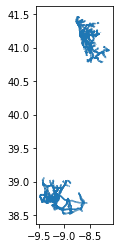

In [53]:
raw_data.plot()

## Exploration

In [54]:
stats_gen =raw_data.drop(columns=['geometry','Link_ID']).describe()
stats_gen

,Daily_Aver,Average_Ve,Median_of_,First_Quar,Third_Quar,Func_Class,Speed_Cat
count,34678.000000,34678.000000,34678.000000,34678.000000,34678.000000,34678.000000,34678.000000
mean,3340.417942,56.816834,56.463409,43.822041,68.091844,2.684613,4.904781
std,2725.873982,51.983670,26.240876,24.442204,30.985191,0.538658,1.520568
min,14.435864,-401.703724,1.000000,-392.500000,1.000000,1.000000,2.000000
25%,1903.398108,38.315321,38.250000,26.000000,48.000000,2.000000,4.000000
50%,2644.529317,49.966126,50.000000,38.875000,60.333333,3.000000,6.000000
75%,3897.886608,69.511585,71.000000,56.000000,85.000000,3.000000,6.000000
max,49309.806935,6357.022296,1326.250000,143.000000,2605.000000,3.000000,7.000000


In [55]:
# there are some outliers in the data

In [56]:
raw_data

,Link_ID,Daily_Aver,Average_Ve,Median_of_,First_Quar,Third_Quar,Func_Class,Speed_Cat,geometry
0,80216819,6224.778569,45.208716,44.464286,28.000000,59.00,2,6,"LINESTRING (-9.16402 38.77030, -9.16389 38.770..."
1,80216858,2236.054168,79.563308,82.750000,71.750000,93.25,2,4,"LINESTRING (-9.16645 38.74274, -9.16638 38.742..."
2,80216859,2138.725039,65.955069,67.333333,61.000000,75.00,3,6,"LINESTRING (-9.16645 38.74274, -9.16637 38.742..."
3,80216860,2201.335041,47.533911,44.000000,26.900000,74.00,3,6,"LINESTRING (-9.16588 38.74370, -9.16568 38.744..."
4,80216867,2102.610278,51.375291,53.250000,45.333333,59.00,3,6,"LINESTRING (-9.16472 38.74478, -9.16487 38.744..."
...,...,...,...,...,...,...,...,...,...
34673,1223266734,2301.997364,44.392857,43.500000,37.000000,50.00,3,4,"LINESTRING (-8.53497 41.27065, -8.53505 41.270..."
34674,1223277122,1655.507135,106.848684,109.500000,88.000000,124.00,2,3,"LINESTRING (-8.46988 41.23316, -8.47069 41.23324)"
34675,1223277123,1665.608140,108.863821,114.250000,90.000000,124.50,2,3,"LINESTRING (-8.47069 41.23324, -8.47099 41.233..."
34676,1223277124,2580.645483,104.774517,108.375000,94.200000,122.00,2,3,"LINESTRING (-8.47747 41.23388, -8.47775 41.233..."


In [57]:
data_outlier = raw_data.drop(columns=['geometry','Link_ID','Func_Class','Speed_Cat'])

In [58]:
data_outlier.isna().sum()

Daily_Aver    0
Average_Ve    0
Median_of_    0
First_Quar    0
Third_Quar    0
dtype: int64

In [59]:
data_outlier

,Daily_Aver,Average_Ve,Median_of_,First_Quar,Third_Quar
0,6224.778569,45.208716,44.464286,28.000000,59.00
1,2236.054168,79.563308,82.750000,71.750000,93.25
2,2138.725039,65.955069,67.333333,61.000000,75.00
3,2201.335041,47.533911,44.000000,26.900000,74.00
4,2102.610278,51.375291,53.250000,45.333333,59.00
...,...,...,...,...,...
34673,2301.997364,44.392857,43.500000,37.000000,50.00
34674,1655.507135,106.848684,109.500000,88.000000,124.00
34675,1665.608140,108.863821,114.250000,90.000000,124.50
34676,2580.645483,104.774517,108.375000,94.200000,122.00


In [60]:
data_outliers_stats = data_outlier[(data_outlier > 0) & (data_outlier < 20000)]
data_outliers_stats.describe()

<ipython-input-60-3bd58e87a8ae>:1: DeprecationWarning: '&' operator will be deprecated. Use the 'intersection' method instead.
  data_outliers_stats = data_outlier[(data_outlier > 0) & (data_outlier < 20000)]


AttributeError: No geometry data set yet (expected in column 'geometry'.)

## Exploration

1 These roads are meant for high volume, maximum speed traffic between and through major metropolitan areas. There are very few, if any, speed changes. Access to this road is usually controlled.

2 These roads are used to channel traffic to Main Roads (FRC1) for travel between and through cities in the shortest amount of time. There are very few, if any speed changes.

3 These roads interconnect First Class Roads (FRC2) and provide a high volume of traffic movement at a lower level of mobility than First Class Roads (FRC2).

In [61]:
raw_data['Func_Class'].value_counts()

3    25028
2     8363
1     1287
Name: Func_Class, dtype: int64

In [62]:
raw_data['Speed_Cat'].value_counts()

6    20312
4     5273
2     5123
3     1843
5     1770
7      357
Name: Speed_Cat, dtype: int64

In [63]:
#max_speed of road segments
max_speed_dict = {2:130,3:100,4:90,5:70,6:50,7:30}

In [64]:
raw_data['max_speed'] = raw_data['Speed_Cat'].map(max_speed_dict)

In [65]:
raw_data

,Link_ID,Daily_Aver,Average_Ve,Median_of_,First_Quar,Third_Quar,Func_Class,Speed_Cat,geometry,max_speed
0,80216819,6224.778569,45.208716,44.464286,28.000000,59.00,2,6,"LINESTRING (-9.16402 38.77030, -9.16389 38.770...",50
1,80216858,2236.054168,79.563308,82.750000,71.750000,93.25,2,4,"LINESTRING (-9.16645 38.74274, -9.16638 38.742...",90
2,80216859,2138.725039,65.955069,67.333333,61.000000,75.00,3,6,"LINESTRING (-9.16645 38.74274, -9.16637 38.742...",50
3,80216860,2201.335041,47.533911,44.000000,26.900000,74.00,3,6,"LINESTRING (-9.16588 38.74370, -9.16568 38.744...",50
4,80216867,2102.610278,51.375291,53.250000,45.333333,59.00,3,6,"LINESTRING (-9.16472 38.74478, -9.16487 38.744...",50
...,...,...,...,...,...,...,...,...,...,...
34673,1223266734,2301.997364,44.392857,43.500000,37.000000,50.00,3,4,"LINESTRING (-8.53497 41.27065, -8.53505 41.270...",90
34674,1223277122,1655.507135,106.848684,109.500000,88.000000,124.00,2,3,"LINESTRING (-8.46988 41.23316, -8.47069 41.23324)",100
34675,1223277123,1665.608140,108.863821,114.250000,90.000000,124.50,2,3,"LINESTRING (-8.47069 41.23324, -8.47099 41.233...",100
34676,1223277124,2580.645483,104.774517,108.375000,94.200000,122.00,2,3,"LINESTRING (-8.47747 41.23388, -8.47775 41.233...",100


In [66]:
raw_data['speed_diff_mean'] = raw_data['max_speed'] - raw_data['Average_Ve']

In [67]:
raw_data['speed_diff_median'] = raw_data['max_speed'] - raw_data['Median_of_']

## data_lis & data_porto

In [68]:
import shapely

In [69]:
circle_lisbon = shapely.geometry.Point(-9.142 , 38.72).buffer(1)
data_lis  = raw_data[raw_data.geometry.within(circle_lisbon)]

In [70]:
circle_porto = shapely.geometry.Point(-8.62 , 41.15).buffer(1)
data_porto  = raw_data[raw_data.geometry.within(circle_porto)]

In [71]:
stats_lis = data_lis.drop(columns=['geometry','Link_ID']).describe()
stats_lis

,Daily_Aver,Average_Ve,Median_of_,First_Quar,Third_Quar,Func_Class,Speed_Cat,max_speed,speed_diff_mean,speed_diff_median
count,17688.000000,17688.000000,17688.000000,17688.000000,17688.000000,17688.000000,17688.000000,17688.000000,17688.000000,17688.000000
mean,2779.322748,56.840437,56.442624,43.118350,68.728670,2.643204,4.868668,72.124039,15.283602,15.681415
std,1722.118210,42.472553,24.760029,24.062748,26.206164,0.548917,1.514520,29.744107,39.788718,18.484456
min,31.317245,-223.237783,3.000000,0.500000,4.000000,1.000000,2.000000,30.000000,-3933.178775,-75.000000
25%,1800.848920,38.207960,38.000000,25.000000,48.500000,2.000000,4.000000,50.000000,3.669081,3.750000
50%,2349.216928,50.553252,51.000000,38.000000,62.845833,3.000000,6.000000,50.000000,15.343575,15.000000
75%,3170.858817,70.109318,72.000000,57.000000,86.000000,3.000000,6.000000,90.000000,26.655083,26.135417
max,26714.250016,3983.178775,143.250000,132.000000,164.000000,3.000000,7.000000,130.000000,313.237783,107.000000


In [72]:
stats_porto = data_porto.drop(columns=['geometry', 'Link_ID']).describe()
stats_porto

,Daily_Aver,Average_Ve,Median_of_,First_Quar,Third_Quar,Func_Class,Speed_Cat,max_speed,speed_diff_mean,speed_diff_median
count,16990.000000,16990.000000,16990.000000,16990.000000,16990.000000,16990.000000,16990.000000,16990.000000,16990.000000,16990.000000
mean,3924.564605,56.792262,56.485047,44.554642,67.428856,2.727722,4.942378,70.590936,13.798674,14.105889
std,3377.858716,60.313800,27.699289,24.810601,35.267906,0.524318,1.525975,29.884967,58.420093,21.938006
min,14.435864,-401.703724,1.000000,-392.500000,1.000000,1.000000,2.000000,30.000000,-6307.022296,-1276.250000
25%,2085.272855,38.484767,38.666667,27.000000,47.500000,3.000000,4.000000,50.000000,2.616123,2.333333
50%,3161.771490,49.410245,50.000000,39.666667,58.750000,3.000000,6.000000,50.000000,13.258134,13.000000
75%,4572.260998,68.564778,69.000000,55.132143,84.062500,3.000000,6.000000,90.000000,25.655530,26.000000
max,49309.806935,6357.022296,1326.250000,143.000000,2605.000000,3.000000,7.000000,130.000000,531.703724,98.000000


In [73]:
stats_lis.iloc[1,0], stats_porto.iloc[1,0], stats_gen.iloc[1,0]

(2779.322748372343, 3924.5646046148913, 3340.4179423731766)

## Plotting Road Segments with Folium

### Lisbon Road Segments

In [74]:
data_lis.shape

(17688, 12)

In [75]:
import folium

ms = folium.Map(location=[38.73, -9.154], zoom_start=11)
ms

In [76]:
folium.Choropleth(geo_data=data_lis,
                  name="AGEB Rural",
                  fill_color="#FFA500",
                  highlight=True).add_to(ms)

In [77]:
ms

### Porto road segments

In [78]:
data_porto.shape

(16990, 12)

In [79]:
ms = folium.Map(location=[41.15,-8.62], zoom_start=11)
ms

In [80]:
folium.Choropleth(geo_data=data_porto,
                  name="AGEB Rural",
                  fill_color="#FFA500",
                  highlight=True).add_to(ms)

ms